In [1]:
import sys
sys.path.append('/Users/yuch8913/miniforge3/envs/er3t_env/lib/python3.8/site-packages')
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib
from glob import glob
import numpy as np
from sys import exit as ext
import copy
from bisect import bisect_left
from oco_post_class_ywc import *
from matplotlib import cm
from scipy.interpolate import interpn
from scipy import stats
import geopy.distance
import xarray as xr
import seaborn as sns
from tool_code import *
%matplotlib inline
import os, pickle 
#"""

from matplotlib import font_manager

font_path = '/System/Library/Fonts/Supplemental/Arial.ttf'  # Your font path goes here
font_manager.fontManager.addfont(font_path)
prop = font_manager.FontProperties(fname=font_path)

plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = prop.get_name()
#"""

import warnings
warnings.filterwarnings("ignore")

In [2]:
oco_l1b_file = '../simulation/data/oco/oco2_L1bScND_22850a_181018_B10003r_200409205805.h5'
l1b = h5py.File(oco_l1b_file, 'r')
oco_l2_file = '../simulation/data/oco/oco2_L2StdND_22850a_181018_B10004r_200520201845.h5'
l2 = h5py.File(oco_l2_file, 'r')
oco_met_file = '../simulation/data/oco/oco2_L2MetND_22850a_181018_B10003r_200409205805.h5'
met = h5py.File(oco_met_file, 'r')

In [3]:
dis = l1b["InstrumentHeader/dispersion_coef_samp"][...]
lam = np.zeros([8,1016,3]) # Those are the wavelengths in the radiance file
wli = np.arange(1,1017,dtype=float)
for i in range(8): 
    for j in range(3):
        for k in range(5):
            lam[i,:,j]=lam[i,:,j] + dis[j,i,k]*wli**k  

print(lam.shape)

(8, 1016, 3)


In [5]:
ilsx = l1b["InstrumentHeader/ils_delta_lambda"][...]

ilsy = l1b["InstrumentHeader/ils_relative_response"][...]

In [4]:
def solar(file):
    """
    # to solve: kurudz.dat and val?
    """
    h = 6.62607004e-34
    c = 299792458.
    hc = h*c


    # the setting is specific to the assigned solar.txt filw
    data = pd.read_csv(file, skiprows=6, header=None, sep='     ', engine='python')
    data['Wavenumber'] = data[0].astype(float)
    data['Irradiance'] = data[1].astype(float)
    wn = np.array(data['Wavenumber'])
    ss = np.array(data['Irradiance']) # photons/sec/m2/micron
    sx = 1e-1*hc*wn*ss # W/m2/nm
    wl = 1.0e4/wn # convert wavenumer to wavelength in micron


    return wl[::-1], sx[::-1]

s_wl, s_fx = solar('solar.txt')

In [6]:
s_wl.shape

(680003,)

In [6]:
def add_solar(s_wl, s_fx, lam, ilsx, ilsy, fp=0):

    wl = s_wl
    fx = s_fx
    wl=np.array(wl)
    fx=np.array(fx)
    idx=np.argsort(wl)
    solar_wl=np.array(wl[idx])
    solar_irradiance=np.array(fx[idx])

    ch1 = np.interp(lam[fp,:, 0],solar_wl,solar_irradiance)
    ch2 = np.interp(lam[fp,:, 1],solar_wl,solar_irradiance)        
    ch3 = np.interp(lam[fp,:, 2],solar_wl,solar_irradiance)        

    ox=np.zeros((8, 1016))
    wc=np.zeros((8, 1016))
    sc=np.zeros((8, 1016))
    for fp in range(8):
        for i in range(1016):
            temp=np.interp(lam[fp,:, 0], ilsx[0,fp,i,:]+lam[fp, i, 0], ilsy[0,fp,i,:])
            temp=temp/np.sum(temp)
            ox[fp, i]=np.sum(ch1*temp)
            temp=np.interp(lam[fp,:, 1], ilsx[1,fp,i,:]+lam[fp, i, 1], ilsy[1,fp,i,:])
            temp=temp/np.sum(temp)
            wc[fp, i]=np.sum(ch2*temp)
            temp=np.interp(lam[fp,:, 2], ilsx[2,fp,i,:]+lam[fp, i, 2], ilsy[2,fp,i,:])
            temp=temp/np.sum(temp)
            sc[fp, i]=np.sum(ch3*temp)

    """nz =1#self.rad1.shape[0]
    nfp=1#self.rad1.shape[1]
    #mu = np.stack([self.mu]*1016,axis=2)
    oxs= np.stack([ox]*nfp,axis=0)
    oxs= np.stack([oxs]*nz,axis=0)
    wcs= np.stack([wc]*nfp,axis=0)
    wcs= np.stack([wcs]*nz,axis=0)
    scs= np.stack([sc]*nfp,axis=0)
    scs= np.stack([scs]*nz,axis=0)
    
    return oxs, wcs, scs"""
    
    return ox, wc, sc

oxs, wcs, scs = add_solar(s_wl, s_fx, lam, ilsx, ilsy)
oxs.shape

(8, 1016)

In [126]:
l2.keys()

<KeysViewHDF5 ['AerosolResults', 'AlbedoResults', 'BRDFResults', 'Dimensions', 'DispersionResults', 'FootprintMeteorology', 'L1bScSoundingReference', 'L1bScSpectralParameters', 'Metadata', 'PreprocessingResults', 'RetrievalGeometry', 'RetrievalHeader', 'RetrievalResults', 'Shapes', 'SpectralParameters']>

In [127]:
l2['AlbedoResults'].keys()

<KeysViewHDF5 ['albedo_apriori_o2_fph', 'albedo_apriori_strong_co2_fph', 'albedo_apriori_weak_co2_fph', 'albedo_o2_fph', 'albedo_slope_apriori_o2', 'albedo_slope_apriori_strong_co2', 'albedo_slope_apriori_weak_co2', 'albedo_slope_o2', 'albedo_slope_strong_co2', 'albedo_slope_uncert_o2', 'albedo_slope_uncert_strong_co2', 'albedo_slope_uncert_weak_co2', 'albedo_slope_weak_co2', 'albedo_strong_co2_fph', 'albedo_uncert_o2_fph', 'albedo_uncert_strong_co2_fph', 'albedo_uncert_weak_co2_fph', 'albedo_weak_co2_fph']>

In [8]:
met.keys()

<KeysViewHDF5 ['Aerosol', 'Dimensions', 'FootprintGeometry', 'FootprintMeteorology', 'Metadata', 'Meteorology', 'MeteorologyDiagnostics', 'Shapes', 'SoundingGeometry']>

In [9]:
l1b['SoundingMeasurements'].keys()

<KeysViewHDF5 ['rad_continuum_o2', 'rad_continuum_strong_co2', 'rad_continuum_weak_co2', 'radiance_o2', 'radiance_strong_co2', 'radiance_weak_co2', 'snr_o2_l1b', 'snr_strong_co2_l1b', 'snr_weak_co2_l1b']>

In [10]:
l1b['InstrumentHeader'].keys()

<KeysViewHDF5 ['bad_sample_list', 'dispersion_coef_samp', 'granule_degradation_factor', 'ils_delta_lambda', 'ils_relative_response', 'measureable_signal_max_observed', 'snr_coef']>

In [11]:
l1b['FootprintGeometry'].keys()


<KeysViewHDF5 ['footprint_altitude', 'footprint_altitude_uncert', 'footprint_aspect', 'footprint_azimuth', 'footprint_land_fraction', 'footprint_latitude', 'footprint_latitude_geoid', 'footprint_longitude', 'footprint_longitude_geoid', 'footprint_los_surface_bidirectional_angle', 'footprint_o2_qual_flag', 'footprint_plane_fit_quality', 'footprint_polarization_angle', 'footprint_slope', 'footprint_solar_azimuth', 'footprint_solar_surface_bidirectional_angle', 'footprint_solar_zenith', 'footprint_stokes_coefficients', 'footprint_strong_co2_qual_flag', 'footprint_surface_roughness', 'footprint_time_string', 'footprint_time_tai93', 'footprint_vertex_altitude', 'footprint_vertex_latitude', 'footprint_vertex_longitude', 'footprint_weak_co2_qual_flag', 'footprint_zenith']>

In [12]:
l1b['FrameConfiguration'].keys()

<KeysViewHDF5 ['color_slice_position_o2', 'color_slice_position_strong_co2', 'color_slice_position_weak_co2', 'footprint_spatial_end_position', 'footprint_spatial_start_position', 'initial_unused_pixels']>

In [13]:
l1b['FrameGeometry'].keys()

<KeysViewHDF5 ['ground_track', 'pitch', 'relative_velocity', 'roll', 'spacecraft_alt', 'spacecraft_lat', 'spacecraft_lon', 'spacecraft_position', 'spacecraft_velocity', 'yaw']>

In [14]:
l1b['SliceMeasurements'].keys()

<KeysViewHDF5 ['radiance_slice_o2', 'radiance_slice_strong_co2', 'radiance_slice_weak_co2']>

In [15]:
l1b['SoundingGeometry'].keys()

<KeysViewHDF5 ['sounding_altitude', 'sounding_altitude_uncert', 'sounding_aspect', 'sounding_azimuth', 'sounding_center_offset_o2_weak_co2', 'sounding_center_offset_strong_co2_o2', 'sounding_center_offset_weak_co2_strong_co2', 'sounding_id', 'sounding_land_fraction', 'sounding_land_water_indicator', 'sounding_latitude', 'sounding_latitude_geoid', 'sounding_longitude', 'sounding_longitude_geoid', 'sounding_los_surface_bidirectional_angle', 'sounding_operation_mode', 'sounding_overlap', 'sounding_overlap_o2_weak_co2', 'sounding_overlap_strong_co2_o2', 'sounding_overlap_weak_co2_strong_co2', 'sounding_plane_fit_quality', 'sounding_polarization_angle', 'sounding_qual_flag', 'sounding_relative_velocity', 'sounding_slant_path_diff_o2_weak_co2', 'sounding_slant_path_diff_strong_co2_o2', 'sounding_slant_path_diff_weak_co2_strong_co2', 'sounding_slope', 'sounding_solar_azimuth', 'sounding_solar_distance', 'sounding_solar_relative_velocity', 'sounding_solar_surface_bidirectional_angle', 'soundin

In [9]:
wl = lam[:,:,0]

In [17]:
wl.shape

(8, 1016)

In [18]:
1e4/wl

array([[13198.46262324, 13198.15805065, 13197.85358745, ...,
        12942.76773808, 12942.56234809, 12942.35703657],
       [13198.53469225, 13198.23018647, 13197.92578939, ...,
        12942.619139  , 12942.41266703, 12942.20626946],
       [13198.62527174, 13198.3205289 , 13198.01589718, ...,
        12943.5925892 , 12943.39047441, 12943.18845036],
       ...,
       [13198.83255796, 13198.52798568, 13198.22352333, ...,
        12943.4224867 , 12943.21835468, 12943.01430575],
       [13198.90063253, 13198.59612139, 13198.29171993, ...,
        12943.68223652, 12943.47887967, 12943.27560837],
       [13198.97793968, 13198.67340745, 13198.36898484, ...,
        12943.3947244 , 12943.18966124, 12942.98467765]])

In [7]:
o2a_rad = l1b['SoundingMeasurements']['radiance_o2'][...]
wco2_rad = l1b['SoundingMeasurements']['radiance_weak_co2'][...]
sco2_rad = l1b['SoundingMeasurements']['radiance_strong_co2'][...]

o2a_rad.shape

(8334, 8, 1016)

In [8]:
o2a_qf = l1b['FootprintGeometry']['footprint_o2_qual_flag'][...]
o2a_qf.shape

(8334, 8)

In [9]:
c = 299792458.0
h = 6.62607015e-34
E = h*c/(wli*1e-6)

In [13]:
wli.shape

(1016,)

In [23]:
plt.plot(wli[0,:], o2a_rad[0,0,:]*E)

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [10]:
o2a_con = l1b['SoundingMeasurements']['rad_continuum_o2'][...]
o2a_sza = l1b['SoundingGeometry/sounding_solar_zenith'][...]
o2a_vza = l1b['SoundingGeometry/sounding_zenith'][...]
o2a_mu = np.cos(o2a_sza/180*np.pi)

o2a_mu_r = o2a_mu.repeat(1016).reshape((o2a_mu.shape[0], o2a_mu.shape[1], 1016))
o2a_mu_r.shape#[0,0,:]

o2a_con.shape

(8334, 8)

In [11]:
from pyhdf.SD import SD, SDC
from er3t.util import upscale_modis_lonlat
mod_l2_file = '../simulation/data/modis/20181018/MYD06_L2.A2018291.0935.061.2018291213358.hdf'

f     = SD(mod_l2_file, SDC.READ)
lat0       = f.select('Latitude')
lon0       = f.select('Longitude')
cot0  = f.select('Cloud_Optical_Thickness')
cth0 = f.select('cloud_top_height_1km')
lon, lat  = upscale_modis_lonlat(lon0[:], lat0[:], scale=5, extra_grid=True)

In [137]:
from pyhdf.SD import SD, SDC
from er3t.util import upscale_modis_lonlat
mod_35_file = '../simulation/data/modis/20181018/MYD35_L2.A2018291.0935.061.2018291195645.hdf'

f     = SD(mod_35_file, SDC.READ)
lat0       = f.select('Latitude')
lon0       = f.select('Longitude')
cld_mask0  = f.select('Cloud_Mask')

lon, lat  = upscale_modis_lonlat(lon0[:], lat0[:], scale=5, extra_grid=True)

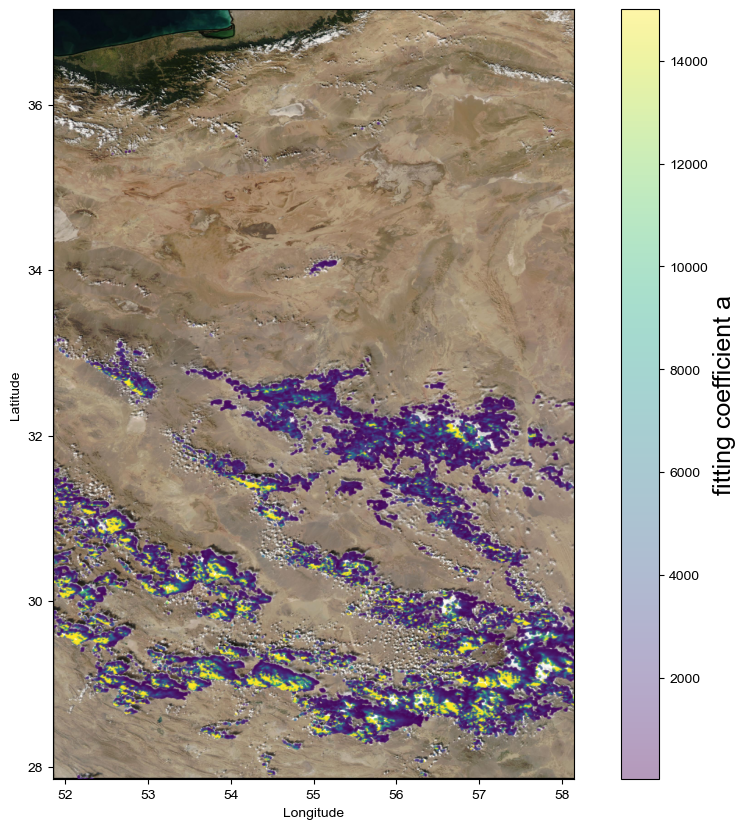

In [15]:
png       = ['../simulation/data/20181018_central_asia_2_470cloud_test0320_20181018/aqua_rgb_2018-10-18_51.85-58.15-27.85-37.15.png',
             [51.85,58.15,27.85,37.15]]
img = png[0]
wesn= png[1]


f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = cot0[:]>=0
c = frame.scatter(lon[mask], lat[mask], s=1,
                  marker='o', 
                  #c=cld_mask0_bin_cloud_int,
                  c=cot0[:][mask],
                  alpha=0.4)

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

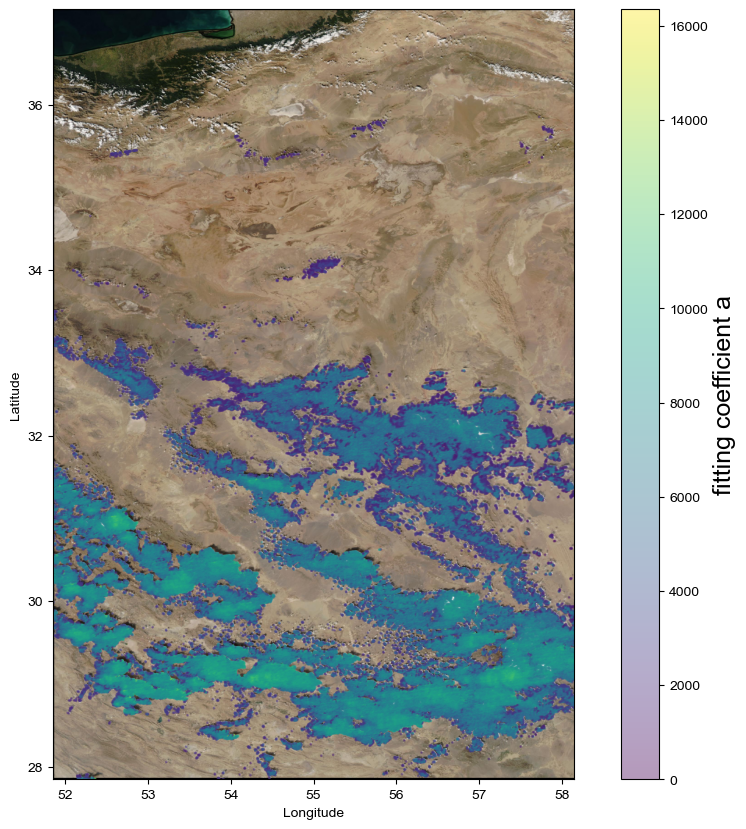

In [12]:
png       = ['../simulation/data/20181018_central_asia_2_470cloud_test0320_20181018/aqua_rgb_2018-10-18_51.85-58.15-27.85-37.15.png',
             [51.85,58.15,27.85,37.15]]
img = png[0]
wesn= png[1]


f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = cth0[:]>=0
c = frame.scatter(lon[mask], lat[mask], s=1,
                  marker='o', 
                  #c=cld_mask0_bin_cloud_int,
                  c=cth0[:][mask],
                  alpha=0.4)

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [13]:
def cld_dist_calc(lon_oco, lat_oco, cth, cth_lon, cth_lat):

    if os.path.isfile('modis_cth_oco_cld_distance.npy'):
        cloud_dist = np.load('modis_cth_oco_cld_distance.npy')
    else:

        lon_cld, lat_cld = cth_lon, cth_lat
        cld_list = cth>0
        cld_X, cld_Y = np.where(cld_list==1)[0], np.where(cld_list==1)[1]
        cld_position = []
        cld_position_lonlat = []
        for i in range(len(cld_X)):
            cld_position.append(np.array([cld_X[i], cld_Y[i]]))
            cld_position_lonlat.append(np.array([cth_lon[cld_X[i], cld_Y[i]], cth_lat[cld_X[i], cld_Y[i]]]))
        cld_position = np.array(cld_position)
        cld_position_lonlat = np.array(cld_position_lonlat)

        cloud_dist = np.zeros_like(lon_oco)
        for j in range(cloud_dist.shape[1]):
            for i in range(cloud_dist.shape[0]):
    #             if cld_list[i, j] == 1:
    #                 cloud_dist[i, j] = 0
    #             else:
                tmp_lon = lon_oco[i, j]
                tmp_lat = lat_oco[i, j]
                if np.logical_and(np.logical_and(tmp_lon >= np.min(cth_lon), tmp_lon <= np.max(cth_lon)), 
                                  np.logical_and(tmp_lat >= np.min(cth_lat), tmp_lat <= np.max(cth_lat))):
                    min_ind = np.argmin(np.sum(np.square(cld_position_lonlat-np.array([tmp_lon, tmp_lat])), axis=1))
                    #print(min_ind)
                    #print(cld_position[min_ind])
                    cld_x, cld_y = cld_position_lonlat[min_ind][0], cld_position_lonlat[min_ind][1]

                    dist = geopy.distance.distance((tmp_lat, tmp_lon), (cld_y, cld_x)).km
                    #print(dist)
                    cloud_dist[i, j] = dist
                else:
                    cloud_dist[i, j] = np.nan

        np.save('modis_cth_oco_cld_distance.npy', cloud_dist)
    
    return cloud_dist


In [14]:
snd_id = l1b['SoundingGeometry']['sounding_id'][...]
snd_lon = l1b['SoundingGeometry']['sounding_longitude'][...]
snd_lat = l1b['SoundingGeometry']['sounding_latitude'][...]
snd_lon.shape

(8334, 8)

In [15]:
cloud_dist = cld_dist_calc(snd_lon, snd_lat, cth0[:], lon, lat)

(array([3390.,  515.,  421.,  316.,  326.,  455.,  291.,  197.,  188.,
         187.,  177.,  262.,  250.,  186.,  124.,   77.,   74.,  104.,
          93.,   74.,   38.,   46.,   50.,   38.,   36.,   36.,   26.,
          16.,   16.,   16.,   16.,   16.,   16.,   16.,   16.,   16.,
          16.,   16.,   16.,   16.,   16.,   16.,   16.,   16.,   16.,
          16.,   16.,   16.,   16.,   16.,   17.]),
 array([2.52045281e-02, 4.57218981e+00, 9.11917496e+00, 1.36661596e+01,
        1.82131443e+01, 2.27601299e+01, 2.73071156e+01, 3.18541012e+01,
        3.64010849e+01, 4.09480705e+01, 4.54950562e+01, 5.00420418e+01,
        5.45890274e+01, 5.91360130e+01, 6.36829987e+01, 6.82299805e+01,
        7.27769699e+01, 7.73239517e+01, 8.18709412e+01, 8.64179230e+01,
        9.09649048e+01, 9.55118942e+01, 1.00058876e+02, 1.04605865e+02,
        1.09152847e+02, 1.13699837e+02, 1.18246819e+02, 1.22793800e+02,
        1.27340790e+02, 1.31887772e+02, 1.36434753e+02, 1.40981750e+02,
        1.4552873

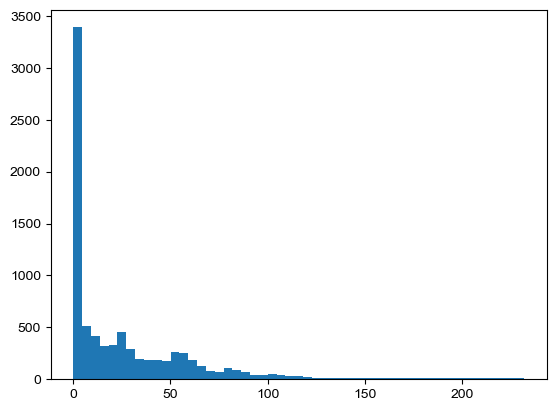

In [20]:
plt.hist(cloud_dist.flatten(), bins=51)

In [174]:
def convert_photon_unit(data_photon, wavelength, scale_factor=1):
    # original: 
    # Ph sec^{-1} m^{-2} sr^{-1} um^{-1}
    
    c = 299792458.0
    h = 6.62607015e-34
    wavelength = wavelength * 1e-9
    data = data_photon/1000.0*c*h/wavelength*scale_factor

    return data

o2a_rad_convert = convert_photon_unit(o2a_rad, lam[:, :, 0]*1e3)
o2a_ref_convert = o2a_rad_convert*np.pi/(oxs*o2a_mu_r)

wco2_rad_convert = convert_photon_unit(wco2_rad, lam[:, :, 1]*1e3)
wco2_ref_convert = wco2_rad_convert*np.pi/(wcs*o2a_mu_r)

sco2_rad_convert = convert_photon_unit(sco2_rad, lam[:, :, 2]*1e3)
sco2_ref_convert = sco2_rad_convert*np.pi/(scs*o2a_mu_r)

ref_min, ref_max = 92, 95
o2a_ref_con_convert = np.percentile(o2a_ref_convert, np.linspace(ref_min, ref_max, 11), axis=2).mean(axis=0)
wco2_ref_con_convert = np.percentile(wco2_ref_convert, np.linspace(ref_min, ref_max, 11), axis=2).mean(axis=0)
sco2_ref_con_convert = np.percentile(sco2_ref_convert, np.linspace(ref_min, ref_max, 11), axis=2).mean(axis=0)

In [175]:
o2a_ref_con_expand = np.repeat(o2a_ref_con_convert, 1016).reshape(o2a_ref_con_convert.shape[0], o2a_ref_con_convert.shape[1], 1016)
wco2_ref_con_expand = np.repeat(wco2_ref_con_convert, 1016).reshape(wco2_ref_con_convert.shape[0], wco2_ref_con_convert.shape[1], 1016)
sco2_ref_con_expand = np.repeat(sco2_ref_con_convert, 1016).reshape(sco2_ref_con_convert.shape[0], sco2_ref_con_convert.shape[1], 1016)



In [176]:
o2a_absorbed = (o2a_ref_con_expand-o2a_ref_convert)
o2a_abs_3d = -np.log10(1-o2a_absorbed)

wco2_absorbed = (wco2_ref_con_expand-wco2_ref_convert)
wco2_abs_3d = -np.log10(1-wco2_absorbed)

sco2_absorbed = (sco2_ref_con_expand-sco2_ref_convert)
sco2_abs_3d = -np.log10(1-sco2_absorbed)


(array([1.0000000e+00, 0.0000000e+00, 1.0000000e+00, 0.0000000e+00,
        1.0000000e+00, 1.0000000e+00, 1.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00, 1.0000000e+00, 1.0000000e+00,
        3.0000000e+00, 3.0000000e+00, 3.0000000e+00, 2.0000000e+00,
        6.0000000e+00, 6.0000000e+00, 1.4000000e+01, 2.0000000e+01,
        1.4800000e+02, 1.9866000e+04, 5.3218000e+04, 2.6762000e+05,
        3.6416220e+07, 1.3534397e+07, 4.6169620e+06, 3.0003210e+06,
        2.0434800e+06, 1.5334520e+06, 1.2570110e+06, 1.0714570e+06,
        9.5888300e+05, 8.1182700e+05, 6.1116300e+05, 4.6698300e+05,
        4.0121300e+05, 4.1116100e+05, 2.1567900e+05, 3.0967000e+04,
        8.3800000e+03, 3.7170000e+03, 1.5790000e+03, 1.0510000e+03,
        4.2600000e+02, 5.3400000e+02, 3.2100000e+02, 3.3700000e+02,
        1.4800000e+02, 7.1000000e+01, 9.6000000e+01]),
 array([-0.4738007 , -0.45426709, -0.43473349, -0.41519989, -0.39566628,
        -0.37613268, -0.35659908, -0.33706547, -0.317531

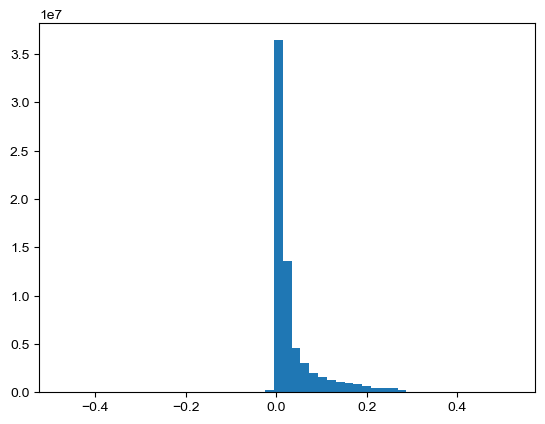

In [62]:
plt.hist(abs_3d.flatten(), bins=51)

In [19]:
sfc_p = met["Meteorology"]["surface_pressure_met"][...]
sfc_p[sfc_p<0] = np.nan
sfc_T = met["Meteorology"]["skin_temperature_met"][...]

In [20]:
T = o2a_rad_convert*np.pi/(oxs*o2a_mu_r)
A = -np.log10(T)
tau = -np.log(T)

In [145]:
A = o2a_abs_3d
A_o2a = o2a_abs_3d
A_wco2 = wco2_abs_3d
A_sco2 = sco2_abs_3d

In [20]:
lam.shape

(8, 1016, 3)

In [134]:
T.shape

(8334, 8, 1016)

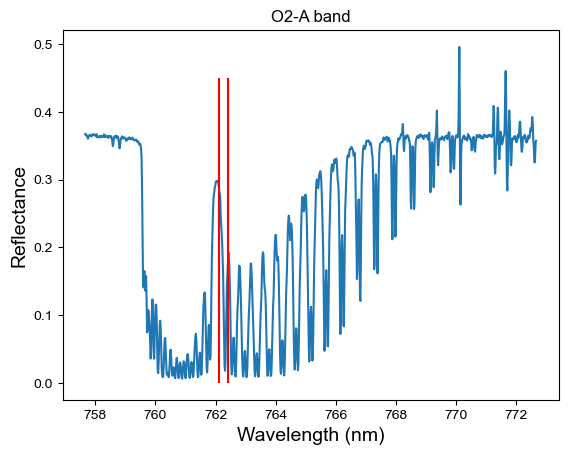

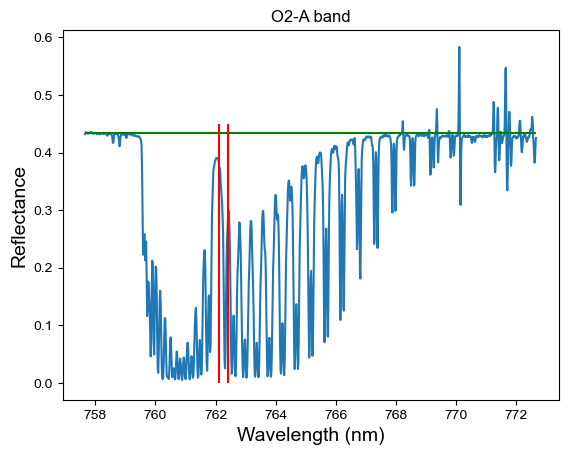

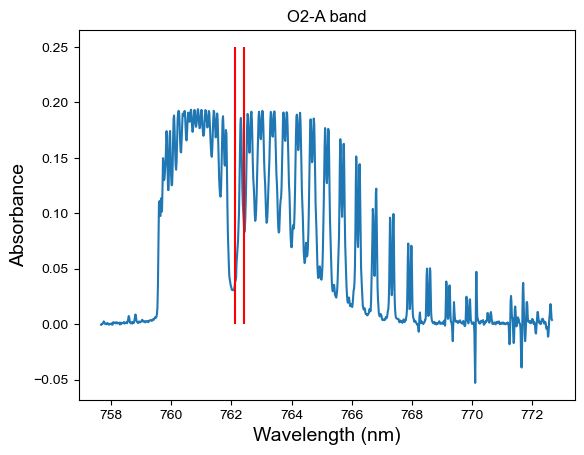

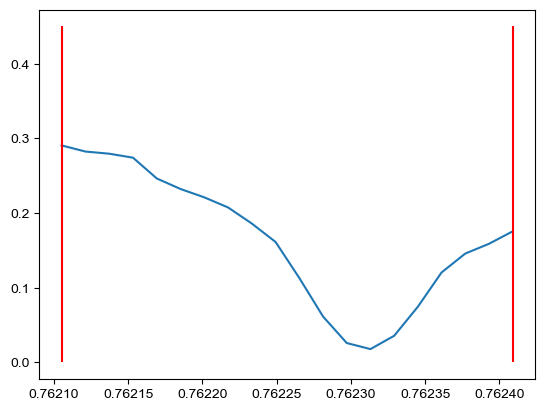

In [146]:
plt.plot(lam[0, :, 0]*1000, T[0, 0, :])
plt.vlines(lam[0, [265, 285], 0]*1000, 0, 0.45, 'r')
plt.xlabel('Wavelength (nm)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('O2-A band')
plt.show()

plt.plot(lam[0, :, 0]*1000, T[800, 0, :])
plt.hlines(o2a_ref_con_expand[800 ,0, 0], lam[0, 0, 0]*1000, lam[0, -1, 0]*1000, color='g')
plt.vlines(lam[0, [265, 285], 0]*1000, 0, 0.45, 'r')
plt.xlabel('Wavelength (nm)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('O2-A band')
plt.show()

plt.plot(lam[0, :, 0]*1000, A_o2a[0, 0, :])
plt.vlines(lam[0, [265, 285], 0]*1000, 0, 0.25, 'r')
plt.xlabel('Wavelength (nm)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('O2-A band')
plt.show()

plt.plot(lam[0, 265:285, 0], T[0, 0, 265:285])
plt.vlines(lam[0, [265, 284], 0], 0, 0.45, 'r')
plt.show()

In [ ]:
plt.plot(lam[0, :, 0]*1000, T[0, 0, :])
plt.vlines(lam[0, [265, 285], 0]*1000, 0, 0.45, 'r')
plt.xlabel('Wavelength (nm)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('O2-A band')
plt.show()

plt.plot(lam[0, 265:285, 0], T[0, 0, 265:285])
plt.vlines(lam[0, [265, 284], 0], 0, 0.45, 'r')
plt.show()

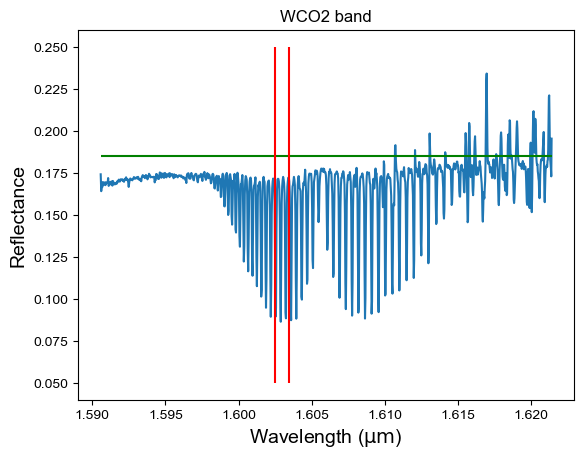

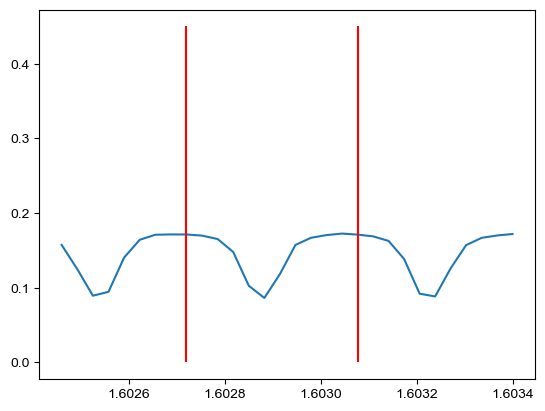

In [199]:
T_wco2 = wco2_rad_convert*np.pi/(wcs*o2a_mu_r)
plt.plot(lam[0, :, 1], T_wco2[0, 0, :])
plt.hlines(wco2_ref_con_expand[0 ,0, 0], lam[0, 0, 1], lam[0, -1, 1], color='g')
plt.vlines(lam[0, [345, 375], 1], 0.05, 0.25, 'r')
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('WCO2 band')
plt.show()

plt.plot(lam[0, 345:375, 1], T_wco2[0, 0, 345:375])
plt.vlines(lam[0, [353, 364], 1], 0, 0.45, 'r')
plt.show()

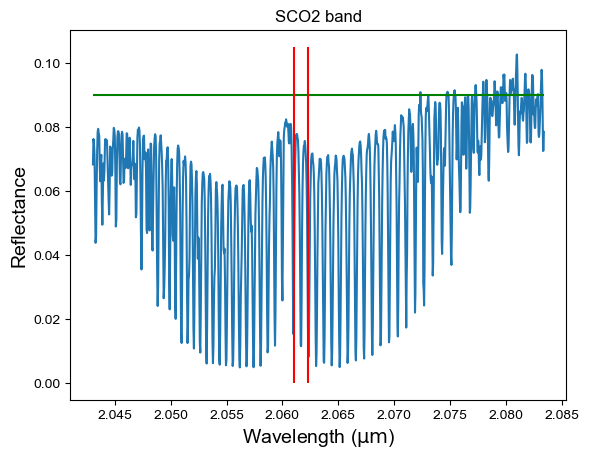

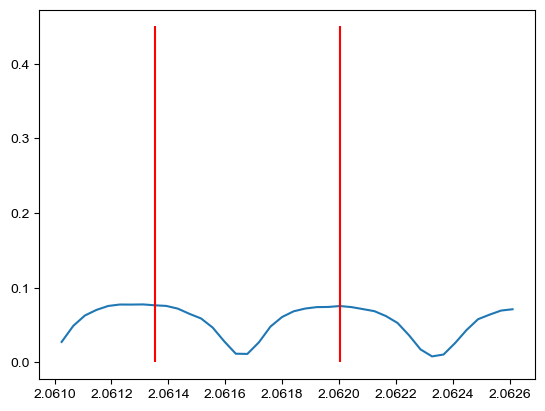

In [178]:
T_sco2 = sco2_rad_convert*np.pi/(scs*o2a_mu_r)
plt.plot(lam[0, :, 2], T_sco2[0, 0, :])
plt.hlines(sco2_ref_con_expand[0 ,0, 0], lam[0, 0, 2], lam[0, -1, 2], color='g')
plt.vlines(lam[0, [410, 440], 2], 0, 0.105, 'r')
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('SCO2 band')
plt.show()

plt.plot(lam[0, 410:450, 2], T_sco2[0, 0, 410:450])
plt.vlines(lam[0, [418, 434], 2], 0, 0.45, 'r')
plt.show()

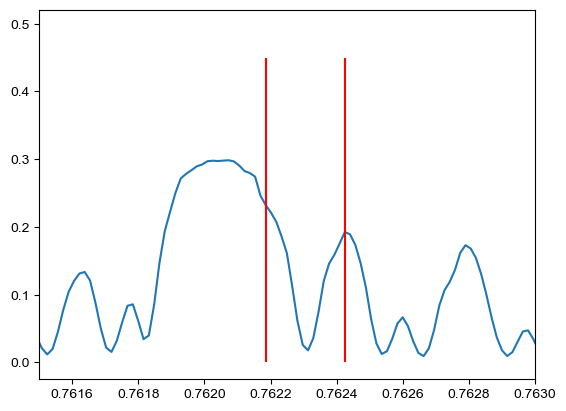

In [22]:
plt.plot(lam[0, :, 0], T[0,0,:])
plt.vlines(lam[0, [270, 285], 0], 0, 0.45, 'r')
plt.xlim(0.7615, 0.763)
plt.show()

In [314]:
lam.shape

(8, 1016, 3)

In [22]:
from scipy.special import wofz
from scipy.optimize import curve_fit

def V(x, center, alpha, gamma, adj, bkg):
    """
    Return the Voigt line shape at x with Lorentzian component HWHM gamma
    and Gaussian component HWHM alpha.

    """
    sigma = alpha / np.sqrt(2 * np.log(2))

    return (np.real(wofz(((x-center) + 1j*gamma)/sigma/np.sqrt(2))) / sigma\
                                                           /np.sqrt(2*np.pi))/adj+bkg

def V0(x, center, alpha, gamma, adj):
    """
    Return the Voigt line shape at x with Lorentzian component HWHM gamma
    and Gaussian component HWHM alpha.

    """
    sigma = alpha / np.sqrt(2 * np.log(2))

    return (np.real(wofz(((x-center) + 1j*gamma)/sigma/np.sqrt(2))) / sigma\
                                                           /np.sqrt(2*np.pi))/adj

def L(x, center, amp, fwhm, bkg):
    """
    Return the Voigt line shape at x with Lorentzian component HWHM gamma
    and Gaussian component HWHM alpha.

    """


    return amp/np.pi*((fwhm/2)/((x-center)**2+(fwhm/2)**2))+bkg


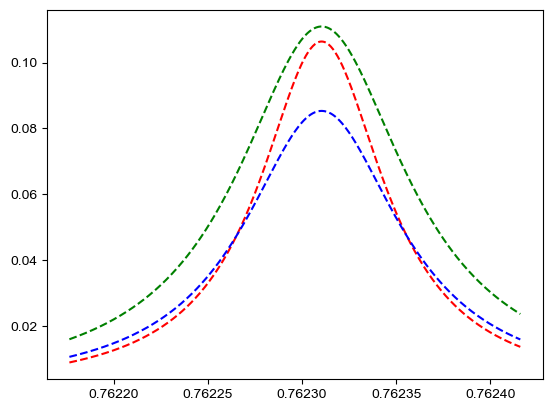

In [156]:
popt = [7.62310391e-01, 1.91353750e-05, 1.09766293e-04, 1.00006511e-07]
popt2 = [7.62310391e-01, 1.35353750e-05, 8.09766293e-05, 1.00006511e-07]
popt3 = [7.62310391e-01, 1.35353750e-05, 10.09766293e-05, 1.00006511e-07]
wvl_linspace = np.linspace(lam[fp, start, 0], lam[fp, end, 0], 401)
plt.plot(wvl_linspace, L(wvl_linspace, *popt), 'g--',)
plt.plot(wvl_linspace, L(wvl_linspace, *popt2), 'r--',)
plt.plot(wvl_linspace, L(wvl_linspace, *popt3), 'b--',)

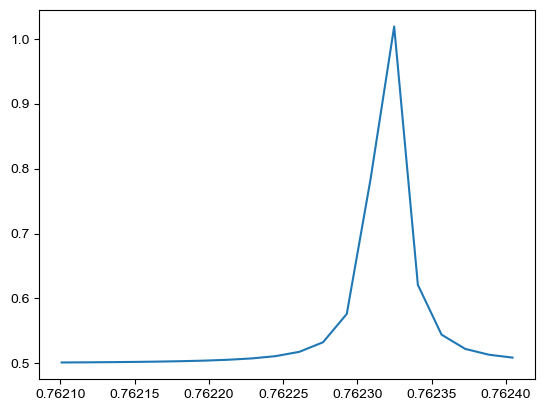

In [413]:
plt.plot(lam[fp, start:end, 0], V(lam[fp, start:end, 0], 0.76232, 1e-6, 1e-5, 50000, 0.5))

RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 1200.

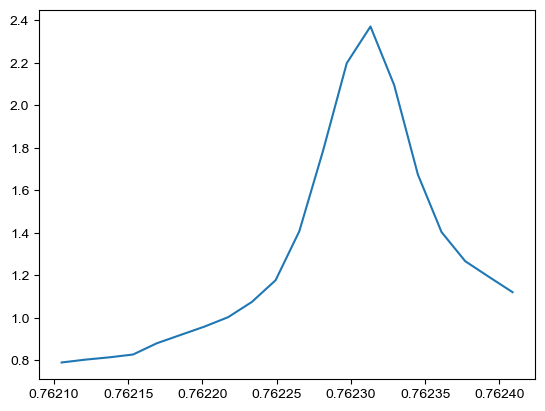

In [266]:


start, end = 265, 285
i = 8079
fp = 0
plt.plot(lam[fp, start:end, 0], A[i , fp, start:end])
popt, pcov = curve_fit(V, lam[fp, start:end, 0], A[i , fp, start:end], p0=[0.76232, 1e-5, 1e-5, 50000, 0.01])
print(popt)
plt.plot(lam[fp, start:end, 0], V(lam[fp, start:end, 0], *popt), 'g--',)

max_ind = np.argmax((A[0, 0, start:end]))
A_min = np.mean((A[0, 0, start], A[0, 0, end-1]))
A_max = A[0, 0, max_ind+start]
hm = (A_max-A_min)/2+A_min
print(hm)

from scipy import interpolate

f = interpolate.interp1d(lam[0, start:end, 0], A[0,0,start:end])
xx = np.linspace(lam[0, start, 0], lam[0, end-1, 0], 201)
yy = f(xx)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')

Text(0.5, 1.0, 'O2-A band')

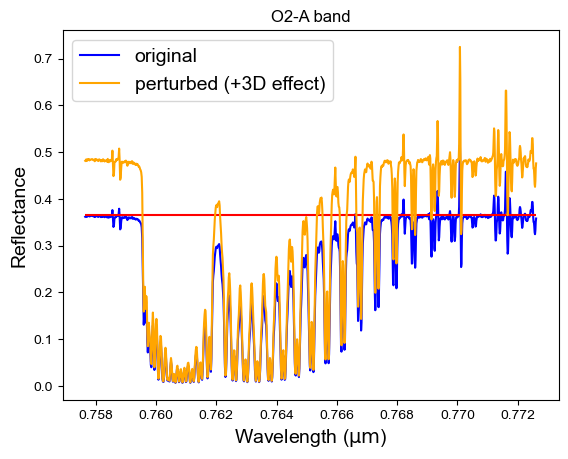

In [143]:
plt.plot(lam[fp, :, 0], o2a_ref_convert[0, fp, :], 'b', label='original')
plt.hlines(o2a_ref_con_expand[0, fp, 0], lam[fp, 0, 0], lam[fp, -1, 0], 'r' )
# plt.plot(lam[fp, :, 0], (o2a_ref_convert/(o2a_ref_convert*slope+intercept+1))[0, fp, :], 'orange')
plt.plot(lam[fp, :, 0], (o2a_ref_convert*(o2a_ref_convert*slope+intercept+1))[0, fp, :], 'orange', label='perturbed (+3D effect)')

plt.legend(fontsize=14)
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Reflectance', fontsize=14)
plt.title('O2-A band')

In [105]:
print(i, fp)
print(cloud_dist[i, fp])
print(snd_lon[i, fp], snd_lat[i, fp])

5550 2
41.037987
58.559956 21.262104


[7.62310602e-01 8.31517656e-11 5.47597359e-05 5.54962626e+04]
center: 0.10474300887475164
0.05237150443737582
0.10931118261459094 nm
[7.62310560e-01 4.68138097e-06 5.27195246e-05 7.47308721e+04]
center: 0.08034198544014513
0.04017099272007257
0.10611961523887548 nm


Text(0.5, 1.0, 'O2-A band')

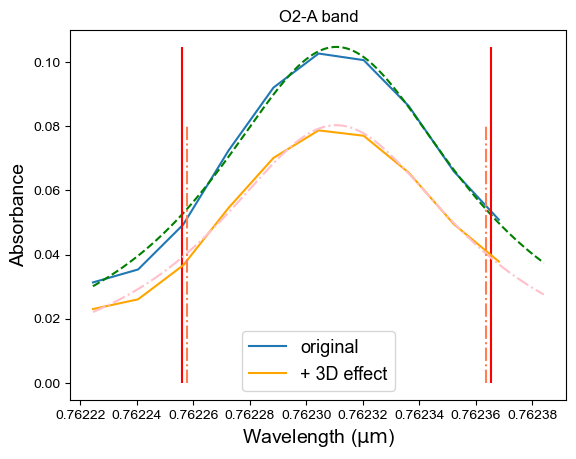

In [81]:
start, end = 273, 283
i = 5550
fp = 2

slope = 0.5
intercept = 0.15
test_ref = o2a_ref_convert/(o2a_ref_convert*slope+intercept+1)
ref_const_test = np.percentile(test_ref, np.linspace(96, 98, 11), axis=2).mean(axis=0)
ref_const_test_expand = np.repeat(ref_const_test, 1016).reshape(ref_const_test.shape[0], ref_const_test.shape[1], 1016)

A_test = -np.log10(1-(ref_const_test_expand-test_ref))
A = -np.log10(1-(o2a_ref_con_expand-o2a_ref_convert))

# A_test = -np.log10((test_ref/ref_const_test_expand))
# A = -np.log10((o2a_ref_convert/o2a_ref_con_expand))

# A_test = -np.log10(test_ref)#o2a_abs_3d_test
# A = -np.log10(o2a_ref_convert)






max_ind = np.argmax((A[i, fp, start:end]))
half_interval = 4
part_start, part_end = start+max_ind-6, start+max_ind+4+1

plt.plot(lam[fp, start:end, 0], A[i , fp, start:end], label='original')
popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 0], A[i , fp, part_start:part_end],
                       p0=[0.76232, 1e-7, 1e-5, 5e4],
                       bounds=([0.7622, 1e-11, 1e-9, 1e2], 
                               [0.7624, 1e-3, 1e-3, 5e8]),
                       max_nfev=3500)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 0], lam[fp, end, 0], 401)
plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--',)

print('center:', V0(popt[0], *popt))


max_ind = np.argmax((A[i, fp, start:end]))
A_min = 0
A_max = V0(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)




xx = wvl_linspace
yy = V0(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')




plt.plot(lam[fp, start:end, 0], A_test[i , fp, start:end], '-', color='orange', label='+ 3D effect')
popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 0], A_test[i , fp, part_start:part_end], 
                       p0=[0.76232, 1e-7, 1e-5, 5e4],
                       bounds=([0.7622, 1e-11, 1e-9, 1e2], 
                               [0.7624, 1e-3, 1e-3, 5e8]),
                       max_nfev=3500)
print(popt)

plt.plot(wvl_linspace, V0(wvl_linspace, *popt), '-.', color='pink')

print('center:', V0(popt[0], *popt))


max_ind = np.argmax((A_test[i, fp, start:end]))
A_min = 0
A_max = V0(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)



yy = V0(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, linestyle='-.', color='coral',)
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')

plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.legend(loc='lower center', fontsize=13)
plt.title('O2-A band')

[7.62310391e-01 1.91353750e-05 1.09766293e-04 1.00006511e-07]
center: 0.11098096469474185
0.05549053235062647
0.10978991380450331 nm
[7.62310395e-01 2.91449563e-05 1.10482035e-04 1.00000004e-07]
center: 0.16793921659790428
0.08396965829895396
0.11042822725682022 nm


Text(0.5, 1.0, 'O2-A band')

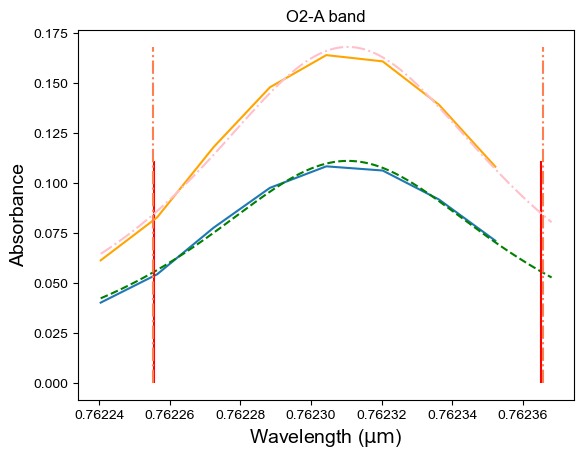

In [89]:
start, end = 274, 282
i = 5550
fp = 2

slope = 0.5
intercept = 0.3
test_ref = o2a_ref_convert*(o2a_ref_convert*slope+intercept+1)
ref_const_test = np.percentile(test_ref, np.linspace(98, 99, 11), axis=2).mean(axis=0)
ref_const_test_expand = np.repeat(ref_const_test, 1016).reshape(ref_const_test.shape[0], ref_const_test.shape[1], 1016)

A_test = -np.log10(1-(ref_const_test_expand-test_ref))
A = -np.log10(1-(o2a_ref_con_expand-o2a_ref_convert))

# A_test = -np.log10((test_ref/ref_const_test_expand))
# A = -np.log10((o2a_ref_convert/o2a_ref_con_expand))

# A_test = -np.log10(test_ref)#o2a_abs_3d_test
# A = -np.log10(o2a_ref_convert)










plt.plot(lam[fp, start:end, 0], A[i , fp, start:end])
popt, pcov = curve_fit(L, lam[fp, start:end, 0], A[i , fp, start:end],
                       p0=[0.76232, 1e-5, 1e-5, 1e-6],
                       bounds=([0.7622, 1e-11, 1e-7, 1e-7], 
                               [0.7624, 1e-1, 1e-2, 2e-6]),
                       max_nfev=2000)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 0], lam[fp, end, 0], 401)
plt.plot(wvl_linspace, L(wvl_linspace, *popt), 'g--',)

print('center:', L(popt[0], *popt))


max_ind = np.argmax((A[i, fp, start:end]))
A_min = popt[-1]
A_max = L(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)

from scipy import interpolate


xx = wvl_linspace
yy = L(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')




plt.plot(lam[fp, start:end, 0], A_test[i , fp, start:end], '-', color='orange', label='Remove 3D effect')
popt, pcov = curve_fit(L, lam[fp, start:end, 0], A_test[i , fp, start:end], 
                       p0=[0.76232, 1e-5, 1e-5, 1e-6],
                       bounds=([0.7622, 1e-11, 1e-7, 1e-7], 
                               [0.7624, 1e-1, 1e-2, 2e-6]),
                       max_nfev=2000)
print(popt)

plt.plot(wvl_linspace, L(wvl_linspace, *popt), '-.', color='pink')

print('center:', L(popt[0], *popt))


max_ind = np.argmax((A_test[i, fp, start:end]))
A_min = popt[-1]
A_max = L(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)

from scipy import interpolate


yy = L(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, linestyle='-.', color='coral',)
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')

plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('O2-A band')

[7.62310395e-01 2.27407981e-05 4.39157431e-05 3.50369720e+04]
center: 0.1796855780625335
0.08984278903126675
0.10839030946707684 nm


Text(0.5, 1.0, 'O2-A band')

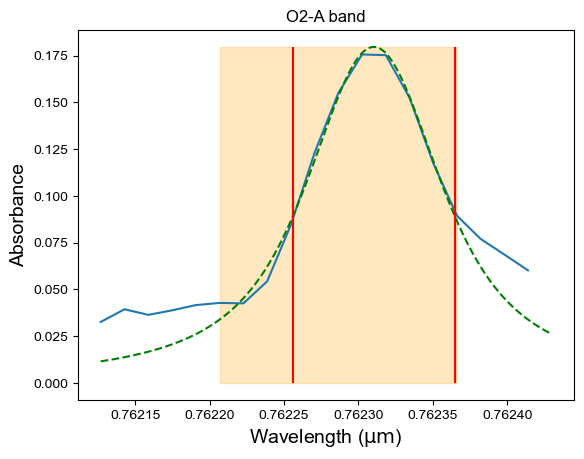

In [147]:


start, end = 268, 287
i = 1500
fp = 6



plt.plot(lam[fp, start:end, 0], A[i , fp, start:end])

max_ind = np.argmax((A[i, fp, start:end]))
half_interval = 4
part_start, part_end = start+max_ind-6, start+max_ind+4+1

popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 0], A[i , fp, part_start:part_end], 
                       p0=[0.7623, 1e-5, 1e-5, 50000],
                       bounds=([0.7622, 1e-11, 1e-11, 1e2], 
                                [0.7624, 1e-3, 1e-3, 5e8]),
                       max_nfev=2500)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 0], lam[fp, end, 0], 401)
plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--',)

print('center:', V0(popt[0], *popt))


A_min = 0
A_max = V0(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)




xx = wvl_linspace
yy = V0(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
#plt.vlines([lam[fp, part_start, 0], lam[fp, part_end, 0]], 0, A_max, 'orange')
plt.fill_betweenx([0, hm*2], lam[fp, part_start, 0], lam[fp, part_end-1, 0], color='orange', alpha=0.25)
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')

plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('O2-A band')

---------------
i, fp: 8022 0
A max: 0.08007390135570386
A min: 0
[7.62313715e-01 1.13301273e-05 9.34800029e-05 4.20876093e+04]
0.19031480949271984


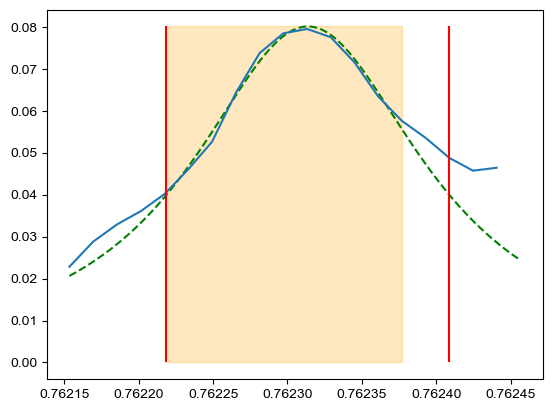

---------------
i, fp: 8023 0
A max: 0.09294989490898889
A min: 0
[7.62313284e-01 1.14422276e-05 9.37153264e-05 3.61609498e+04]
0.19107303582532875


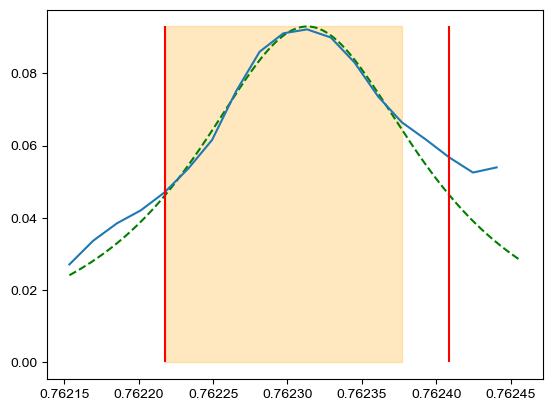

---------------
i, fp: 8061 3
A max: 0.07702809295329816
A min: 0
[7.62313209e-01 2.40228448e-05 9.03542417e-05 4.36917916e+04]
0.19328589489497894


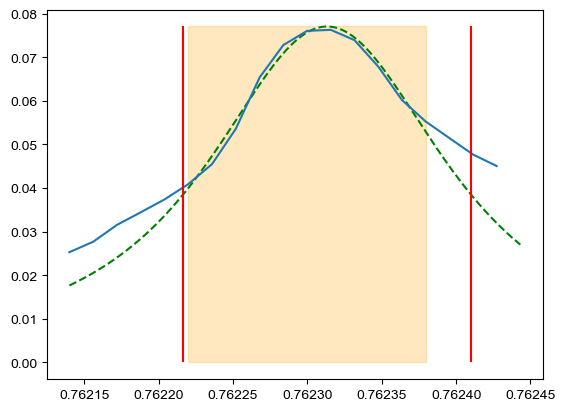

---------------
i, fp: 8062 2
A max: 0.05988120195504116
A min: 0
[7.62312261e-01 3.10284200e-10 9.56732253e-05 5.55608912e+04]
0.19180634756321702


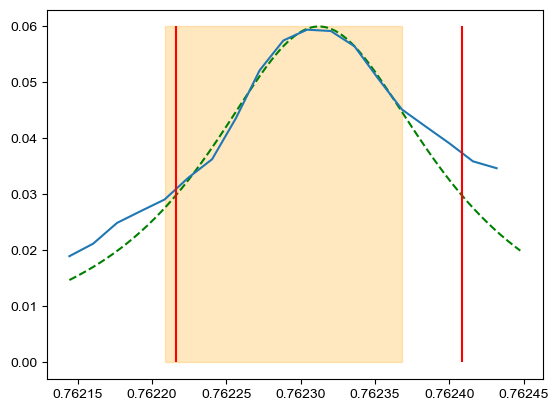

---------------
i, fp: 8062 3
A max: 0.05085212022031114
A min: 0
[7.62312665e-01 8.54811739e-06 9.70694485e-05 6.41301332e+04]
0.19555984659958003


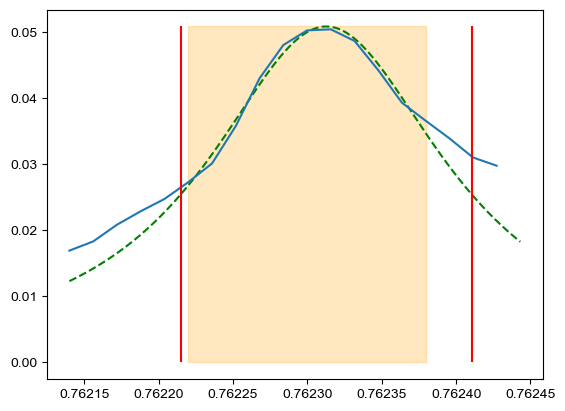

---------------
i, fp: 8067 0
A max: 0.07001500937164581
A min: 0
[7.62313166e-01 3.83166816e-10 9.73938987e-05 4.66796106e+04]
0.19486416748859536


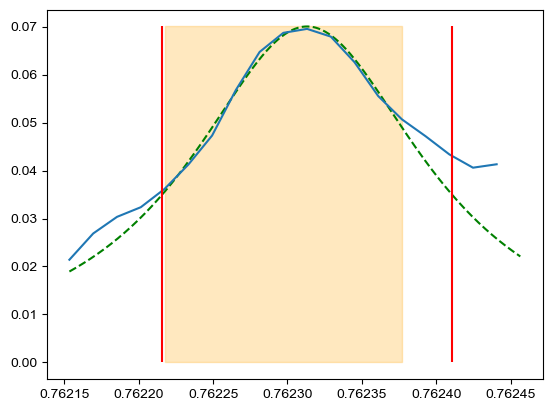

---------------
i, fp: 8067 1
A max: 0.07676998045376938
A min: 0
[7.62312881e-01 1.26355969e-11 9.51855996e-05 4.35599575e+04]
0.19032345724545596


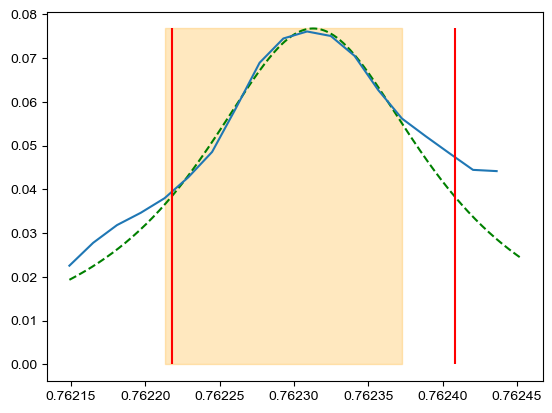

---------------
i, fp: 8068 0
A max: 0.061523038850453265
A min: 0
[7.62313463e-01 1.75166133e-05 9.15415949e-05 5.51311379e+04]
0.19031480949271984


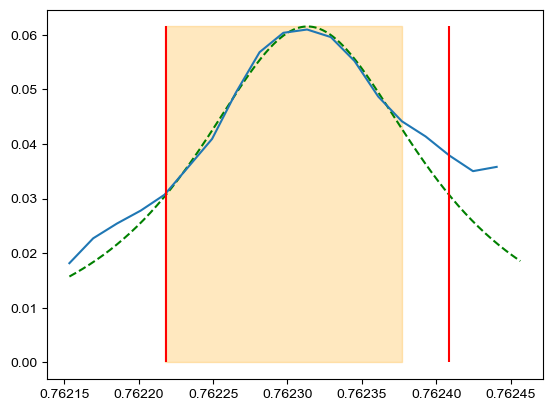

---------------
i, fp: 8068 1
A max: 0.05693895885332343
A min: 0
[7.62313188e-01 6.63869880e-10 9.56242710e-05 5.84618384e+04]
0.19108171803128293


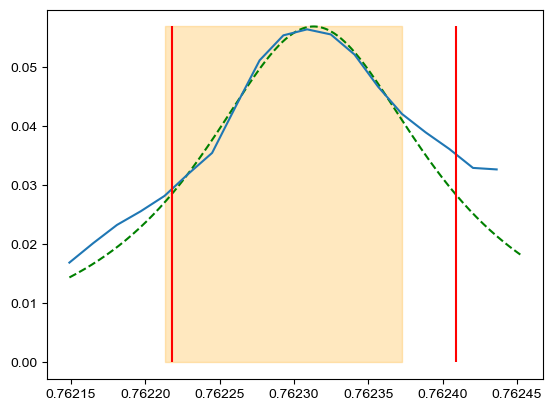

---------------
i, fp: 8069 0
A max: 0.039195684510069134
A min: 0
[7.62313870e-01 1.00000115e-11 9.58166298e-05 8.47561035e+04]
0.19183126215793767


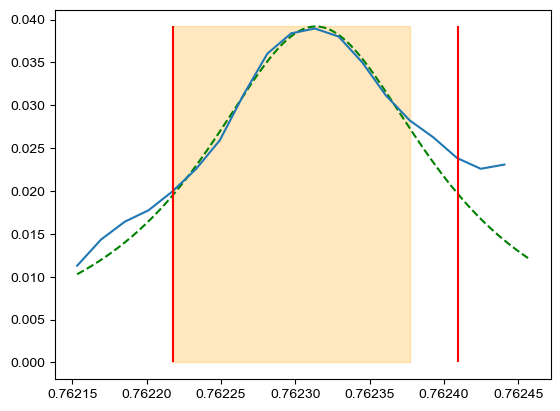

---------------
i, fp: 8069 1
A max: 0.05606625317421298
A min: 0
[7.62313476e-01 2.46787786e-10 9.59661051e-05 5.91603486e+04]
0.19259823960293687


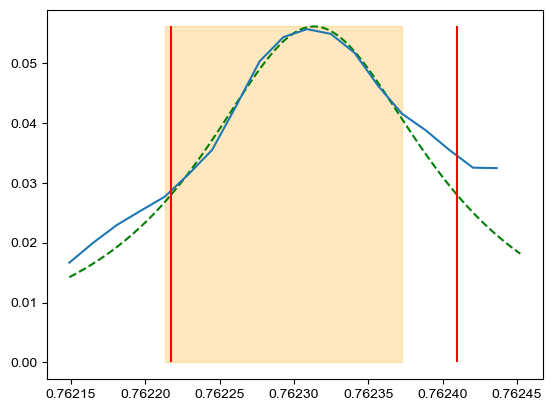

---------------
i, fp: 8069 2
A max: 0.06732094664865201
A min: 0
[7.62312631e-01 2.93624797e-11 9.54307280e-05 4.95463512e+04]
0.19104821970727937


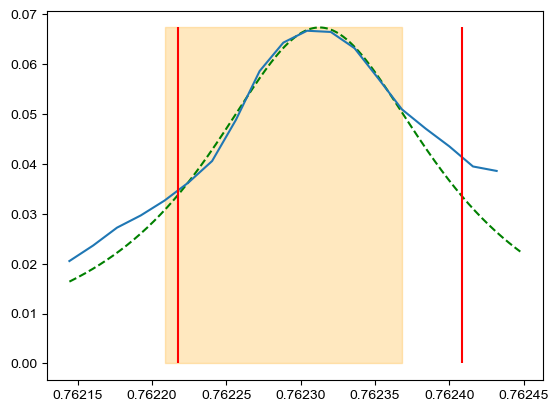

---------------
i, fp: 8070 0
A max: 0.05419835685559368
A min: 0
[7.62313232e-01 5.07651091e-08 9.77145573e-05 6.01041768e+04]
0.19562239382120428


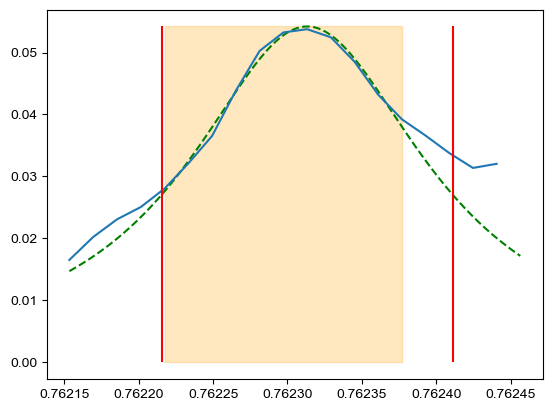

---------------
i, fp: 8070 1
A max: 0.046068527396328114
A min: 0
[7.62313154e-01 1.64056239e-10 9.68985945e-05 7.13063686e+04]
0.19335650038876384


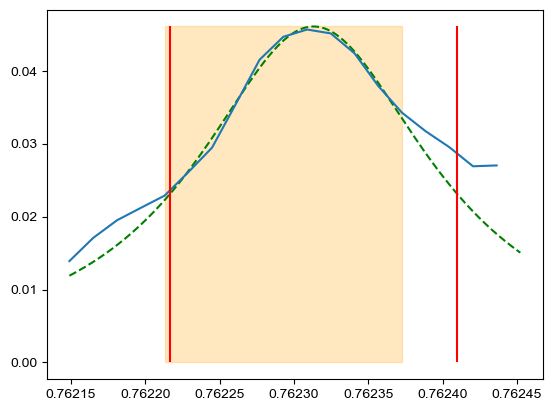

---------------
i, fp: 8070 2
A max: 0.044415988777345206
A min: 0
[7.62312175e-01 1.38052383e-09 9.72588121e-05 7.36854656e+04]
0.19483885898718967


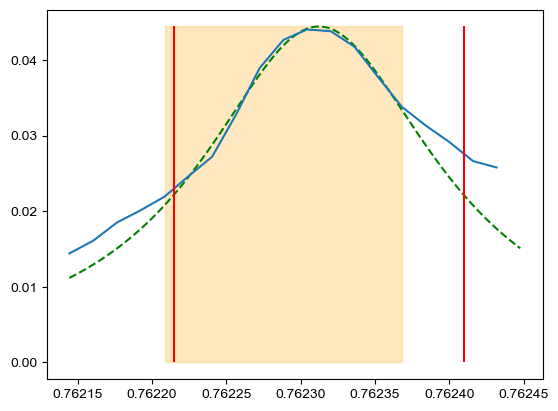

---------------
i, fp: 8071 0
A max: 0.029060484075856603
A min: 0
[7.62312688e-01 3.36716044e-10 9.89539388e-05 1.10691481e+05]
0.19789707281903102


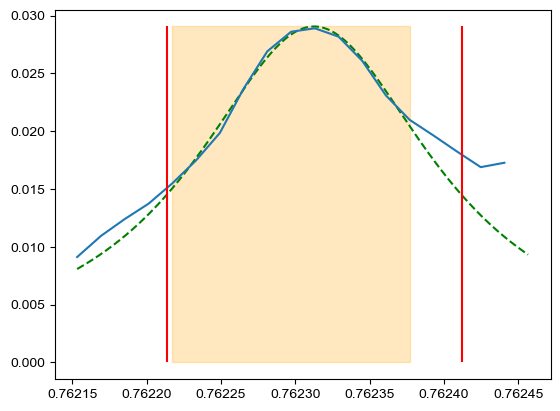

---------------
i, fp: 8071 1
A max: 0.03996738224305961
A min: 0
[7.62312820e-01 4.06592027e-10 9.73724767e-05 8.17915064e+04]
0.19487302196041778


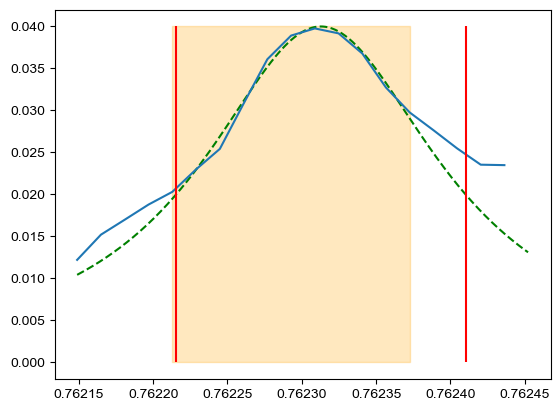

---------------
i, fp: 8071 3
A max: 0.03545864366662434
A min: 0
[7.62313846e-01 2.30226259e-05 8.95281481e-05 9.60464399e+04]
0.19101194319037784


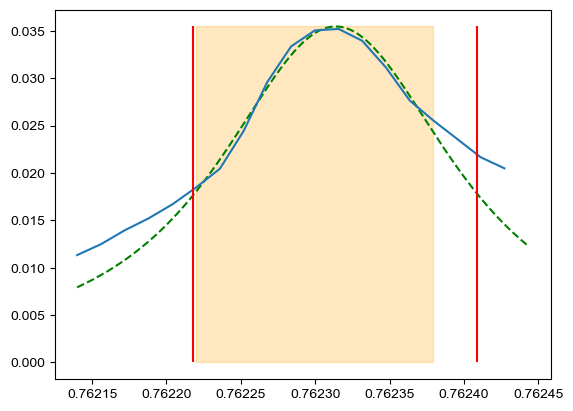

---------------
i, fp: 8072 1
A max: 0.020758550993779643
A min: 0
[7.62312449e-01 5.94742202e-10 9.92363948e-05 1.54519080e+05]
0.19866432588966365


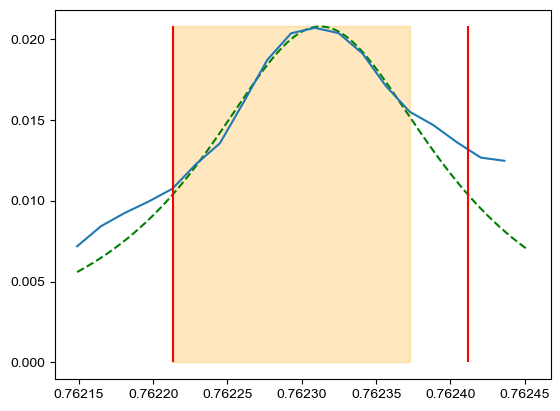

---------------
i, fp: 8072 2
A max: 0.027845282421920952
A min: 0
[7.62312073e-01 2.75109105e-10 1.00386397e-04 1.13873753e+05]
0.2001457539790863


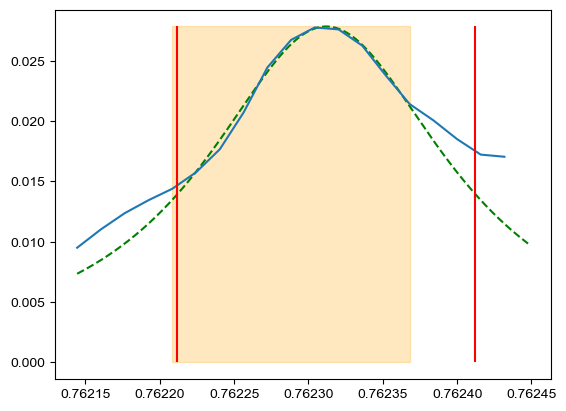

---------------
i, fp: 8072 3
A max: 0.03557349820640821
A min: 0
[7.62313738e-01 1.96423539e-05 9.42264393e-05 9.22291269e+04]
0.19707581440264743


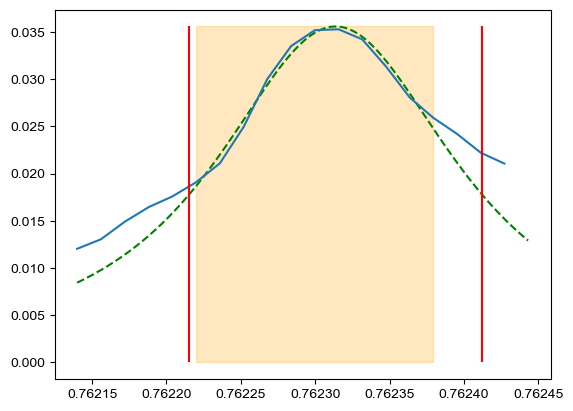

---------------
i, fp: 8073 5
A max: 0.03862471898391953
A min: 0
[7.62313530e-01 1.58674922e-05 9.35313421e-05 8.63847969e+04]
0.1933001671947654


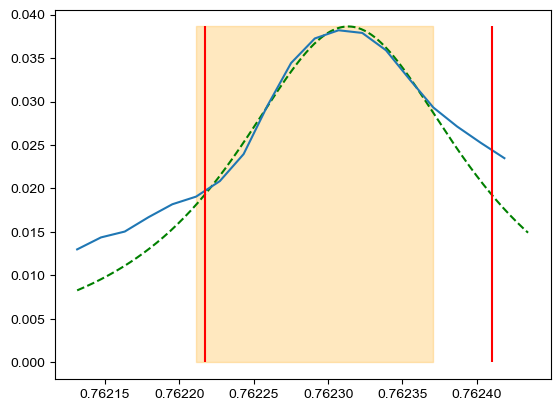

---------------
i, fp: 8075 5
A max: 0.016754646888038124
A min: 0
[7.62313956e-01 1.00000000e-11 9.75743101e-05 1.94706011e+05]
0.1955742868088306


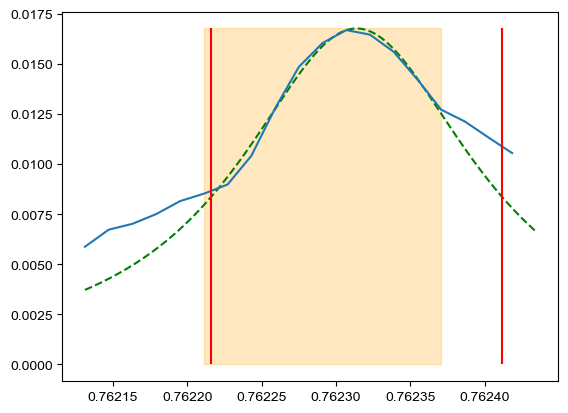

---------------
i, fp: 8075 6
A max: 0.029732611707517655
A min: 0
[7.62314707e-01 7.99200618e-05 2.69436235e-05 1.47876396e+05]
0.19100949640360465


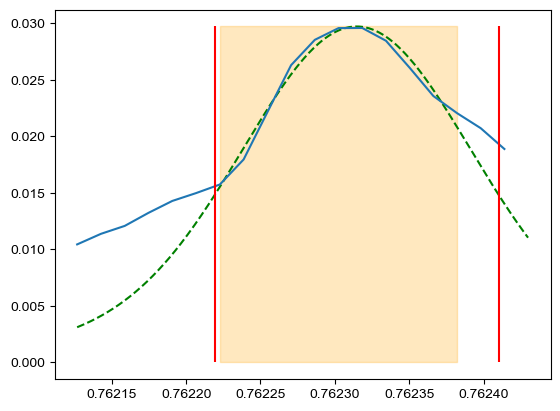

---------------
i, fp: 8076 0
A max: 0.008965064957252633
A min: 0
[7.62311544e-01 2.53904259e-11 9.61568064e-05 3.69246728e+05]
0.1925894884906576


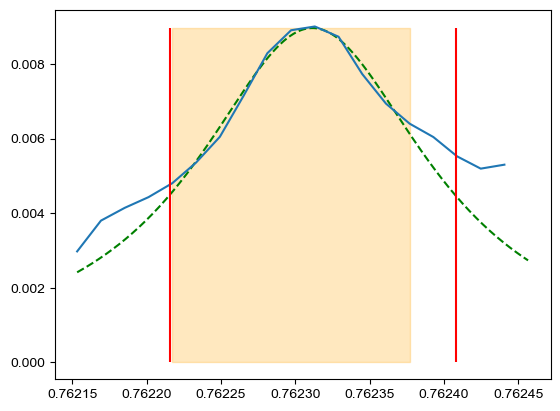

---------------
i, fp: 8076 6
A max: 0.022412337226665455
A min: 0
[7.62313455e-01 6.62272813e-08 9.72937286e-05 1.45974833e+05]
0.19479936736399583


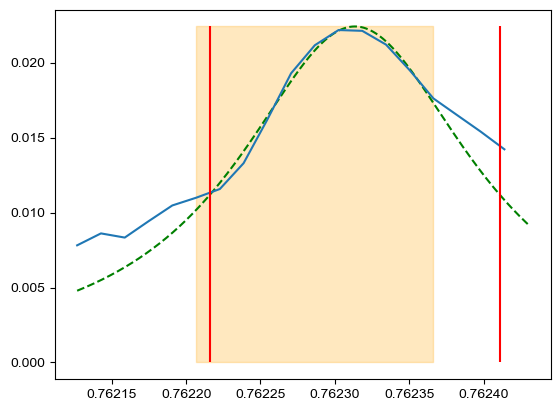

---------------
i, fp: 8077 7
A max: 0.027720637702006574
A min: 0
[7.62314739e-01 6.85966555e-05 4.54242606e-05 1.45815770e+05]
0.19176984252466944


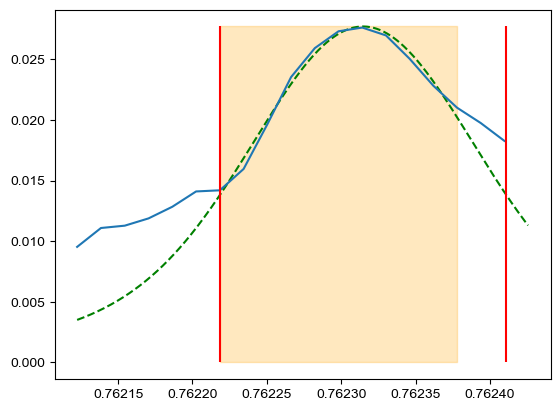

---------------
i, fp: 8078 0
A max: 0.06523572009739695
A min: 0
[7.62314272e-01 5.38423817e-06 1.02181368e-04 4.76570809e+04]
0.2047211098128443


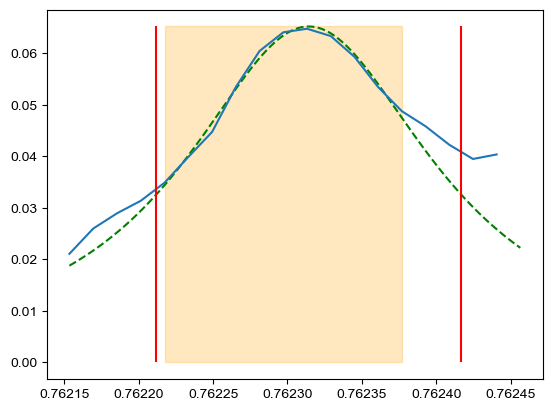

---------------
i, fp: 8078 1
A max: 0.028552675518616216
A min: 0
[7.62313038e-01 5.97713198e-09 1.00388970e-04 1.11049681e+05]
0.20093910824714456


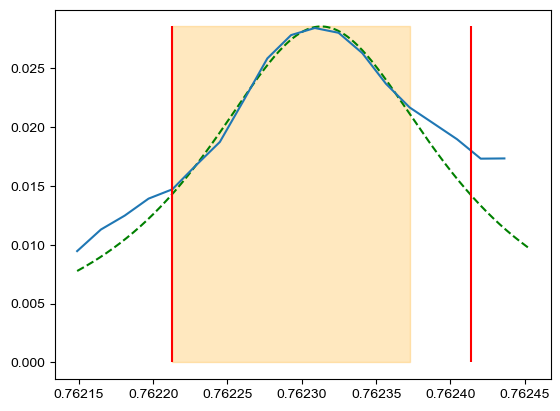

---------------
i, fp: 8078 7
A max: 0.01437198880745011
A min: 0
[7.62314731e-01 4.53251136e-05 7.41527953e-05 2.49271541e+05]
0.19328580965916053


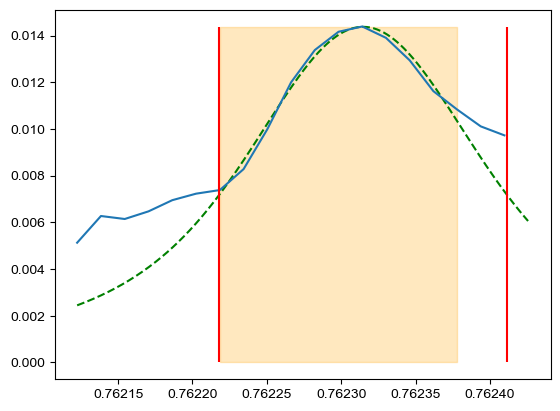

---------------
i, fp: 8079 0
A max: 0.10581799115347516
A min: 0
[7.62314126e-01 1.64122002e-05 9.63189440e-05 3.06137403e+04]
0.19865529915175095


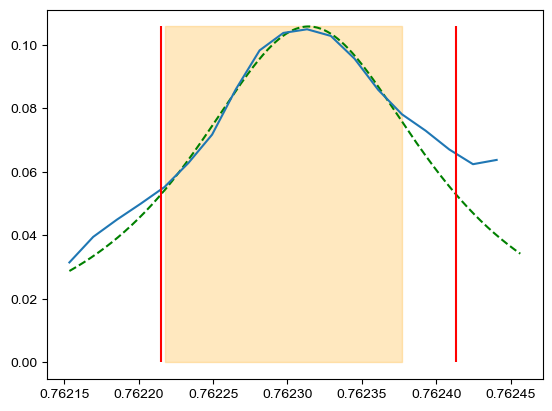

---------------
i, fp: 8079 1
A max: 0.12444376979439373
A min: 0
[7.62313500e-01 1.92783488e-05 9.28562844e-05 2.67595581e+04]
0.1941147611745908


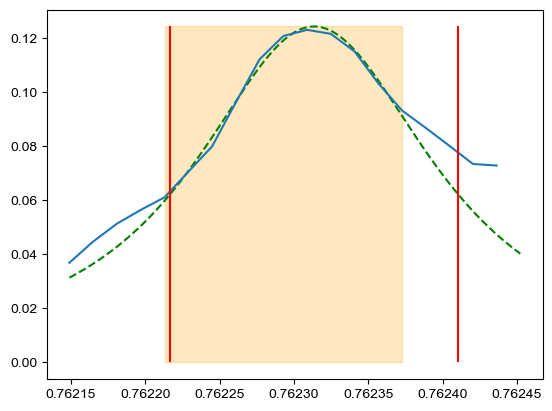

---------------
i, fp: 8079 2
A max: 0.07202276935537824
A min: 0
[7.62312492e-01 9.52852747e-11 9.96183306e-05 4.43650577e+04]
0.19938762612303762


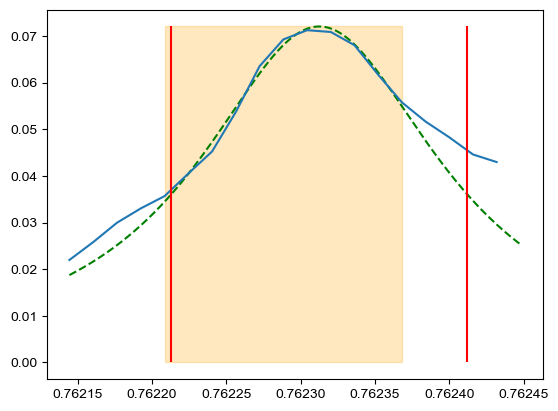

---------------
i, fp: 8079 3
A max: 0.03288492918686607
A min: 0
[7.62314059e-01 4.01489089e-05 7.92633527e-05 1.06573582e+05]
0.19404387879651264


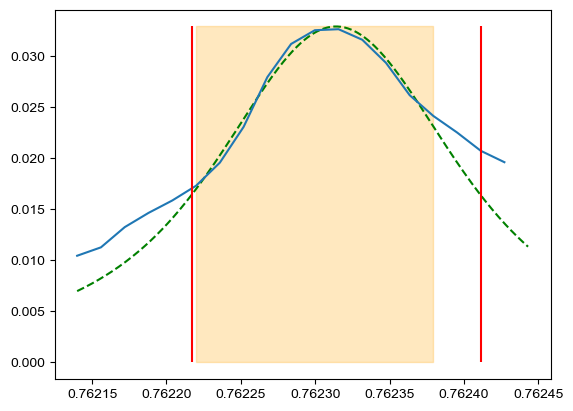

---------------
i, fp: 8079 4
A max: 0.02440848322152083
A min: 0
[7.62314181e-01 2.09649291e-05 9.24599117e-05 1.36308818e+05]
0.19481624636108474


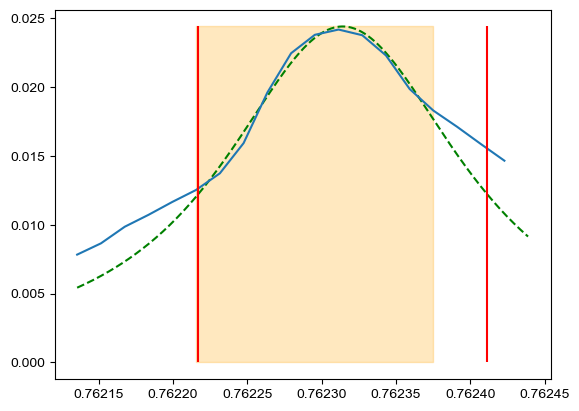

---------------
i, fp: 8080 0
A max: 0.12316844010445313
A min: 0
[7.62313849e-01 1.91981776e-05 9.61284109e-05 2.61695220e+04]
0.20017175181696878


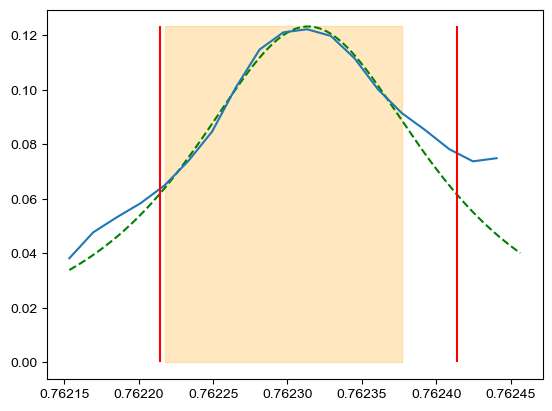

---------------
i, fp: 8080 1
A max: 0.10921434556863864
A min: 0
[7.62313822e-01 1.02442439e-05 9.69203475e-05 2.98348194e+04]
0.19638954353218274


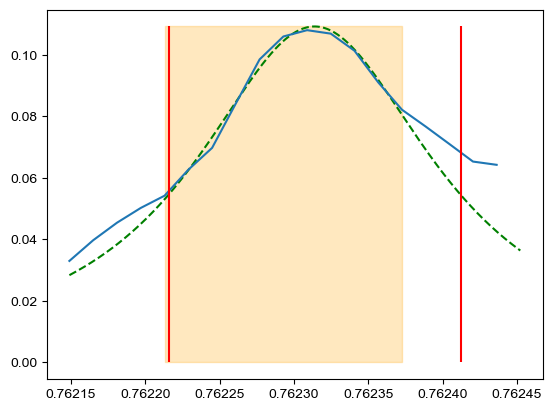

---------------
i, fp: 8080 2
A max: 0.12411123706435682
A min: 0
[7.62312874e-01 9.34580496e-06 9.41431304e-05 2.70530404e+04]
0.19029009185134171


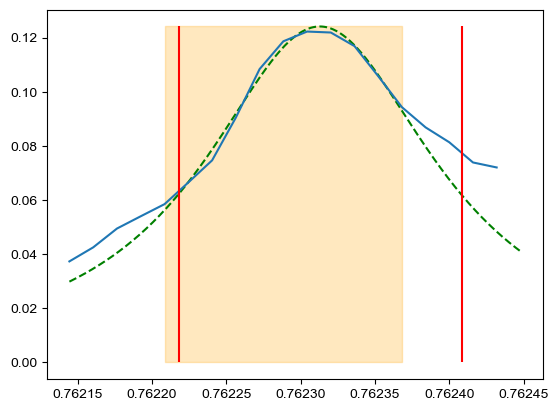

---------------
i, fp: 8080 3
A max: 0.09029567138442501
A min: 0
[7.62313862e-01 3.34055961e-05 8.57980147e-05 3.75891441e+04]
0.19631783050111373


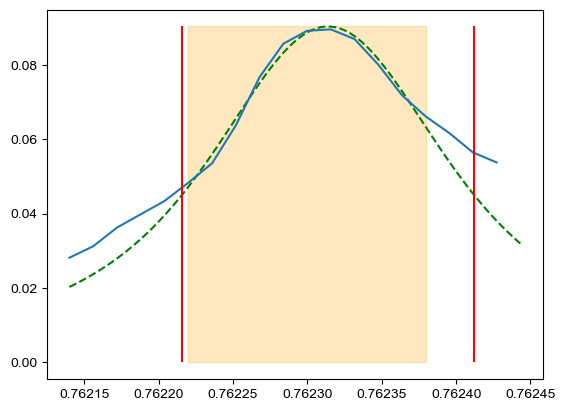

---------------
i, fp: 8080 4
A max: 0.0697419927579489
A min: 0
[7.62313581e-01 3.04540824e-05 8.68587444e-05 4.87741816e+04]
0.19405820649198713


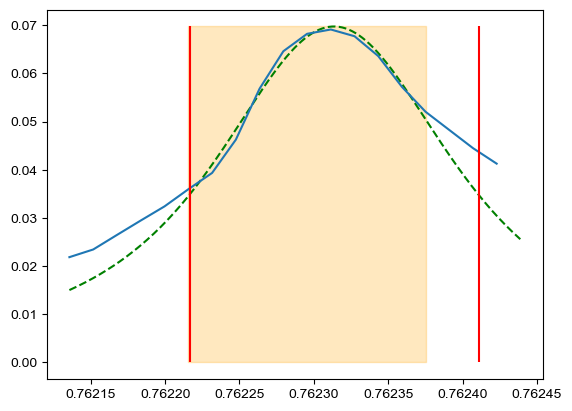

---------------
i, fp: 8080 5
A max: 0.05045675982330804
A min: 0
[7.62313498e-01 3.15292873e-05 8.55656338e-05 6.79853633e+04]
0.1933001671947654


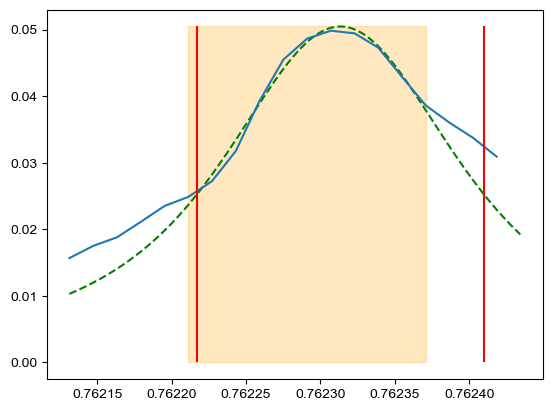

---------------
i, fp: 8080 6
A max: 0.04508479765552188
A min: 0
[7.62315635e-01 9.62674026e-05 2.61393765e-11 1.08225177e+05]
0.19252544478776112


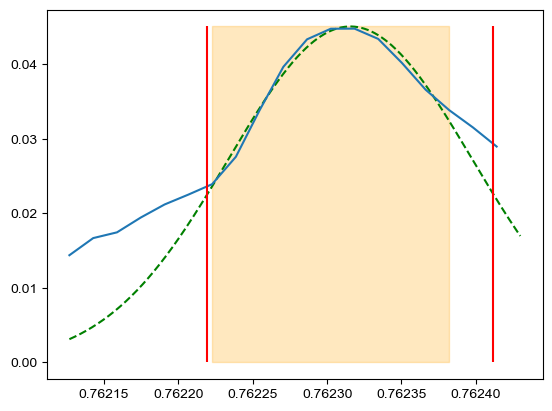

---------------
i, fp: 8081 0
A max: 0.11556100319471505
A min: 0
[7.62313431e-01 1.63056323e-05 9.52617085e-05 2.83388917e+04]
0.1963806201538132


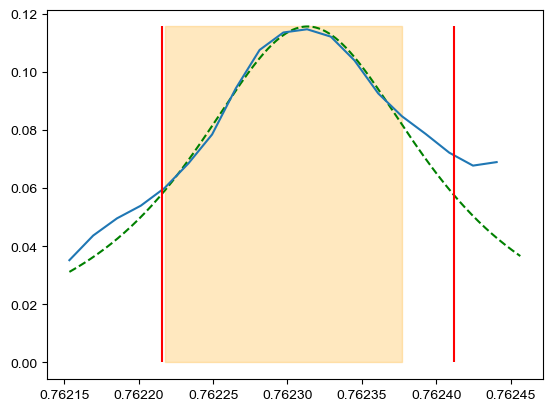

---------------
i, fp: 8081 1
A max: 0.10828953234683099
A min: 0
[7.62313229e-01 4.18333048e-09 9.93695136e-05 2.95808388e+04]
0.19866432588966365


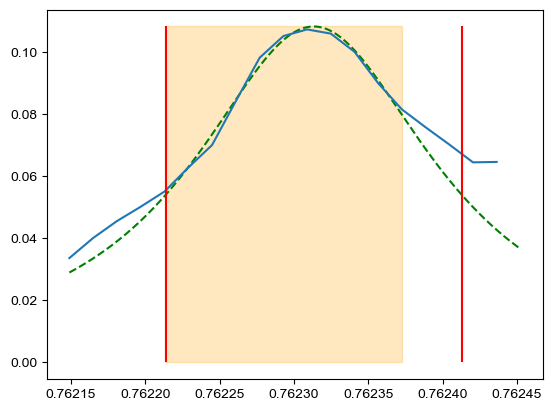

---------------
i, fp: 8081 2
A max: 0.09751315429149374
A min: 0
[7.62312747e-01 2.88327095e-11 9.84299704e-05 3.31634396e+04]
0.19711324255522467


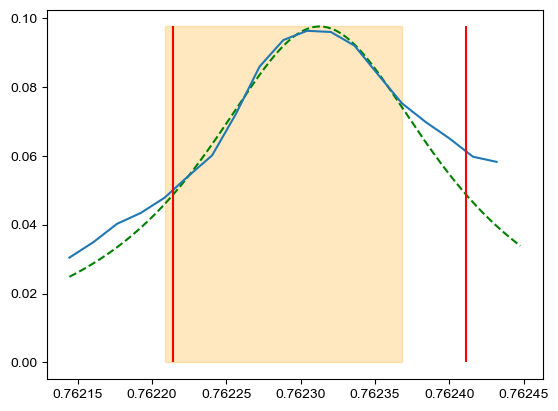

---------------
i, fp: 8081 3
A max: 0.10130796124584743
A min: 0
[7.62313059e-01 3.40158313e-05 8.71689177e-05 3.29651839e+04]
0.19934976610735955


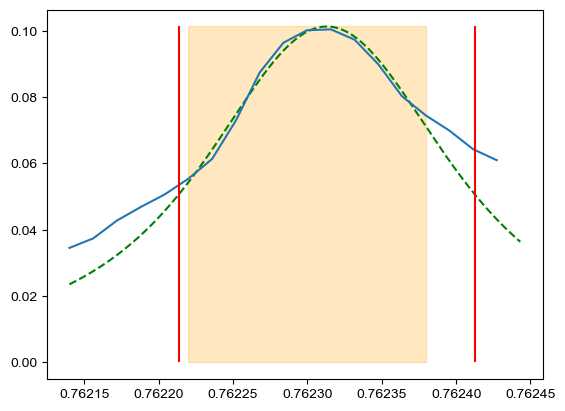

---------------
i, fp: 8081 4
A max: 0.09628051438199245
A min: 0
[7.62313595e-01 3.28315428e-05 8.55114067e-05 3.54438025e+04]
0.19481624636119577


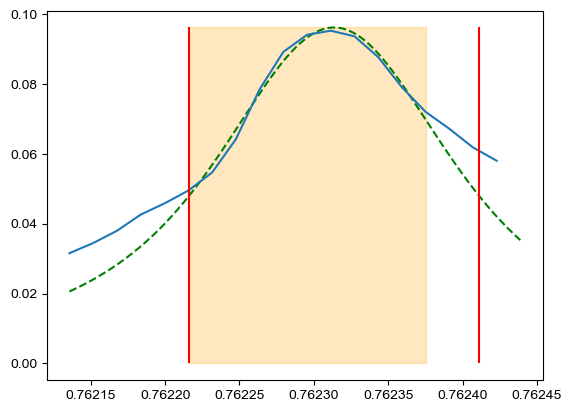

---------------
i, fp: 8082 0
A max: 0.11950228414096664
A min: 0
[7.62312892e-01 1.23677754e-05 9.76910424e-05 2.69609697e+04]
0.1994135254844709


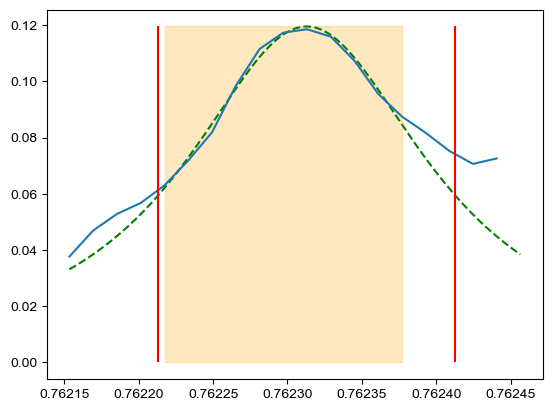

---------------
i, fp: 8082 1
A max: 0.11017028821257208
A min: 0
[7.62313258e-01 4.16900068e-10 9.70119449e-05 2.97824506e+04]
0.1941147611745908


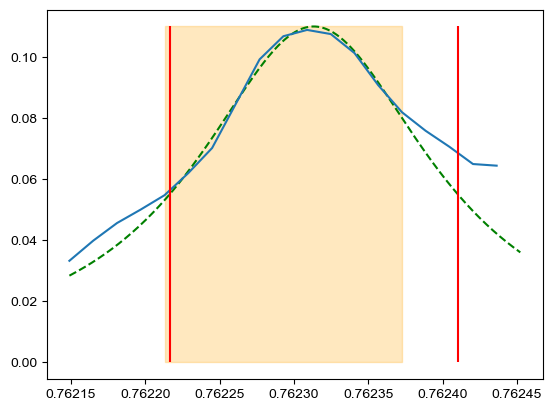

---------------
i, fp: 8082 2
A max: 0.14143504132091317
A min: 0
[7.62312835e-01 1.15257849e-11 9.59614679e-05 2.34528822e+04]
0.19180634756332804


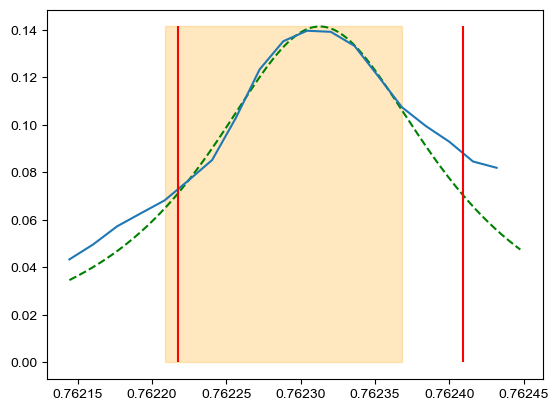

In [148]:
# o2a
FWHM_array = np.zeros((A.shape[0], A.shape[1]))

start, end = 268, 287
wl = lam[:, :, 0]
plt_test = 0
for i in range(A.shape[0]):
    for fp in range(8):
        max_ind = np.argmax((A[i, fp, start:end]))
        half_interval = 4
        part_start, part_end = start+max_ind-6, start+max_ind+4+1
        if (A[i , fp, part_start:part_end]<5e-4).all():
            FWHM_array[i,fp] = np.nan
        else:
            try:
                popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 0], A[i , fp, part_start:part_end],
                                       p0=[0.7623, 1e-5, 1e-5, 50000],
                                       bounds=([0.7622, 1e-11, 1e-11, 1e2], 
                                                [0.7624, 1e-3, 1e-3, 5e8]),
                                       max_nfev=2500)
                wvl_linspace = np.linspace(lam[fp, start, 0], lam[fp, end, 0], 401)


                A_min = 0#popt[-1]
                A_max = V0(popt[0], *popt)
                hm = (A_max-A_min)/2+A_min

                xx = wvl_linspace
                yy = V0(wvl_linspace, *popt)

                yy_max_ind = np.argmax(yy)

                xx_l = xx[:yy_max_ind]
                yy_l = yy[:yy_max_ind]
                hm_ind_l = np.argmin(np.abs(yy_l-hm))

                xx_r = xx[yy_max_ind-1:]
                yy_r = yy[yy_max_ind-1:]
                hm_ind_r = np.argmin(np.abs(yy_r-hm))


                FWHM = np.abs(xx_r[hm_ind_r]-xx_l[hm_ind_l])*1e3 # to nm
                FWHM_array[i,fp] = FWHM

                if FWHM < 0.002:
                    plt.clf()
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)
                    #plt.vlines(wl[fp, start+max_ind], 0, A[i,fp,max_ind+start],'green')
                    plt.plot(wl[fp, start:end], A[i,fp,start:end])
                    plt.plot(wvl_linspace, yy, 'g--')
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 0], lam[fp, part_end-1, 0], color='orange', alpha=0.25)
                    plt.show()
                if FWHM >= 0.19 and plt_test<50:
                    print('-'*15)
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)

                    plt.clf()
                    plt.plot(wvl_linspace, yy, 'g--')
                    plt.plot(wl[fp, start:end], A[i,fp,start:end])
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 0], lam[fp, part_end-1, 0], color='orange', alpha=0.25)
                    plt.show()

                    plt_test += 1
            except:
                FWHM_array[i,fp] = np.nan
            #print(f'{FWHM:.3f}', 'nm')

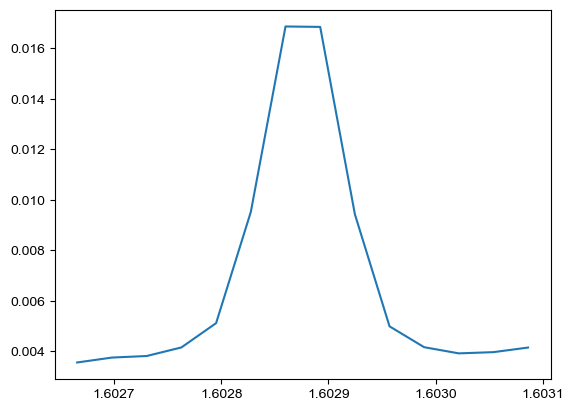

[1.60287562e+00 1.08778333e-09 5.06748106e-05 3.39453243e+05
 1.00000000e-08]
center: 0.018504538822521312
0.009252274411260657
0.1007743464047639 nm


Text(0.5, 1.0, 'WCO2 band')

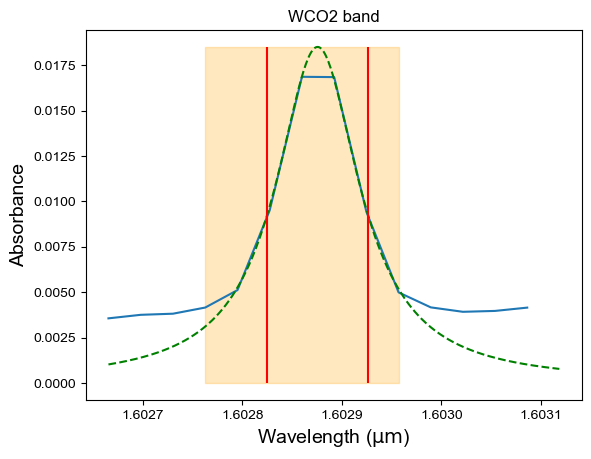

In [179]:
#wco2

start, end = 351, 364+1
i = 2000
fp = 4#0

plt.plot(lam[fp, start:end, 1], A_wco2[i , fp, start:end])
plt.show()

max_ind = np.argmax((A_wco2[i, fp, start:end]))
half_interval = 4
part_start, part_end = start+max_ind-3, start+max_ind+3+1

plt.plot(lam[fp, start:end, 1], A_wco2[i , fp, start:end])
popt, pcov = curve_fit(V, lam[fp, part_start:part_end, 1], A_wco2[i , fp, part_start:part_end], 
                       p0=[1.60285, 1e-5, 1e-5, 4e5, 0],
                       bounds=([1.60275, 1e-9, 1e-9, 1e4, 0], 
                               [1.60295, 1e-4, 1e-4, 1e9, 1e-8]),
                       max_nfev=5000)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 1], lam[fp, end, 1], 401)
plt.plot(wvl_linspace, V(wvl_linspace, *popt), 'g--',)

print('center:', V(popt[0], *popt))


max_ind = np.argmax((A_wco2[i, fp, start:end]))
A_min = popt[-1]
A_max = V(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)

from scipy import interpolate


xx = wvl_linspace
yy = V(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
plt.fill_betweenx([0, hm*2], lam[fp, part_start, 1], lam[fp, part_end-1, 1], color='orange', alpha=0.25)
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('WCO2 band')

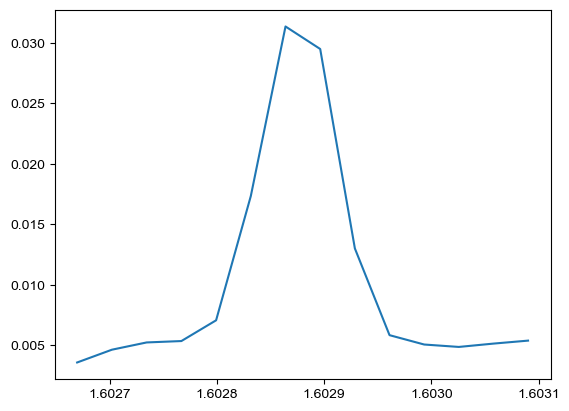

[1.60287607e+00 2.00601431e-05 3.46107342e-05 2.28667167e+05]
center: 0.03402756566006732
0.01701378283003366
0.08831017635624328 nm


Text(0.5, 1.0, 'WCO2 band')

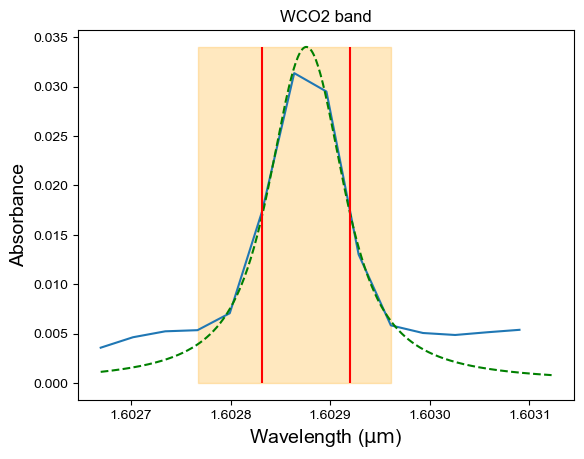

In [216]:
#wco2

start, end = 351, 364+1
i = 169
fp = 6

plt.plot(lam[fp, start:end, 1], A_wco2[i , fp, start:end])
plt.show()

max_ind = np.argmax((A_wco2[i, fp, start:end]))
half_interval = 4
part_start, part_end = start+max_ind-3, start+max_ind+3+1

plt.plot(lam[fp, start:end, 1], A_wco2[i , fp, start:end])
popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 1], A_wco2[i , fp, part_start:part_end], 
                       p0=[1.60285, 1e-5, 1e-5, 1e5],
                       bounds=([1.60275, 1e-6, 1e-6, 1e3], 
                               [1.60295, 1e-4, 1e-4, 1e8]),
                       max_nfev=5000)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 1], lam[fp, end, 1], 401)
plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--',)

print('center:', V0(popt[0], *popt))


max_ind = np.argmax((A_wco2[i, fp, start:end]))
A_min = 0
A_max = V0(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)


yy = V0(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(wvl_linspace[hm_ind], 0, A_max, 'r')
plt.fill_betweenx([0, hm*2], lam[fp, part_start, 1], lam[fp, part_end-1, 1], color='orange', alpha=0.25)
FWHM = np.abs(wvl_linspace[hm_ind[0]]-wvl_linspace[hm_ind[1]])
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('WCO2 band')

---------------
plt_test: 0
i, fp: 6425 0
A max: 0.0016514246286376598
A min: 0
[1.60287741e+00 9.99971014e-05 9.99969817e-05 1.35980856e+06]
0.32842534445265414


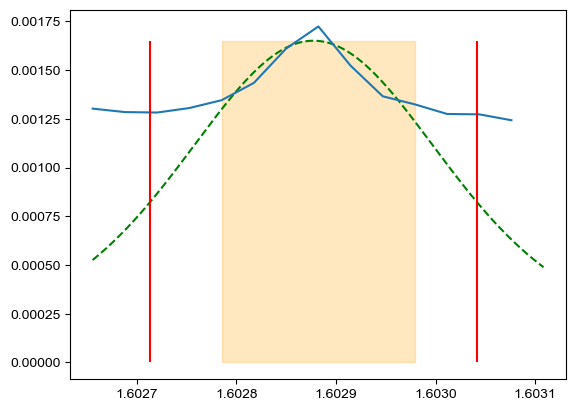

---------------
plt_test: 1
i, fp: 6426 0
A max: 0.001570289966696908
A min: 0
[1.60288074e+00 9.99877555e-05 9.99899247e-05 1.43018266e+06]
0.32729284326515895


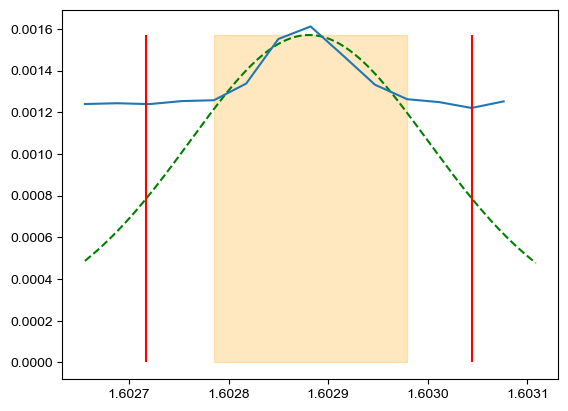

---------------
plt_test: 2
i, fp: 6426 1
A max: 0.0013473193912287176
A min: 0
[1.60287910e+00 9.90569206e-05 9.96024985e-05 1.67720224e+06]
0.3261527621454263


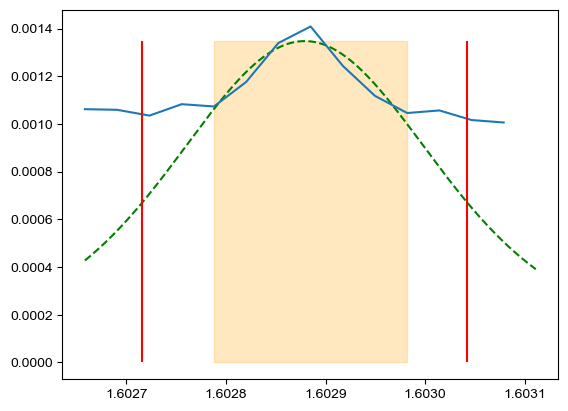

---------------
plt_test: 3
i, fp: 6426 2
A max: 0.0011010071432832574
A min: 0
[1.60287048e+00 3.46911823e-05 9.99977905e-05 2.68720789e+06]
0.22306362069657304


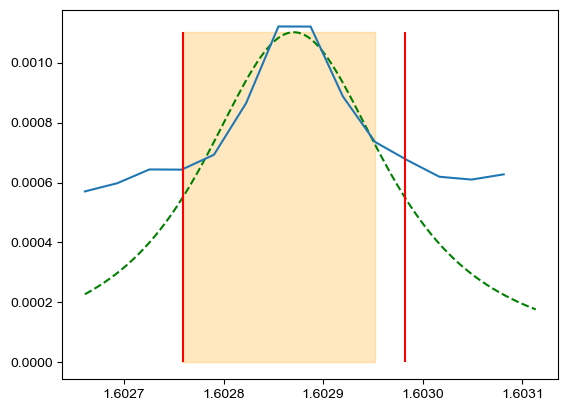

---------------
plt_test: 4
i, fp: 6427 0
A max: 0.0015542593108328197
A min: 0
[1.60287698e+00 9.99237561e-05 9.99321829e-05 1.44580663e+06]
0.3272928432649369


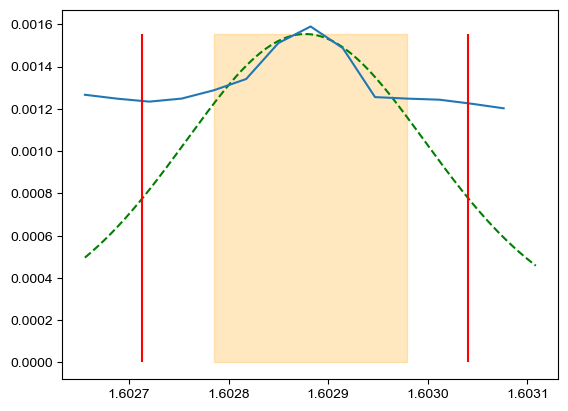

---------------
plt_test: 5
i, fp: 6427 1
A max: 0.0009003960440408073
A min: 0
[1.60288205e+00 8.41474997e-05 9.74837465e-05 2.71219565e+06]
0.2955759406941816


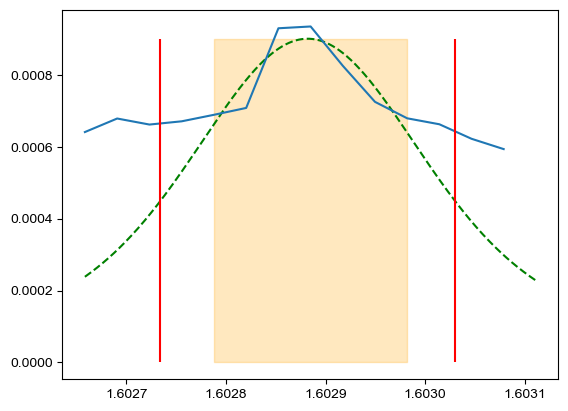

---------------
plt_test: 6
i, fp: 6428 0
A max: 0.000744936090052068
A min: 0
[1.60287896e+00 6.04359739e-05 8.88498810e-05 3.89507601e+06]
0.241222752994652


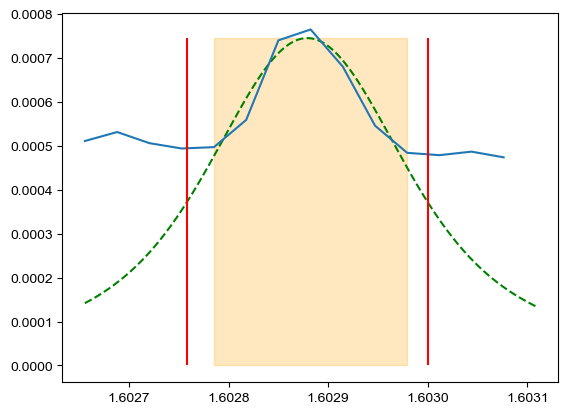

---------------
plt_test: 7
i, fp: 6437 5
A max: 0.0016256006953728152
A min: 0
[1.60287152e+00 4.75741791e-05 9.99845339e-05 1.73103749e+06]
0.24001863569500514


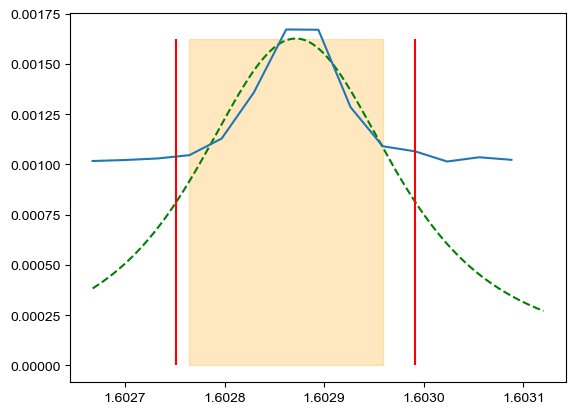

---------------
plt_test: 8
i, fp: 6524 0
A max: 0.002422290949598666
A min: 0
[1.60287825e+00 9.99949434e-05 9.99927589e-05 9.27096163e+05]
0.3272928432649369


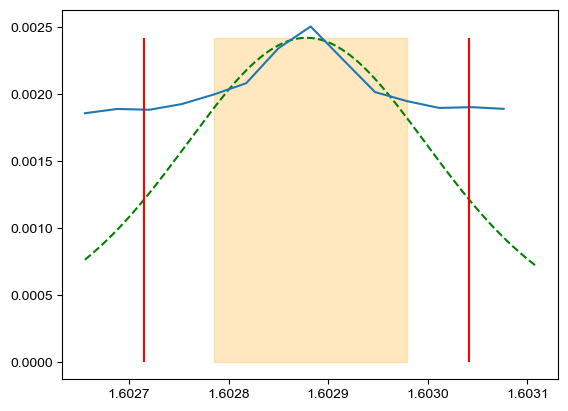

---------------
plt_test: 9
i, fp: 6524 1
A max: 0.00261647454222219
A min: 0
[1.60287800e+00 7.45560409e-05 9.76109492e-05 9.73245048e+05]
0.27858881766573695


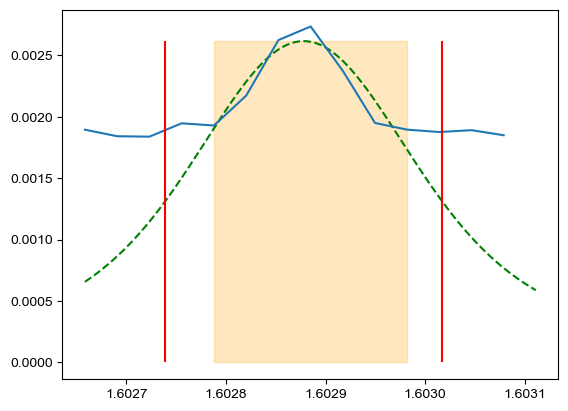

---------------
plt_test: 10
i, fp: 6525 0
A max: 0.002006228960074264
A min: 0
[1.60287768e+00 9.99998141e-05 9.99983860e-05 1.11930267e+06]
0.3272928432649369


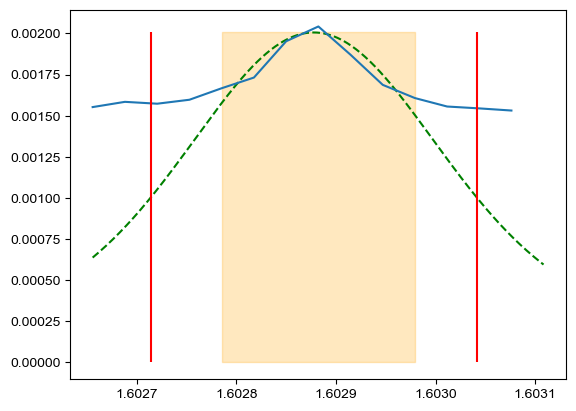

---------------
plt_test: 11
i, fp: 6525 1
A max: 0.0013707689368071265
A min: 0
[1.60288140e+00 7.79728047e-05 9.65063833e-05 1.84316851e+06]
0.2831187171401517


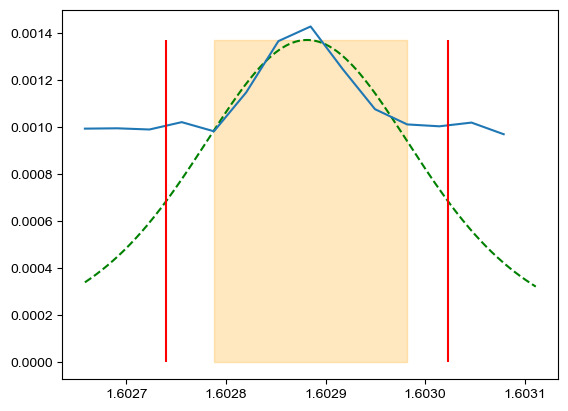

---------------
plt_test: 12
i, fp: 6526 0
A max: 0.0008407587203307205
A min: 0
[1.60287772e+00 3.97691509e-05 9.89422694e-05 3.48374649e+06]
0.22763273874137901


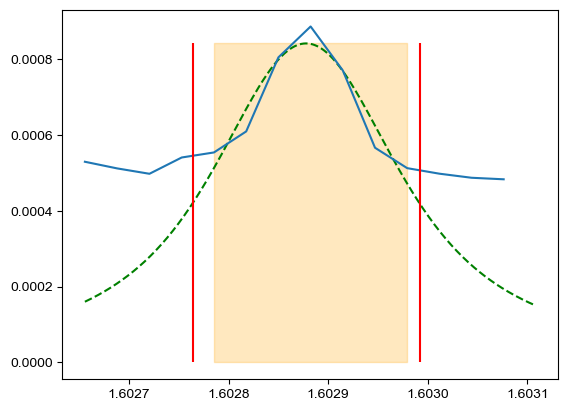

---------------
plt_test: 13
i, fp: 6580 7
A max: 0.0005498792594854615
A min: 0
[1.60286909e+00 8.44199205e-05 9.15444097e-05 4.61079037e+06]
0.2864391351287132


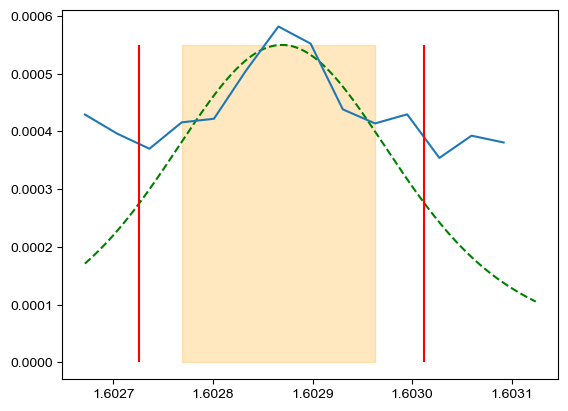

---------------
plt_test: 14
i, fp: 6581 6
A max: 0.0010271115996437583
A min: 0
[1.60287230e+00 9.99374818e-05 9.98809363e-05 2.18836543e+06]
0.32720052521728604


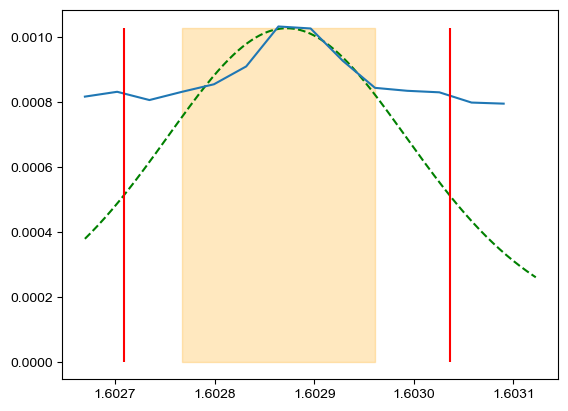

---------------
plt_test: 15
i, fp: 6581 7
A max: 0.0013479436647353508
A min: 0
[1.60287208e+00 9.99722375e-05 9.99622513e-05 1.66647036e+06]
0.3271972729332884


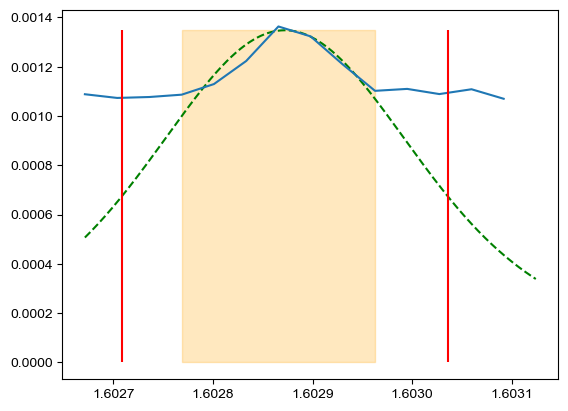

---------------
plt_test: 16
i, fp: 6582 5
A max: 0.0012769285724070288
A min: 0
[1.60286611e+00 9.99971936e-05 9.99239643e-05 1.75935439e+06]
0.32719521564117393


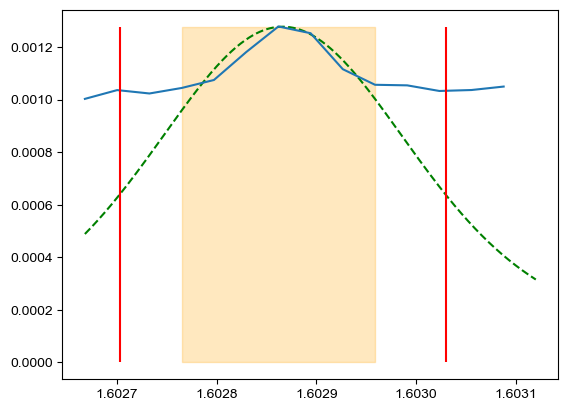

---------------
plt_test: 17
i, fp: 6582 6
A max: 0.0017592673644406468
A min: 0
[1.60286730e+00 9.99536586e-05 9.99501158e-05 1.27703267e+06]
0.3272005252175081


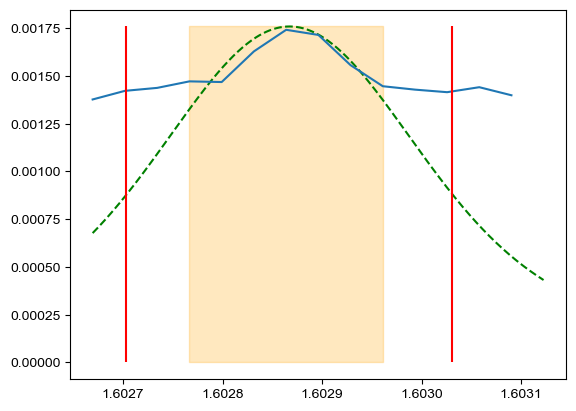

---------------
plt_test: 18
i, fp: 6582 7
A max: 0.0014554547679530444
A min: 0
[1.60287003e+00 9.99764829e-05 9.99223857e-05 1.54370070e+06]
0.3271972729332884


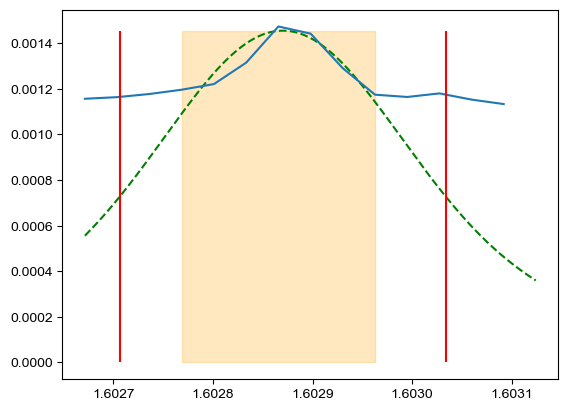

---------------
plt_test: 19
i, fp: 6583 4
A max: 0.0015504698192696836
A min: 0
[1.60288220e+00 9.99955315e-05 9.99638052e-05 1.44863671e+06]
0.3272335518087477


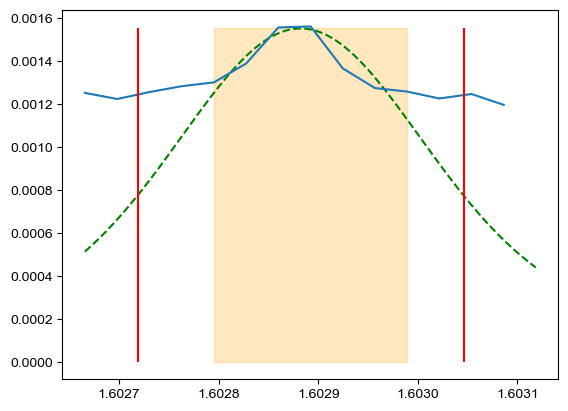

---------------
plt_test: 20
i, fp: 6583 5
A max: 0.0018743044718378483
A min: 0
[1.60286778e+00 9.99457867e-05 9.99005822e-05 1.19903734e+06]
0.32719521564117393


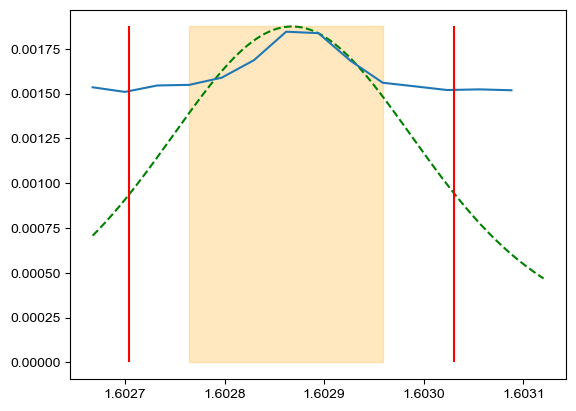

---------------
plt_test: 21
i, fp: 6583 6
A max: 0.001789657957909777
A min: 0
[1.60286869e+00 9.99416760e-05 9.99485361e-05 1.25542196e+06]
0.32720052521728604


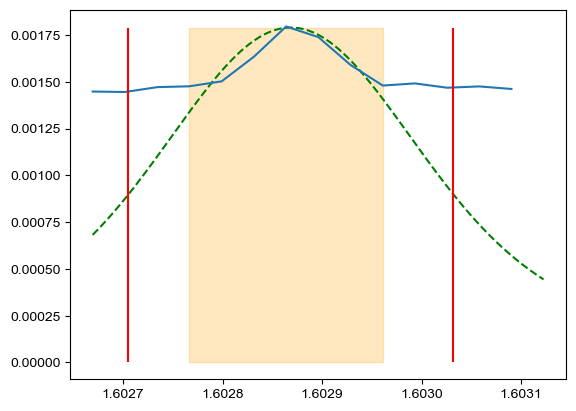

---------------
plt_test: 22
i, fp: 6583 7
A max: 0.0014290307307719338
A min: 0
[1.60286774e+00 9.99991117e-05 9.99959522e-05 1.57142577e+06]
0.3271972729332884


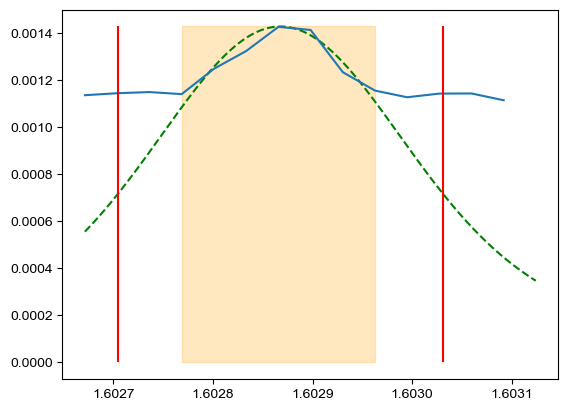

---------------
plt_test: 23
i, fp: 6584 5
A max: 0.0024891527516066594
A min: 0
[1.60287111e+00 5.76482191e-05 9.99253420e-05 1.08397272e+06]
0.2547367595822081


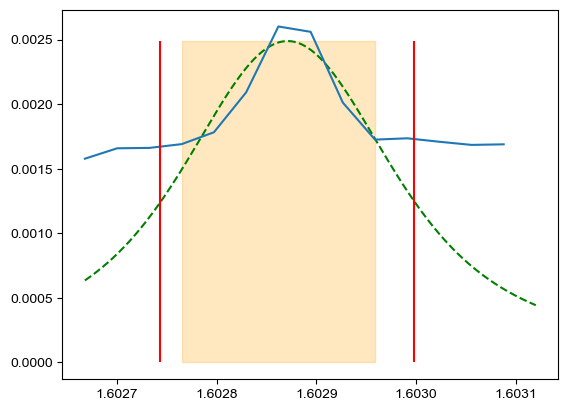

---------------
plt_test: 24
i, fp: 6584 6
A max: 0.0017854657601410798
A min: 0
[1.60286756e+00 9.99987903e-05 9.99989187e-05 1.25769995e+06]
0.32833270696563943


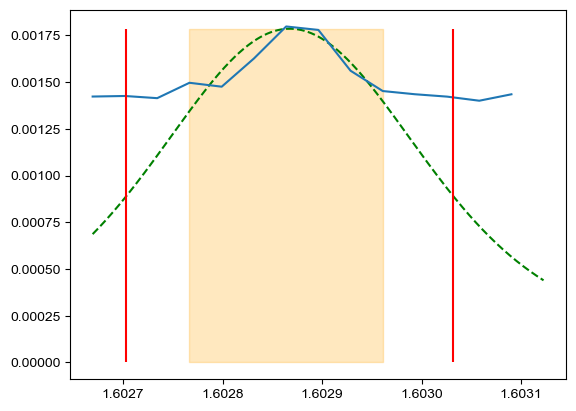

In [215]:
# wco2
FWHM_array_wco2 = np.zeros((A_wco2.shape[0], A_wco2.shape[1]))

start, end = 351, 364+1
wl = lam[:, :, 1]
plt_test = 0



for i in range(A_wco2.shape[0]):
    for fp in range(8):
        max_ind = np.argmax((A_wco2[i, fp, start:end]))
        half_interval = 4
        part_start, part_end = start+max_ind-3, start+max_ind+3+1
        if (A_wco2[i , fp, part_start:part_end]<5e-4).all():
            FWHM_array_wco2[i,fp] = np.nan
        else:
            try:
                popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 1], A_wco2[i , fp, part_start:part_end],
                                       p0=[1.60285, 1e-5, 1e-5, 1e5],
                                       bounds=([1.60275, 1e-6, 1e-6, 1e3], 
                                               [1.60295, 1e-4, 1e-4, 1e8]),
                                       max_nfev=5000)
                wvl_linspace = np.linspace(lam[fp, start, 1], lam[fp, end, 1], 401)

                max_ind = np.argmax((A_wco2[i,fp,start:end]))

                A_min = 0
                A_max = V0(popt[0], *popt)
                hm = (A_max-A_min)/2+A_min

                xx = wvl_linspace
                yy = V0(wvl_linspace, *popt)

                yy_max_ind = np.argmax(yy)

                xx_l = xx[:yy_max_ind]
                yy_l = yy[:yy_max_ind]
                hm_ind_l = np.argmin(np.abs(yy_l-hm))

                xx_r = xx[yy_max_ind-1:]
                yy_r = yy[yy_max_ind-1:]
                hm_ind_r = np.argmin(np.abs(yy_r-hm))


                FWHM = np.abs(xx_r[hm_ind_r]-xx_l[hm_ind_l])*1e3 # to nm
                FWHM_array_wco2[i,fp] = FWHM

                if FWHM < 0.05:
                    FWHM_array_wco2[i,fp] = np.nan
                    plt.clf()
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)
                    #plt.vlines(wl[fp, start+max_ind], 0, A[i,fp,max_ind+start],'green')
                    plt.plot(wl[fp, start:end], A_wco2[i,fp,start:end])
                    plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--')
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 1], lam[fp, part_end-1, 1], color='orange', alpha=0.25)
                    plt.show()
                if FWHM >= 0.22 and plt_test<25:
                    print('-'*15)
                    print('plt_test:', plt_test)
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)

                    plt.clf()
                    plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--')
                    plt.plot(wl[fp, start:end], A_wco2[i,fp,start:end])
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 1], lam[fp, part_end-1, 1], color='orange', alpha=0.25)
                    plt.show()

                    plt_test += 1
            except:
                FWHM_array_wco2[i,fp] = np.nan
            #print(f'{FWHM:.3f}', 'nm')

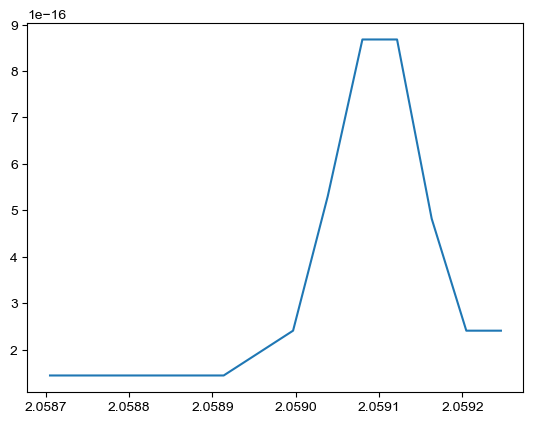

[2.06165490e+00 5.57198854e-05 6.71807100e-05 1.29198332e+06]
center: 0.002783160326898424
0.001391580163449212
0.1987160222598483 nm


Text(0.5, 1.0, 'SCO2 band')

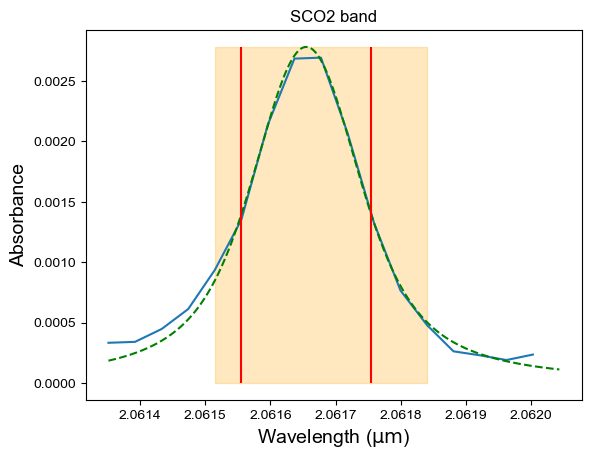

In [182]:
#sco2

plt.plot(lam[fp, start:end, 2], A_sco2[i , fp, start:end])
plt.show()

start, end = 418, 434+1
i = 4200
fp = 0

max_ind = np.argmax((A_sco2[i, fp, start:end]))
half_interval = 4
part_start, part_end = start+max_ind-4, start+max_ind+4+1

plt.plot(lam[fp, start:end, 2], A_sco2[i , fp, start:end])
popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 2], A_sco2[i , fp, part_start:part_end], 
                       p0=[2.0617, 1e-4, 1e-4, 1e5],
                       bounds=([2.0616, 1e-6, 1e-6, 1e3], 
                               [2.0618, 1e-3, 1e-3, 1e8]),
                       max_nfev=5000)
print(popt)
wvl_linspace = np.linspace(lam[fp, start, 2], lam[fp, end, 2], 401)
plt.plot(wvl_linspace, V0(wvl_linspace, *popt), 'g--',)

print('center:', V0(popt[0], *popt))


max_ind = np.argmax((A_sco2[i, fp, start:end]))
A_min = 0
A_max = V0(popt[0], *popt)
hm = (A_max-A_min)/2+A_min
print(hm)



xx = wvl_linspace
yy = V0(wvl_linspace, *popt)


hm_ind = np.argsort(np.abs(yy-hm))[:2]
plt.vlines(xx[hm_ind], 0, A_max, 'r')
FWHM = np.abs(xx[hm_ind[0]]-xx[hm_ind[1]])
plt.fill_betweenx([0, hm*2], lam[fp, part_start, 2], lam[fp, part_end-1, 2], color='orange', alpha=0.25)
#plt.xlim(0.762, 0.765)
print(FWHM*1e3, 'nm')
plt.xlabel('Wavelength ($\mathrm{\mu m}$)', fontsize=14)
plt.ylabel('Absorbance', fontsize=14)
plt.title('SCO2 band')

---------------
i, fp: 1238 2
A max: 0.0012933259036303911
A min: 0
[2.06164886e+00 1.11250983e-04 1.34368204e-04 1.39093824e+06]
0.3989838474094398


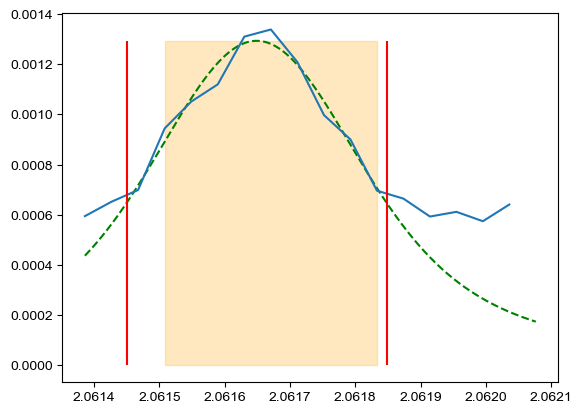

---------------
i, fp: 7799 1
A max: 0.0004985644421205922
A min: 0
[2.06166950e+00 7.73619491e-05 1.68787578e-04 3.36740998e+06]
0.40085319835725386


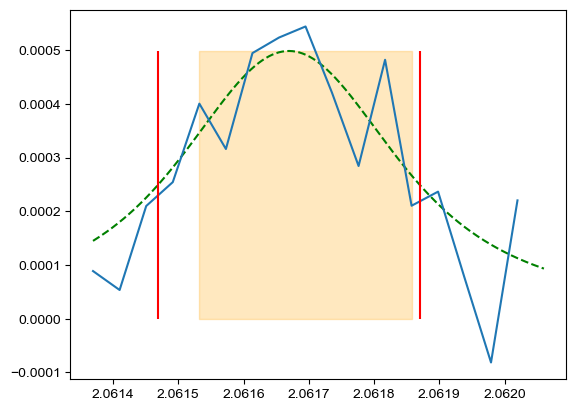

---------------
i, fp: 7802 6
A max: 0.0005525818829598096
A min: 0
[2.06168854e+00 1.06422968e-04 1.87025496e-04 2.61768150e+06]
0.47478746477880307


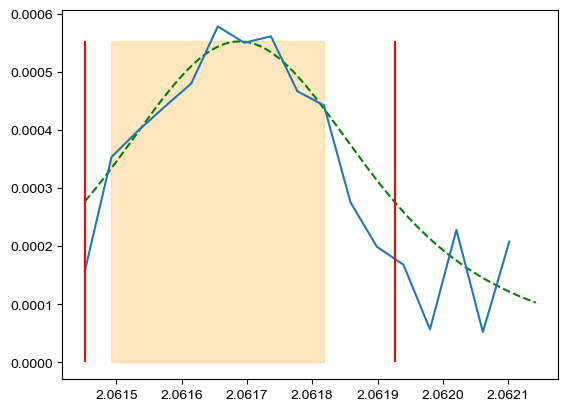

---------------
i, fp: 8073 0
A max: 0.0013569796624478888
A min: 0
[2.06168469e+00 7.95712771e-06 2.00598056e-04 1.16804218e+06]
0.40261594075241547


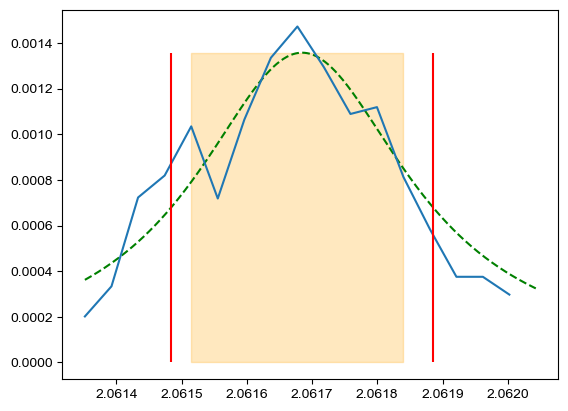

---------------
i, fp: 8073 4
A max: 0.007516328005377765
A min: 0
[2.06165155e+00 3.24191650e-06 1.91485052e-04 2.21115800e+05]
0.38337244115549396


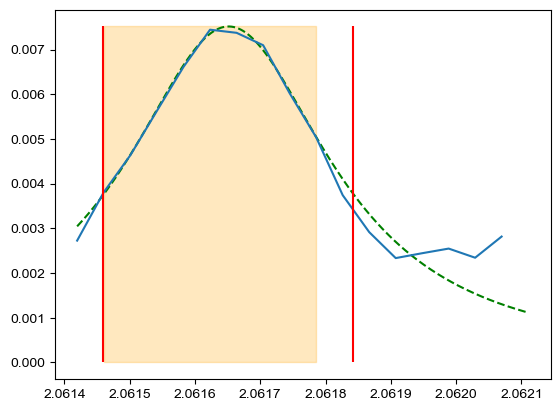

---------------
i, fp: 8074 0
A max: 0.0009343716060920197
A min: 0
[2.06166055e+00 1.49604503e-04 7.39387895e-05 2.23140360e+06]
0.3853362866430565


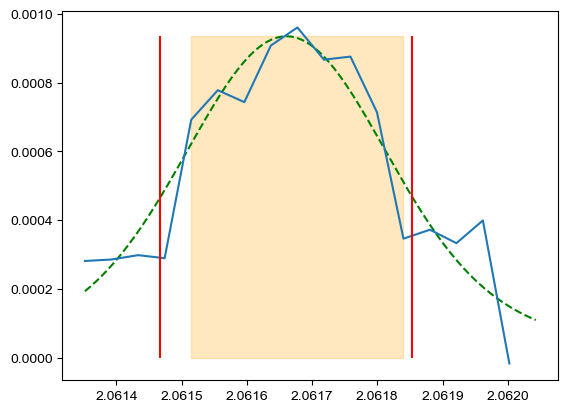

---------------
i, fp: 8075 4
A max: 0.0014108450658573504
A min: 0
[2.06165440e+00 5.71698995e-05 1.78470589e-04 1.18615237e+06]
0.39373385848406883


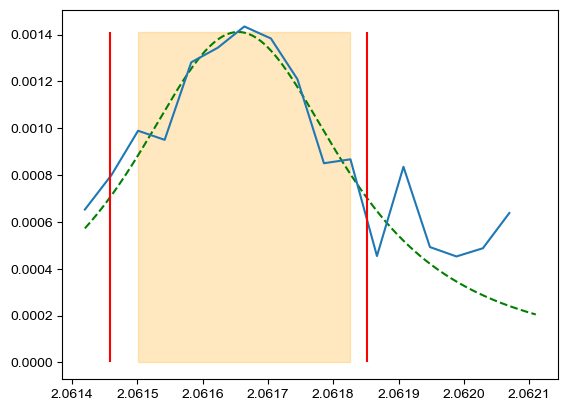

---------------
i, fp: 8076 2
A max: 0.0009724213546533454
A min: 0
[2.06163316e+00 7.91204979e-05 2.14741519e-04 1.40562475e+06]
0.48534398754140895


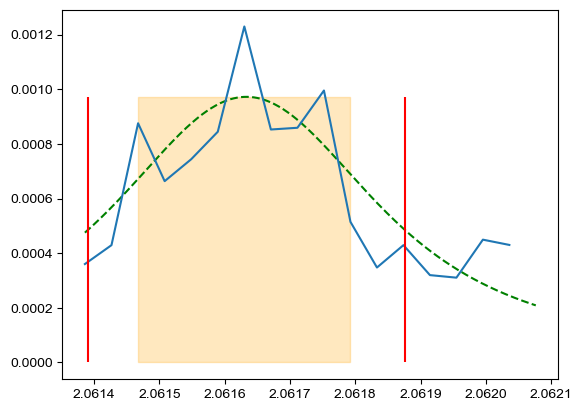

---------------
i, fp: 8076 3
A max: 0.0005773791788023741
A min: 0
[2.06162142e+00 1.81461714e-04 4.40989986e-05 3.61864156e+06]
0.41099698749080815


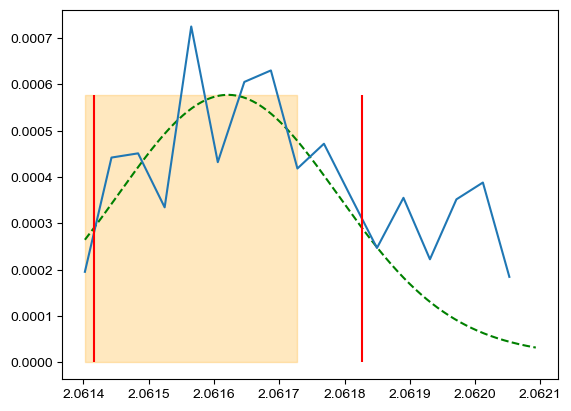

---------------
i, fp: 8077 6
A max: 0.004312963306513052
A min: 0
[2.06165356e+00 1.58800495e-06 2.03643575e-04 3.62397008e+05]
0.40572746990186204


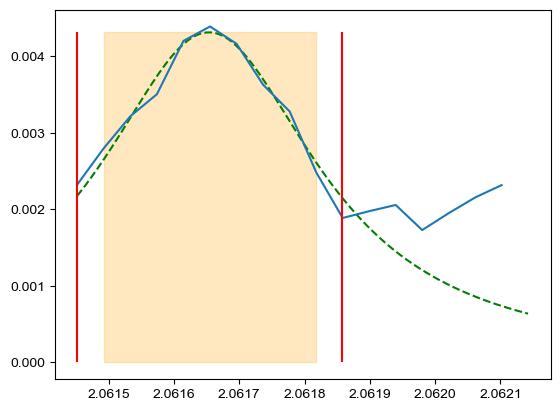

---------------
i, fp: 8078 3
A max: 0.0014443729429341357
A min: 0
[2.06168055e+00 2.35036836e-04 1.03087490e-06 1.37795539e+06]
0.47143772094537795


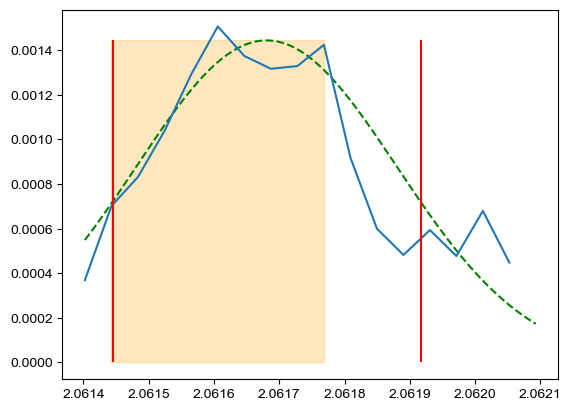

---------------
i, fp: 8112 1
A max: 0.00557377191696165
A min: 0
[2.06165187e+00 4.68007509e-05 1.78509339e-04 3.05974280e+05]
0.3818472277452578


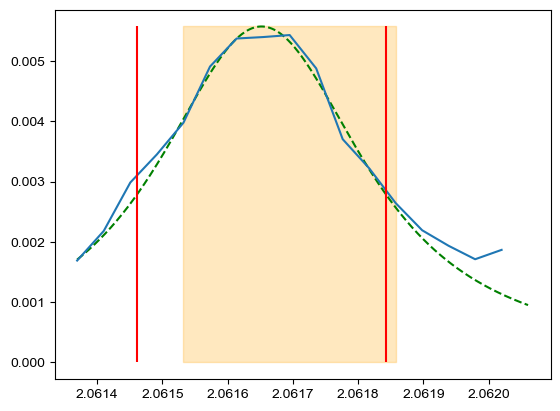

---------------
i, fp: 8113 1
A max: 0.0006790535919498932
A min: 0
[2.06165553e+00 1.00518470e-04 1.82930154e-04 2.19608858e+06]
0.45959892570301975


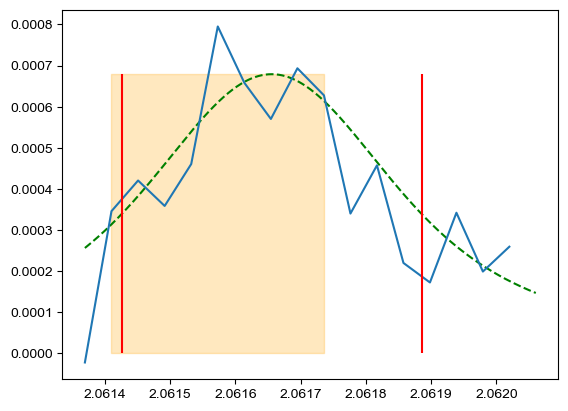

---------------
i, fp: 8113 3
A max: 0.004228450784906003
A min: 0
[2.06165435e+00 1.34214275e-04 1.01116493e-04 4.60057196e+05]
0.39372820650385165


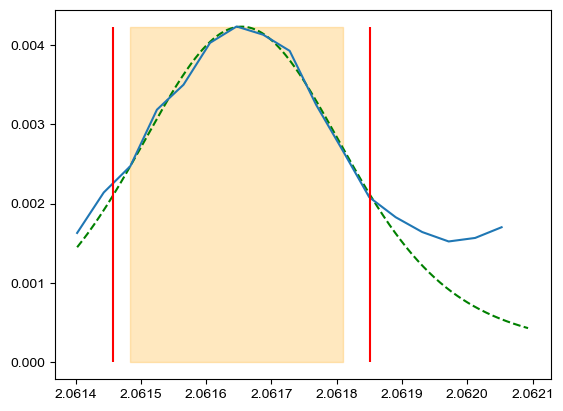

---------------
i, fp: 8114 1
A max: 0.0006024847833276495
A min: 0
[2.06164156e+00 1.24124776e-05 1.97783850e-04 2.66371654e+06]
0.3973975673368102


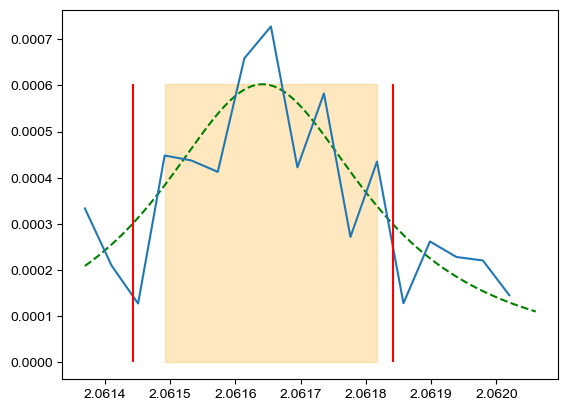

---------------
i, fp: 8114 3
A max: 0.0013981246173565003
A min: 0
[2.06164680e+00 1.08312381e-04 1.37081778e-04 1.28211954e+06]
0.39890884080007183


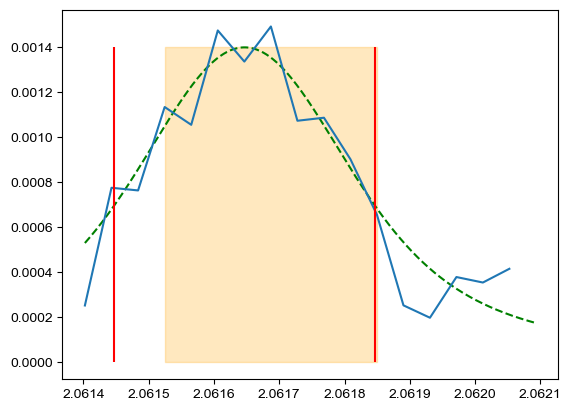

---------------
i, fp: 8115 0
A max: 0.0011902576341633652
A min: 0
[2.06163291e+00 1.54291894e-04 8.36128470e-05 1.64105359e+06]
0.40779983698513433


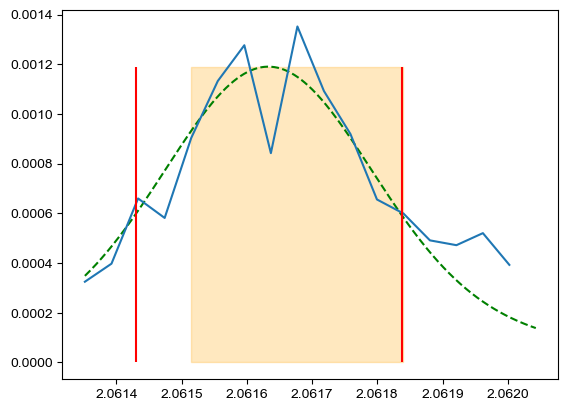

---------------
i, fp: 8115 2
A max: 0.0017474865846535338
A min: 0
[2.06165327e+00 2.71992197e-06 2.22790345e-04 8.17510295e+05]
0.4456183230807653


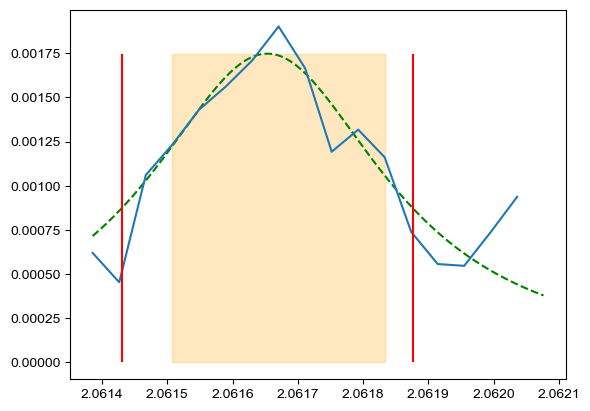

---------------
i, fp: 8116 0
A max: 0.001512698074981807
A min: 0
[2.06165790e+00 4.19559920e-05 1.96413891e-04 1.03908527e+06]
0.41125576780665085


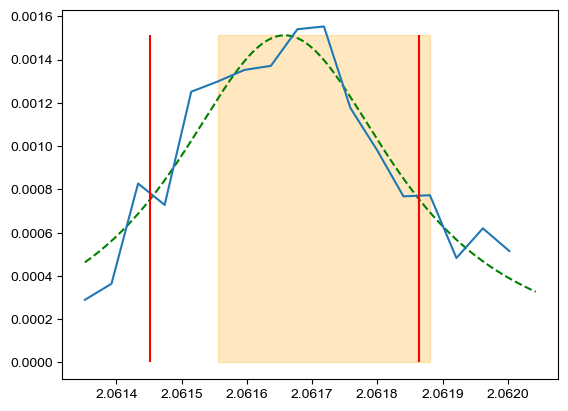

---------------
i, fp: 8117 1
A max: 0.0041448642800721155
A min: 0
[2.06166419e+00 7.80317897e-05 1.71119020e-04 3.99908287e+05]
0.40603664488747526


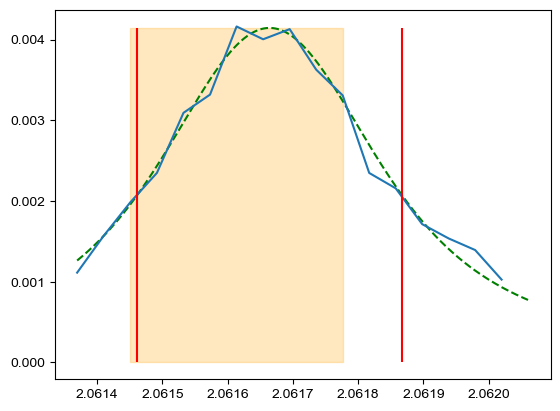

---------------
i, fp: 8119 6
A max: 0.014875340419716094
A min: 0
[2.06165032e+00 1.71237090e-04 3.57322318e-05 1.53169927e+05]
0.3832829715664232


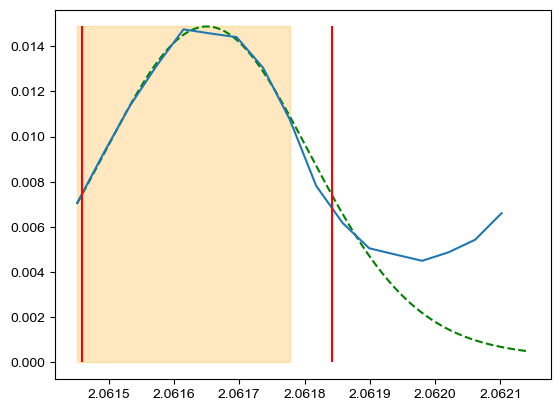

---------------
i, fp: 8120 2
A max: 0.0056229519923536204
A min: 0
[2.06165222e+00 1.91534859e-04 1.00000000e-06 4.34008715e+05]
0.38516622498852016


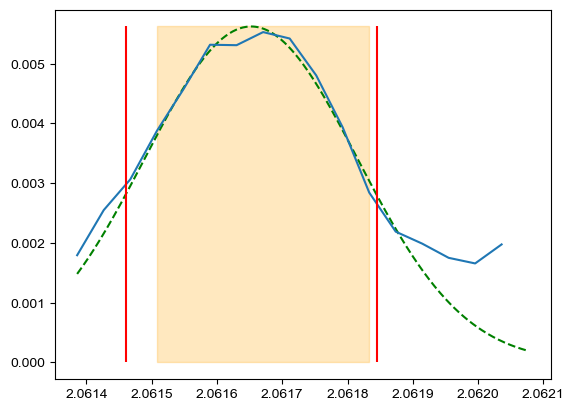

---------------
i, fp: 8138 0
A max: 0.02005531344465083
A min: 0
[2.06165298e+00 1.02205742e-05 1.96488170e-04 8.06196174e+04]
0.393976113697736


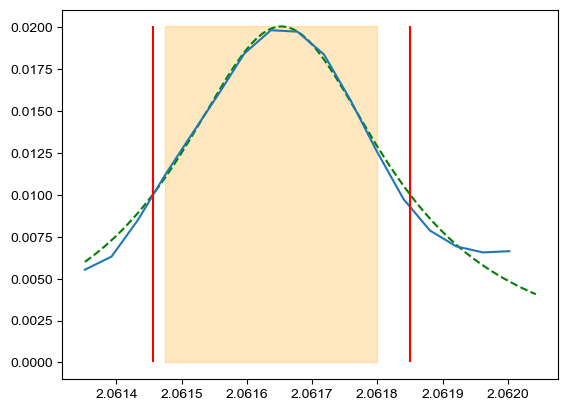

---------------
i, fp: 8139 7
A max: 0.0071394245413421995
A min: 0
[2.06164436e+00 4.50116339e-05 1.94122398e-04 2.21642652e+05]
0.3814738600094181


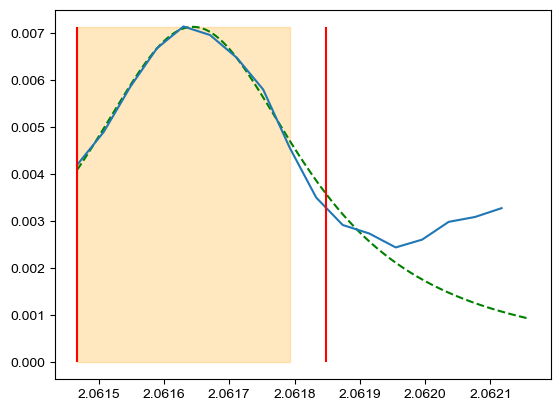

---------------
i, fp: 8141 0
A max: 0.006285543425305832
A min: 0
[2.06165209e+00 1.32502295e-04 1.09670681e-04 2.99047651e+05]
0.4008879753412131


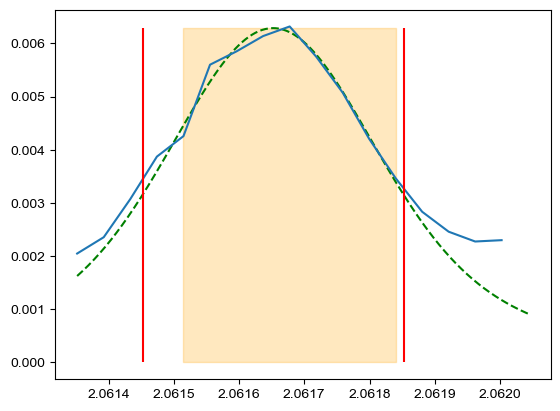

In [183]:
# sco2
FWHM_array_sco2 = np.zeros((A_sco2.shape[0], A_sco2.shape[1]))

start, end = 418, 434+1
wl = lam[:, :, 2]
plt_test = 0
for i in range(A_sco2.shape[0]):
    for fp in range(8):
        max_ind = np.argmax((A_sco2[i, fp, start:end]))
        half_interval = 4
        part_start, part_end = start+max_ind-4, start+max_ind+4+1
        if (A_sco2[i , fp, start:end]<5e-4).all():
            FWHM_array_sco2[i,fp] = np.nan
        else:
            try:
                popt, pcov = curve_fit(V0, lam[fp, part_start:part_end, 2], A_sco2[i , fp, part_start:part_end],
                                       p0=[2.0617, 1e-4, 1e-4, 1e5],
                                       bounds=([2.0616, 1e-6, 1e-6, 1e3], 
                                               [2.0618, 1e-3, 1e-3, 1e8]),
                                       max_nfev=5000)
                wvl_linspace = np.linspace(lam[fp, start, 2], lam[fp, end, 2], 401)

                max_ind = np.argmax((A_sco2[i,fp,start:end]))

                A_min = 0
                A_max = V0(popt[0], *popt)
                hm = (A_max-A_min)/2+A_min

                xx = wvl_linspace
                yy = V0(wvl_linspace, *popt)

                yy_max_ind = np.argmax(yy)

                xx_l = xx[:yy_max_ind]
                yy_l = yy[:yy_max_ind]
                hm_ind_l = np.argmin(np.abs(yy_l-hm))

                xx_r = xx[yy_max_ind-1:]
                yy_r = yy[yy_max_ind-1:]
                hm_ind_r = np.argmin(np.abs(yy_r-hm))


                FWHM = np.abs(xx_r[hm_ind_r]-xx_l[hm_ind_l])*1e3 # to nm
                FWHM_array_sco2[i,fp] = FWHM

                if FWHM < 0.005:
                    plt.clf()
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)
                    #plt.vlines(wl[fp, start+max_ind], 0, A[i,fp,max_ind+start],'green')
                    plt.plot(wl[fp, start:end], A_sco2[i,fp,start:end])
                    plt.plot(wvl_linspace, yy, 'g--')
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 2], lam[fp, part_end-1, 2], color='orange', alpha=0.25)
                    plt.show()
                if FWHM >= 0.38 and plt_test<25:
                    print('-'*15)
                    print('i, fp:', i, fp)
                    print('A max:', A_max)
                    print('A min:', A_min)
                    print(popt)
                    print(FWHM)

                    plt.clf()
                    plt.plot(wvl_linspace, yy, 'g--')
                    plt.plot(wl[fp, start:end], A_sco2[i,fp,start:end])
                    plt.vlines(xx_r[hm_ind_r], 0, hm*2, 'r')
                    plt.vlines(xx_l[hm_ind_l], 0, hm*2, 'r')
                    plt.fill_betweenx([0, hm*2], lam[fp, part_start, 2], lam[fp, part_end-1, 2], color='orange', alpha=0.25)
                    plt.show()

                    plt_test += 1
            except:
                FWHM_array_sco2[i,fp] = np.nan
            #print(f'{FWHM:.3f}', 'nm')

In [210]:
"""
Original
"""
FWHM_array = np.zeros((A.shape[0], A.shape[1]))

start, end = 270, 285+1
wl = lam[:, :, 0]

for i in range(A.shape[0]):
    for fp in range(8):
        try:
            max_ind = np.argmax((A[i,fp,start:end]))
            hm = A[i,fp,max_ind+start]/2
            
            max_ind = np.argmax((A[i, fp, start:end]))
            A_min = np.mean((A[i, fp, start], A[i, fp, end-1]))
            A_max = A[i, fp, max_ind+start]
            hm = (A_max-A_min)/2+A_min



            f_l = interpolate.interp1d(wl[fp, start:start+max_ind], A[i,fp,start:start+max_ind], fill_value="extrapolate")
            xx_l = np.linspace(wl[fp, start], wl[fp, start+max_ind-1], 101)
            yy_l = f_l(xx_l)
            hm_ind_l = np.argmin(np.abs(yy_l-hm))

            f_r = interpolate.interp1d(wl[fp, start+max_ind:end], A[i,fp,start+max_ind:end], fill_value="extrapolate")
            xx_r = np.linspace(wl[fp, start+max_ind], wl[fp, end-1], 101)
            yy_r = f_r(xx_r)
            hm_ind_r = np.argmin(np.abs(yy_r-hm))


            FWHM = np.abs(xx[hm_ind_r]-xx[hm_ind_l])*1e3 # to nm
            FWHM_array[i,fp] = FWHM

            if FWHM < 0.003:
                plt.clf()
                plt.vlines(wl[fp, start+max_ind], 0, A[i,fp,max_ind+start],'green')
                plt.plot(wl[fp, start:end], A[i,fp,start:end])
                plt.vlines(xx[hm_ind], 0, hm*2, 'r')
                plt.show()
            
        except:
            FWHM_array[i,fp] = np.nan
        #print(f'{FWHM:.3f}', 'nm')

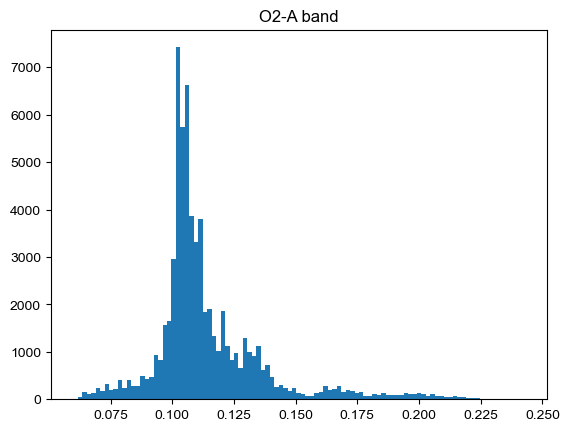

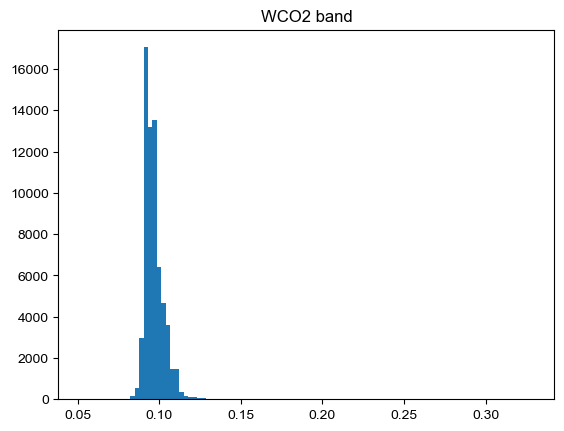

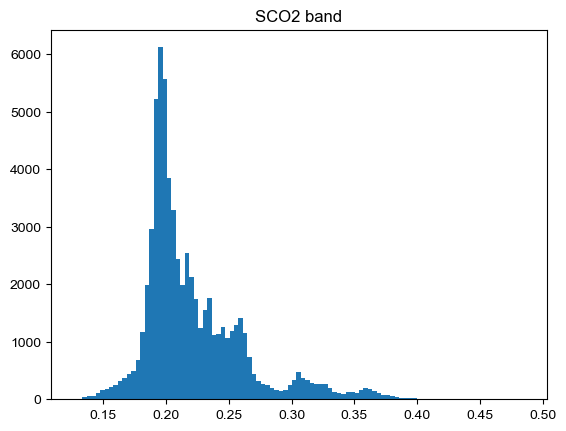

In [184]:
plt.hist(FWHM_array.flatten(), bins=101)
plt.title('O2-A band')
plt.show()

plt.hist(FWHM_array_wco2.flatten(), bins=101)
plt.title('WCO2 band')
plt.show()

plt.hist(FWHM_array_sco2.flatten(), bins=101)
plt.title('SCO2 band')
plt.show()

In [72]:
plt.hist(xco2_array.flatten(), bins=101)
plt.show()

NameError: name 'xco2_array' is not defined

In [87]:
png       = ['../simulation/data/20181018_central_asia_2_470cloud_test2_20181018/aqua_rgb_2018-10-18_55.00-55.60-33.70-34.45.png',
             [55.00, 55.60, 33.70, 34.45]]
img = png[0]
wesn= png[1]

In [77]:
png       = ['../simulation/data/20181018_1_20181018/aqua_rgb_2018-10-18_55.40-55.95-32.30-33.20.png',
             [55.40, 55.95, 32.30, 33.2]]
img = png[0]
wesn= png[1]

In [235]:
png       = ['../simulation/data/20181018_central_asia_2_470cloud_test0320_20181018/aqua_rgb_2018-10-18_51.85-58.15-27.85-37.15.png',
             [51.85,58.15,27.85,37.15]]
img = png[0]
wesn= png[1]

In [52]:
litefile = '../dat/oco2_LtCO2_181018_B10206Ar_200730042453s.nc4'
lite = xr.open_dataset(litefile)
lite_snd = xr.open_dataset(litefile, group='Sounding')

In [53]:
xco2 = l2["RetrievalResults"]['xco2']

In [200]:
lon_w, lon_e = wesn[0], wesn[1]
lat_s, lat_n = wesn[2], wesn[3]
lon_range = np.logical_and(lite.longitude >= lon_w, lite.longitude <= lon_e)
lat_range = np.logical_and(lite.latitude >= lat_s, lite.latitude <= lat_n)

select = np.where(np.logical_and(lon_range, lat_range))
lite_snd_list = np.array(lite.sounding_id[select], dtype=np.int)

In [55]:
xco2_array = np.zeros((A.shape[0], A.shape[1]))
qf_array = np.zeros((A.shape[0], A.shape[1], 3))
alt_array = np.zeros((A.shape[0], A.shape[1]), dtype=float)
qf_lon, qf_lat = np.zeros((A.shape[0], A.shape[1])), np.zeros((A.shape[0], A.shape[1]))
# qf, qf_bitflag, qf_simpleflag\
for i in range(A.shape[0]):
    for j in range(A.shape[1]):
        snd = snd_id[i, j]
        #print('-'*15)
        #print(snd)
        if snd in lite_snd_list:
            index = np.where(lite_snd_list == snd)[0][0]

            xco2_quality_flag = np.float(lite.xco2_quality_flag[select][index])
            xco2_qf_bitflag = np.float(lite.xco2_qf_bitflag[select][index])
            xco2_qf_simple_bitflag = np.float(lite.xco2_qf_simple_bitflag[select][index])
            xco2_array[i, j] = np.float(lite.xco2[select][index])
            qf_array[i, j, :] = (xco2_quality_flag, xco2_qf_bitflag, xco2_qf_simple_bitflag)
            qf_lat[i, j] = np.float(lite.latitude[select][index])
            qf_lon[i, j] = np.float(lite.longitude[select][index])
            alt_array[i, j] = np.float(lite_snd.altitude[select][index])
        else:
            xco2_array[i, j] = np.nan
            qf_array[i, j, :] = (np.nan,)*3
            qf_lat[i, j] = np.nan
            qf_lon[i, j] = np.nan
            alt_array[i, j] = np.nan


In [83]:
(qf_array[:,:,0]==0).sum()

1571

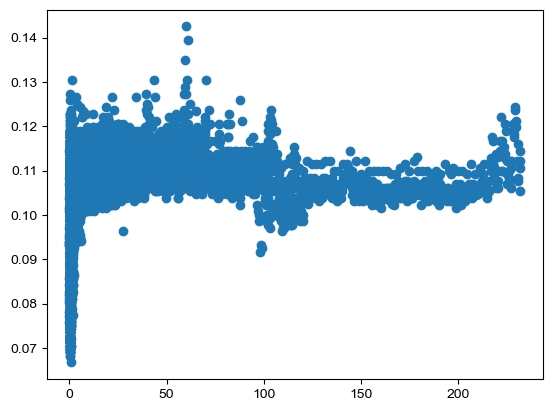

In [56]:
plt.scatter(cloud_dist, FWHM_array)

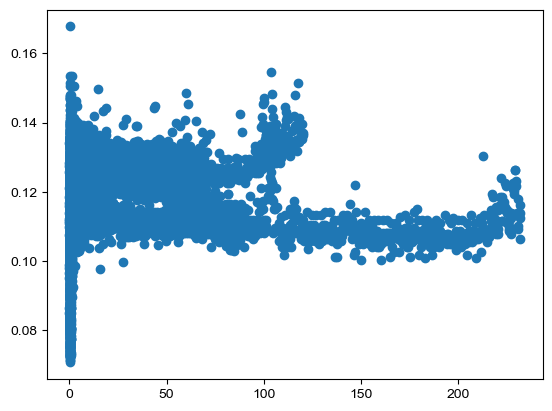

In [217]:
plt.scatter(cloud_dist, FWHM_array/(sfc_p/101325*(296/sfc_T)))

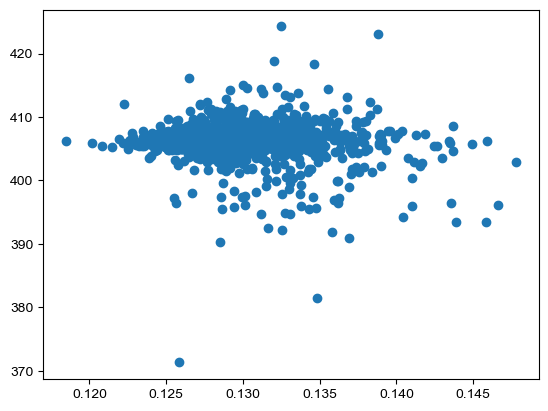

In [57]:
plt.scatter(FWHM_array/(sfc_p/101325*(296/sfc_T)), xco2_array)
plt.show()

In [49]:
(sfc_p<0).sum()

321

In [93]:
from sklearn.linear_model import LinearRegression



In [122]:
X = np.array([FWHM_array/(sfc_p/101325*(296/sfc_T)), 
              FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)), 
              FWHM_array_sco2/(sfc_p/101325*(296/sfc_T))]).reshape(3, -1)
y = xco2_array.flatten()-np.nanmean(xco2_array)
y.shape

(66672,)

array([-0.5706472 , -0.25576683, -0.18130394, ...,  0.50848488,
        0.59222512,  0.63082985])

In [114]:
y[mask].shape

(0,)

In [123]:
mask = ~np.logical_or(np.isnan(X).any(axis=0), np.isnan(y))
reg = LinearRegression().fit(X[:, mask].T, y[mask])

In [124]:
reg.score(X[:, mask].T, y[mask])

0.012283403505178203

In [125]:
reg.coef_

array([-28.93655718, -23.34615829,   2.47573282])

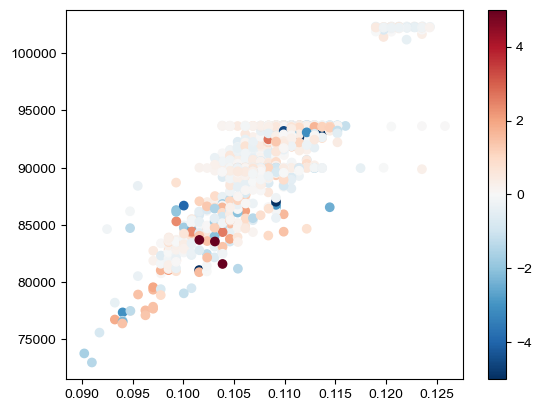

In [185]:
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'same') / w

co2_min_nearby = xco2_array.flatten()-moving_average(xco2_array.flatten(), 9)

plt.scatter(FWHM_array.flatten(), sfc_p.flatten(), c=co2_min_nearby, cmap='RdBu_r',
           vmin=-5, vmax=5)
plt.colorbar()
plt.show()

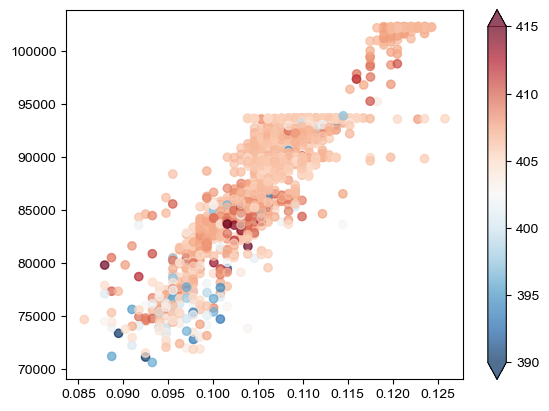

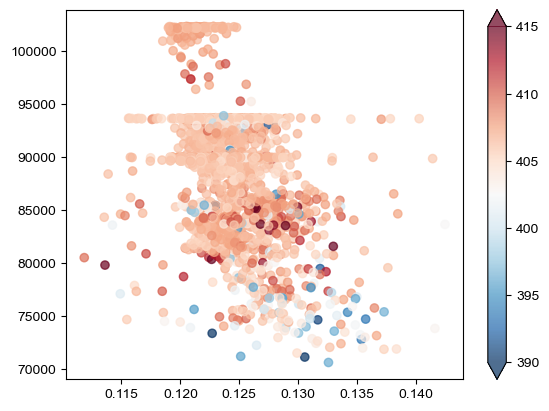

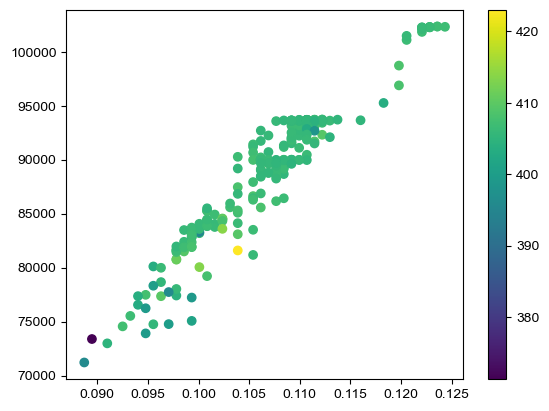

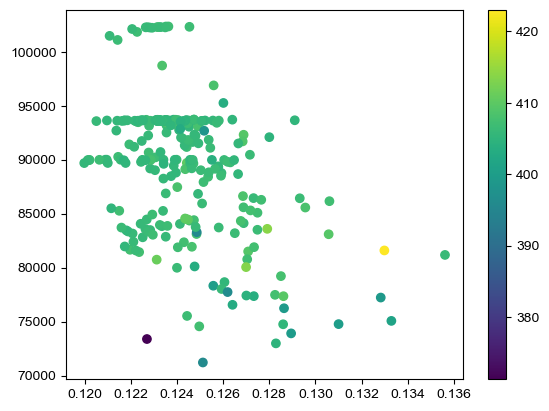

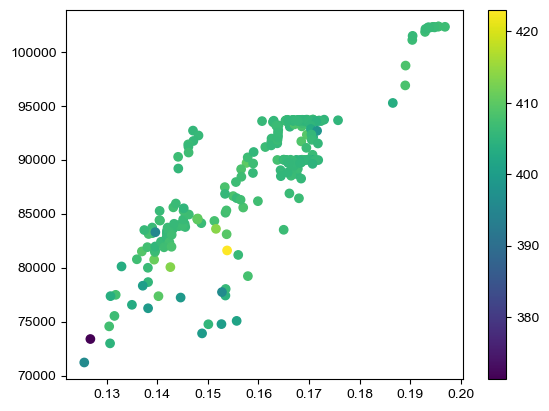

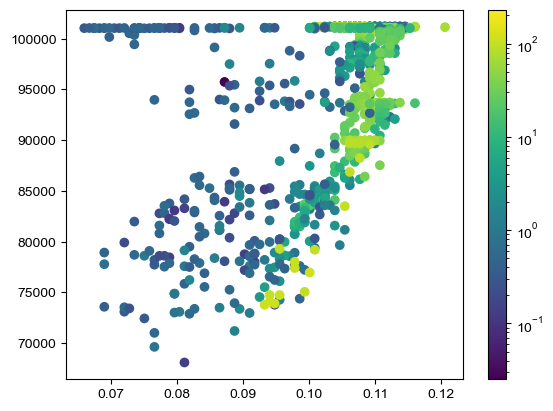

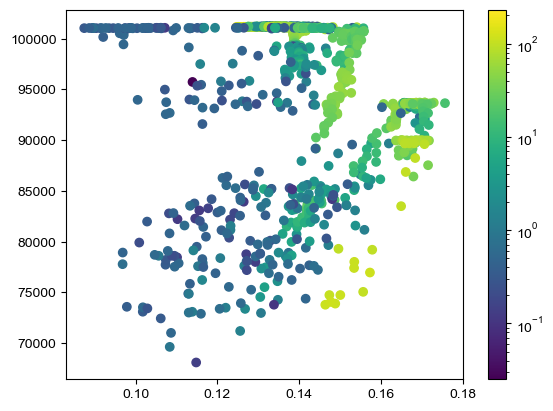

In [186]:
plt.scatter((FWHM_array)[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()

plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()



i = 0
plt.scatter((FWHM_array)[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()


plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()


plt.scatter((FWHM_array/o2a_mu)[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()

plt.scatter((FWHM_array)[:, i], sfc_p[:, i], c=cloud_dist[:, i],
            norm=matplotlib.colors.LogNorm())
plt.colorbar()
plt.show()

plt.scatter((FWHM_array/o2a_mu)[:, i], sfc_p[:, i], c=cloud_dist[:, i],
           norm=matplotlib.colors.LogNorm())
plt.colorbar()
plt.show()

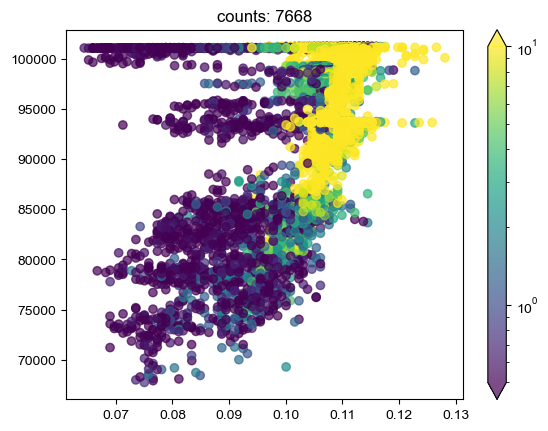

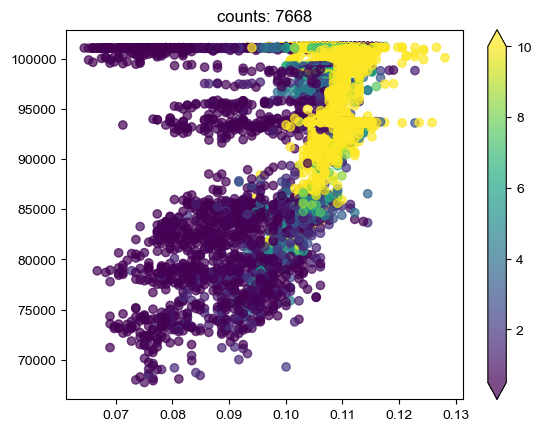

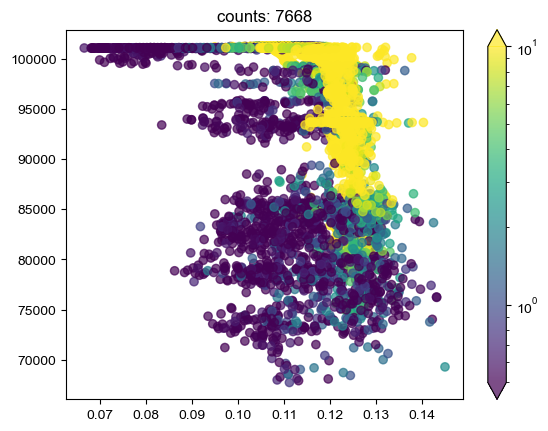

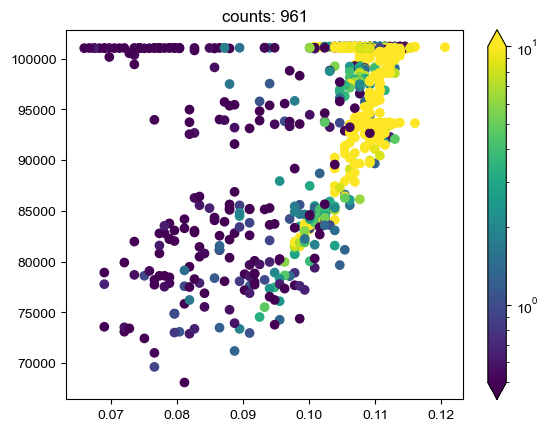

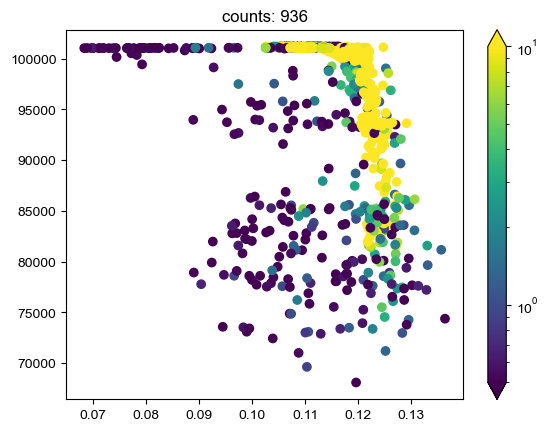

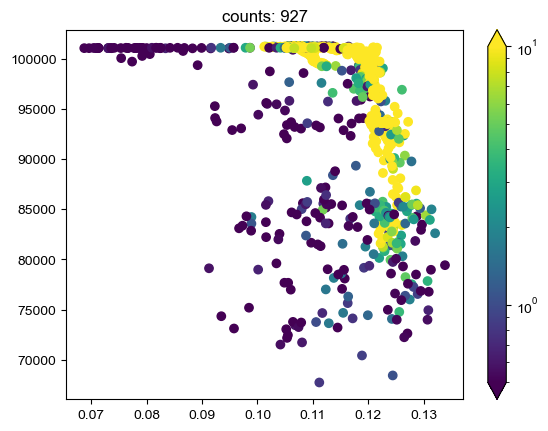

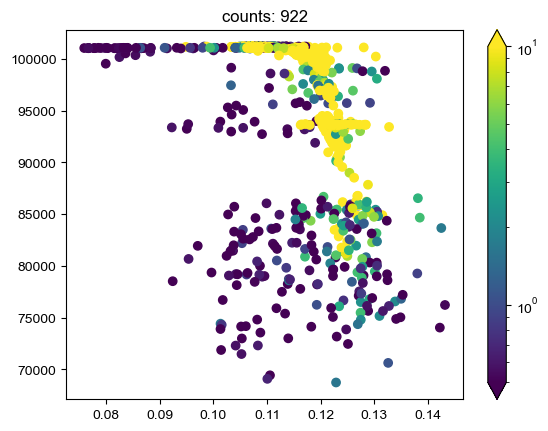

In [187]:
vmin = 0.5
vmax = 10
select = snd_lat<35.5
plt.scatter((FWHM_array)[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax), alpha=0.7)
effective = np.logical_and(np.logical_and((FWHM_array)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

select = snd_lat<35.5
plt.scatter((FWHM_array)[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select],
            vmin=vmin, vmax=vmax, alpha=0.7)
effective = np.logical_and(np.logical_and((FWHM_array)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

select = snd_lat<35.5
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax), alpha=0.7)
effective = np.logical_and(np.logical_and((FWHM_array)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 0
select = snd_lat[:, fp]<35.5
plt.scatter((FWHM_array)[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()



fp = 0
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 3
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 6
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

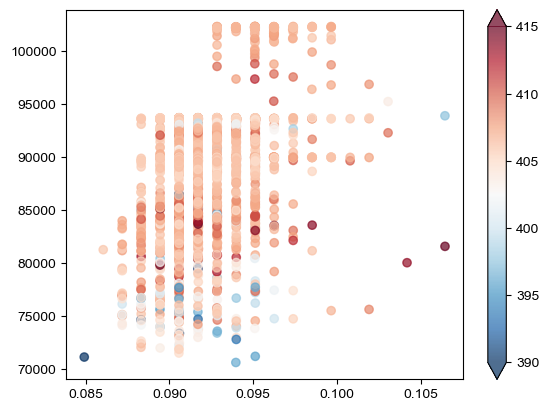

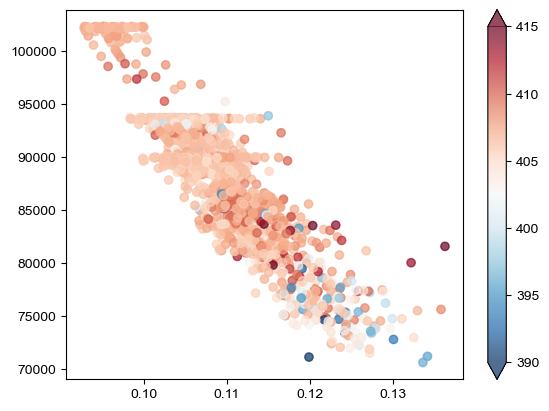

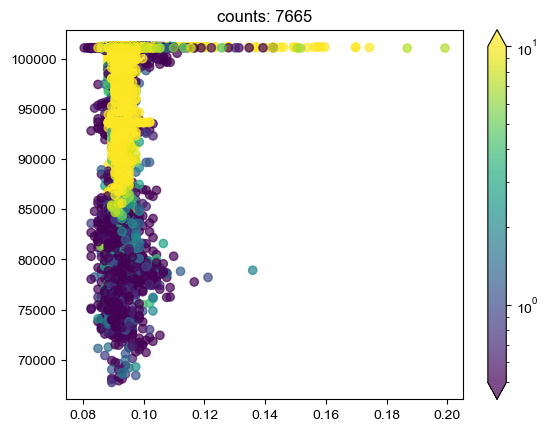

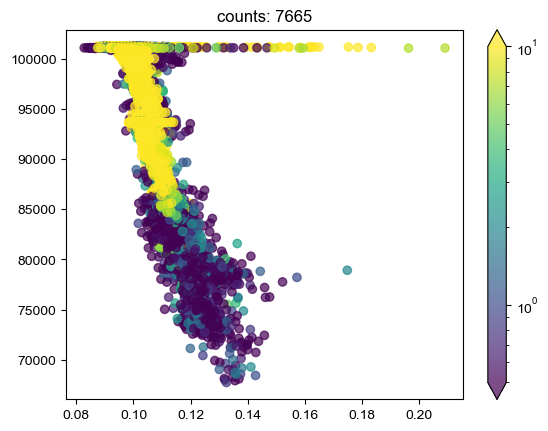

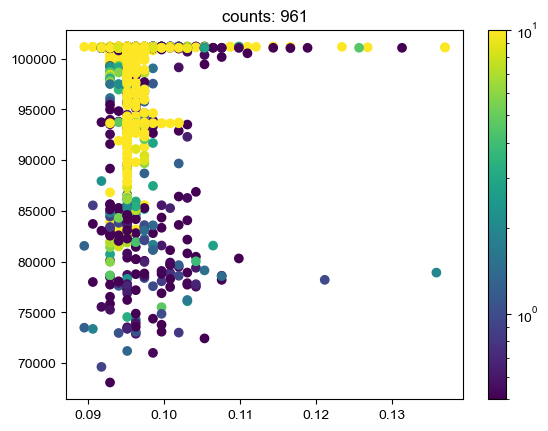

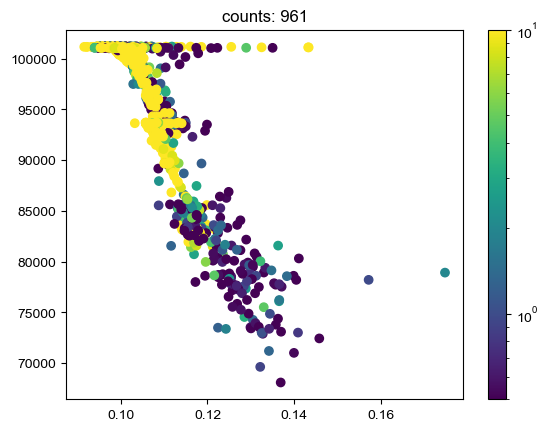

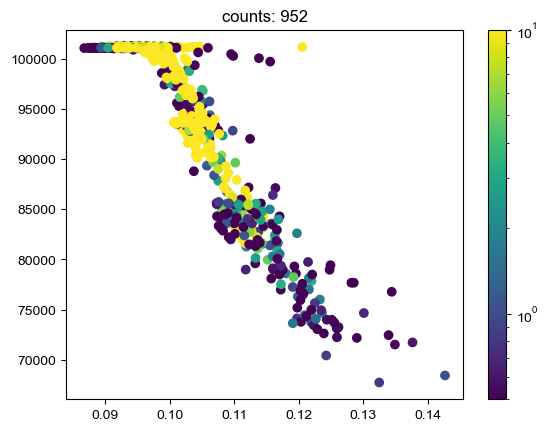

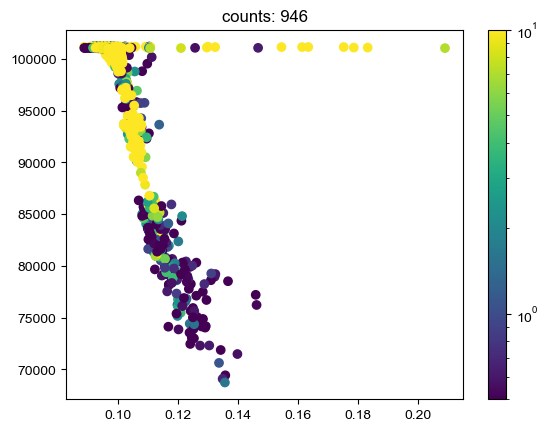

In [198]:
vmin = 0.5
vmax = 10
plt.scatter((FWHM_array_wco2)[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()

plt.scatter((FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)))[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()

select = np.logical_and(snd_lat<35.5, FWHM_array_wco2<0.2)
plt.scatter((FWHM_array_wco2)[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select], alpha=0.7,
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_wco2)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

plt.scatter((FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)))[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select],  alpha=0.7,
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_wco2)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 0
select = np.logical_and(snd_lat[:, fp]<35.5, FWHM_array_wco2[:, fp]<0.2)
plt.scatter((FWHM_array_wco2)[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()



fp = 0
select = np.logical_and(snd_lat[:, fp]<35.5, FWHM_array_wco2[:, fp]<0.2)
plt.scatter((FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 3
select = np.logical_and(snd_lat[:, fp]<35.5, FWHM_array_wco2[:, fp]<0.2)
plt.scatter((FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 6
select = np.logical_and(snd_lat[:, fp]<35.5, FWHM_array_wco2[:, fp]<0.2)
plt.scatter((FWHM_array_wco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()

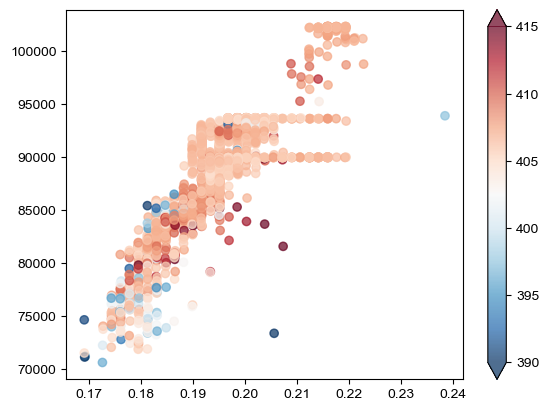

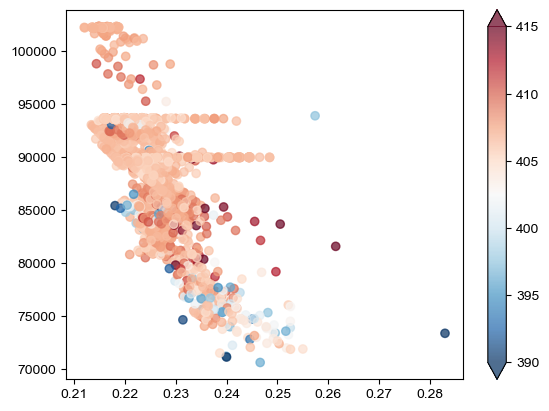

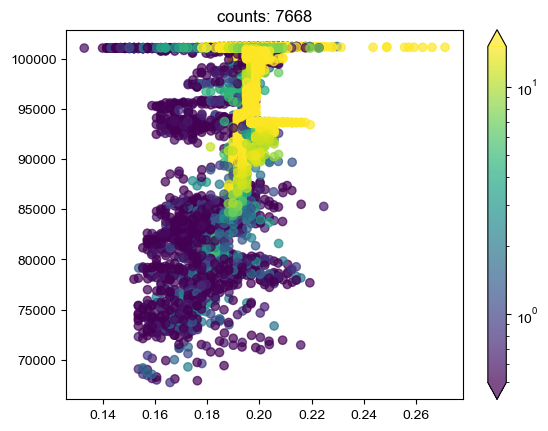

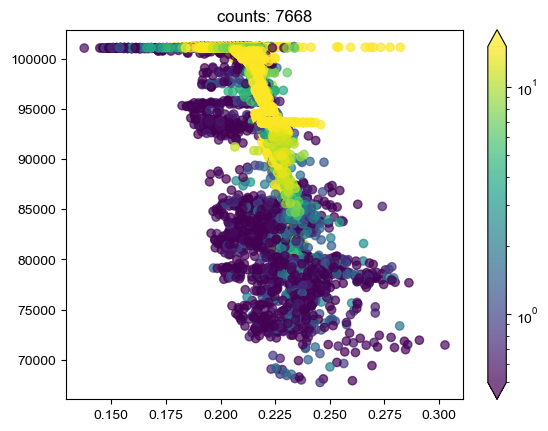

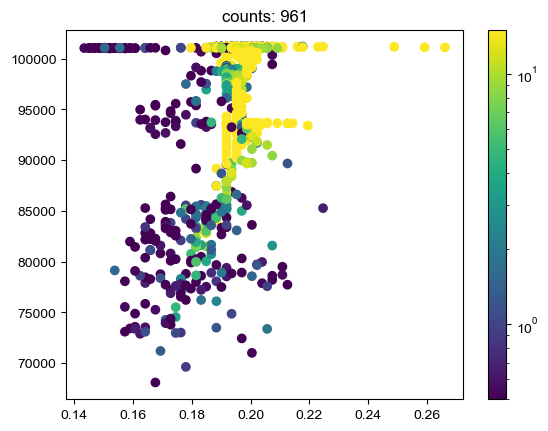

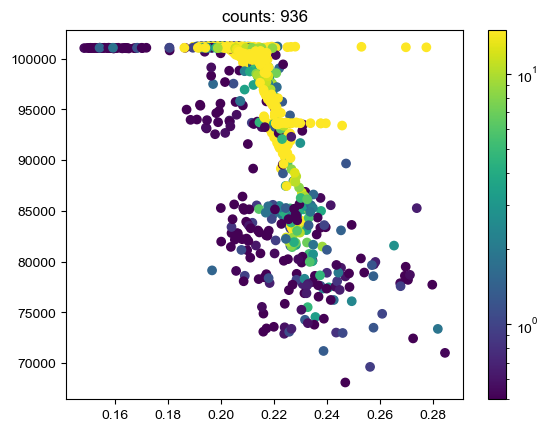

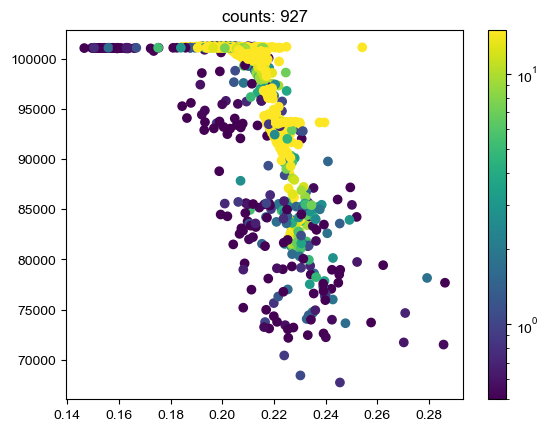

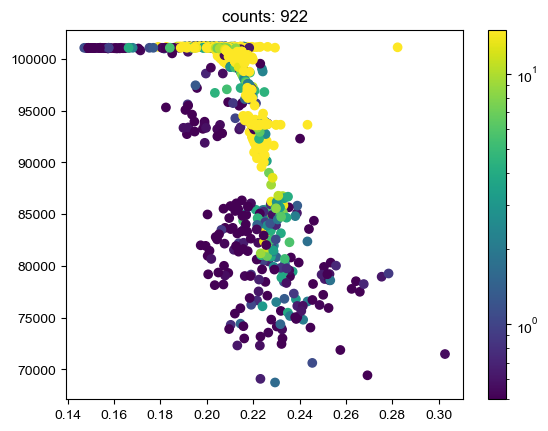

In [197]:
vmax = 15
plt.scatter((FWHM_array_sco2)[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()

plt.scatter((FWHM_array_sco2/(sfc_p/101325*(296/sfc_T)))[:, :], sfc_p[:, :], c=xco2_array[:, :], vmin=390, vmax=415, alpha=0.7, cmap='RdBu_r')
plt.colorbar(extend='both')
plt.show()

select = np.logical_and(snd_lat<35.5, FWHM_array_sco2<0.4)
plt.scatter((FWHM_array_sco2)[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select], alpha=0.7,
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

select = np.logical_and(snd_lat<35.5, FWHM_array_sco2<0.4)
plt.scatter((FWHM_array_sco2/(sfc_p/101325*(296/sfc_T)))[:, :][select], sfc_p[:, :][select], c=cloud_dist[:, :][select], alpha=0.7,
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, :][select]>0, sfc_p[:, :][select]>0),
                           cloud_dist[:, :][select]>0)
plt.colorbar(extend='both')
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 0
select = snd_lat[:, fp]<35.5
plt.scatter((FWHM_array_sco2)[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()



fp = 0
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array_sco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()


fp = 3
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array_sco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()

fp = 6
select = snd_lat[:, fp]<35
plt.scatter((FWHM_array_sco2/(sfc_p/101325*(296/sfc_T)))[:, fp][select], sfc_p[:, fp][select], c=cloud_dist[:, fp][select],
            norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
effective = np.logical_and(np.logical_and((FWHM_array_sco2)[:, fp][select]>0, sfc_p[:, fp][select]>0),
                           cloud_dist[:, fp][select]>0)
plt.colorbar()
plt.title(f'counts: {np.sum(effective)}')
plt.show()

In [422]:


(~np.isnan(xco2_array)).sum()

2236

In [249]:
(~np.isnan(FWHM_array)).sum()

66663

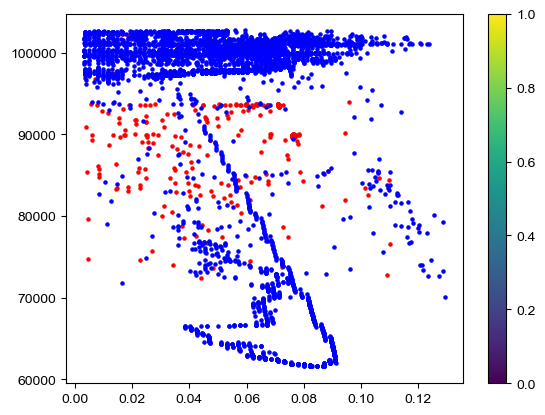

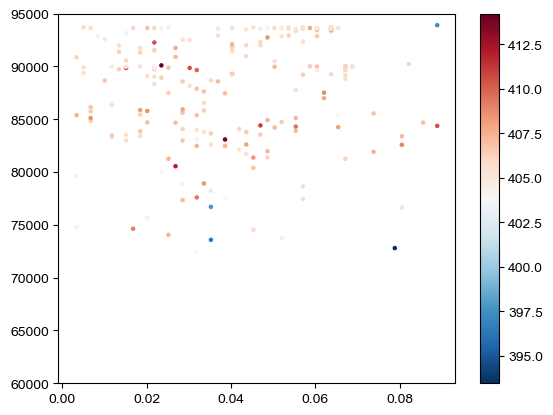

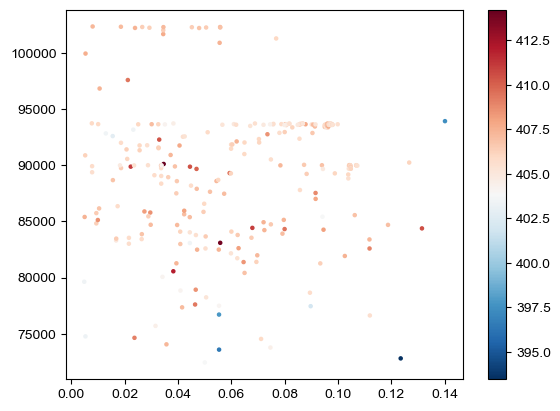

In [423]:
fp = 1
qf_lon_fp = qf_lon[:, fp]
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, fp][qf_lon_fp>0], sfc_p[:, fp][qf_lon_fp>0], c='r', s=5)
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, fp][np.isnan(qf_lon_fp)], sfc_p[:, fp][np.isnan(qf_lon_fp)], c='b', s=5)
plt.colorbar()
plt.show()

#plt.scatter((FWHM_array)[:, fp][np.isnan(qf_lon_fp)], sfc_p[:, fp][np.isnan(qf_lon_fp)], c='b', s=5)
plt.scatter((FWHM_array)[:, fp][qf_lon_fp>0], sfc_p[:, fp][qf_lon_fp>0], c=xco2_array[:, fp][qf_lon_fp>0], s=5, cmap='RdBu_r')

plt.ylim(60000, 95000)
plt.colorbar()

plt.show()

plt.scatter((FWHM_array/o2a_mu)[:, fp][qf_lon_fp>0], sfc_p[:, fp][qf_lon_fp>0], c=xco2_array[:, fp][qf_lon_fp>0], s=5, cmap='RdBu_r')
plt.colorbar()

plt.show()

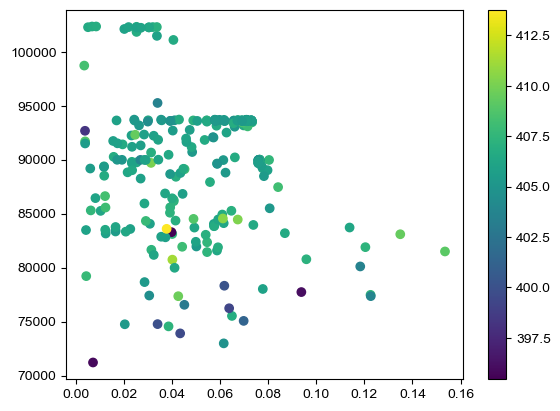

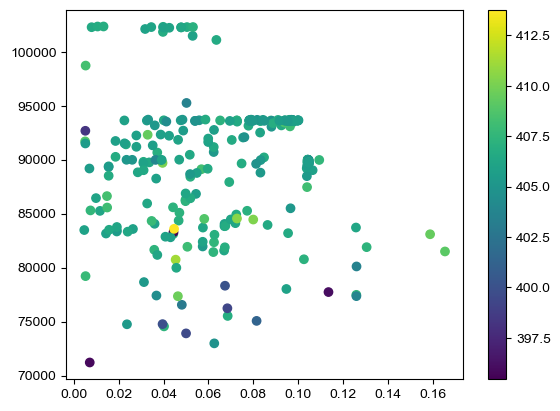

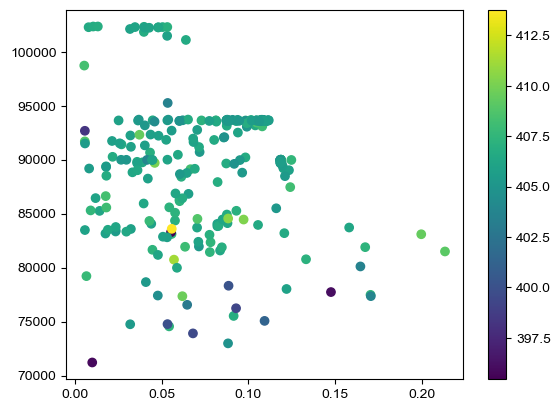

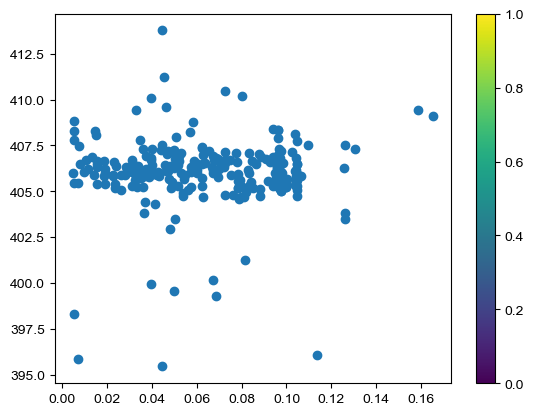

In [424]:
i = 0
plt.scatter((FWHM_array/(sfc_p/101325*(296/sfc_T)))[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()



plt.scatter((FWHM_array/o2a_mu)[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()

plt.scatter((FWHM_array/o2a_mu/(sfc_p/101325*(296/sfc_T)))[:, i], sfc_p[:, i], c=xco2_array[:, i])
plt.colorbar()
plt.show()

plt.scatter((FWHM_array/o2a_mu)[:, i], xco2_array[:, i])
plt.colorbar()
plt.show()

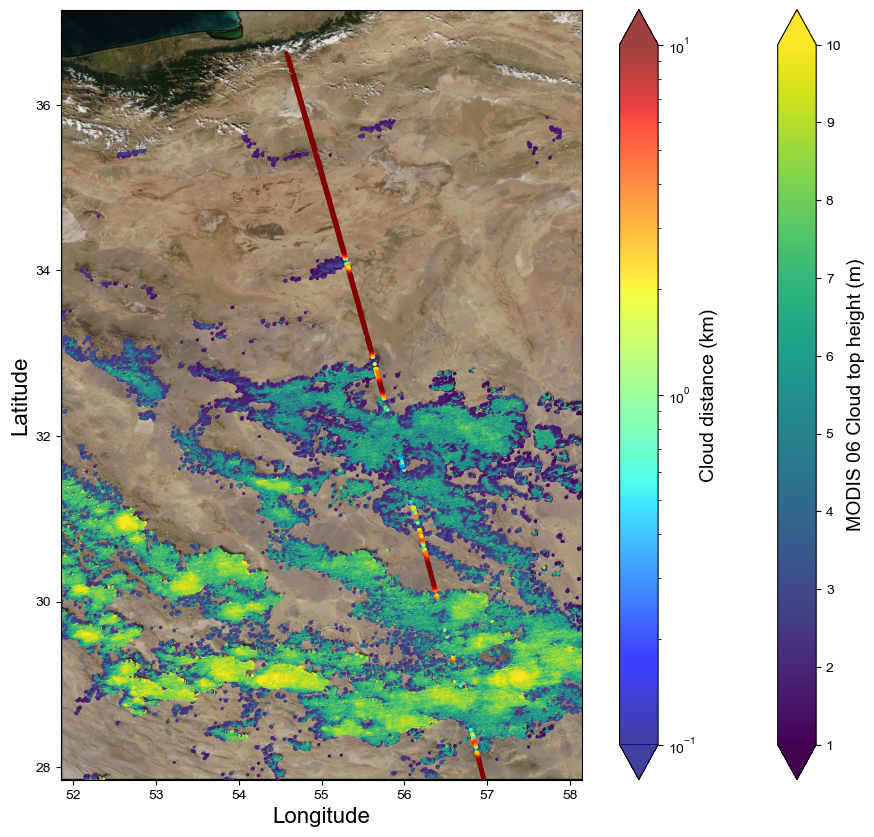

In [432]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))

c0 = frame.scatter(lon[cth0[:]>0], lat[cth0[:]>0], s=2,# cmap='OrRd',
              marker='o', c=cth0[:][cth0[:]>0]/1000,
                   vmin=1, vmax=10, )

cbar0 = f.colorbar(c0, extend='both')
cbar0.set_label('MODIS 06 Cloud top height (m)', fontsize=14)

qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)






c = frame.scatter(qf_lon[:, :], qf_lat[:, :], s=2, cmap='jet',
              marker='o', c=cloud_dist[:, :],
                 norm=matplotlib.colors.LogNorm(vmin=0.1, vmax=10), alpha=0.75)# vmin=0.041, vmax=0.044)


cbar = f.colorbar(c, extend='both')
cbar.set_label('Cloud distance (km)', fontsize=14)

# vmin=0.041, vmax=0.044)


#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude', fontsize=16)
plt.ylabel('Latitude', fontsize=16)

plt.show()



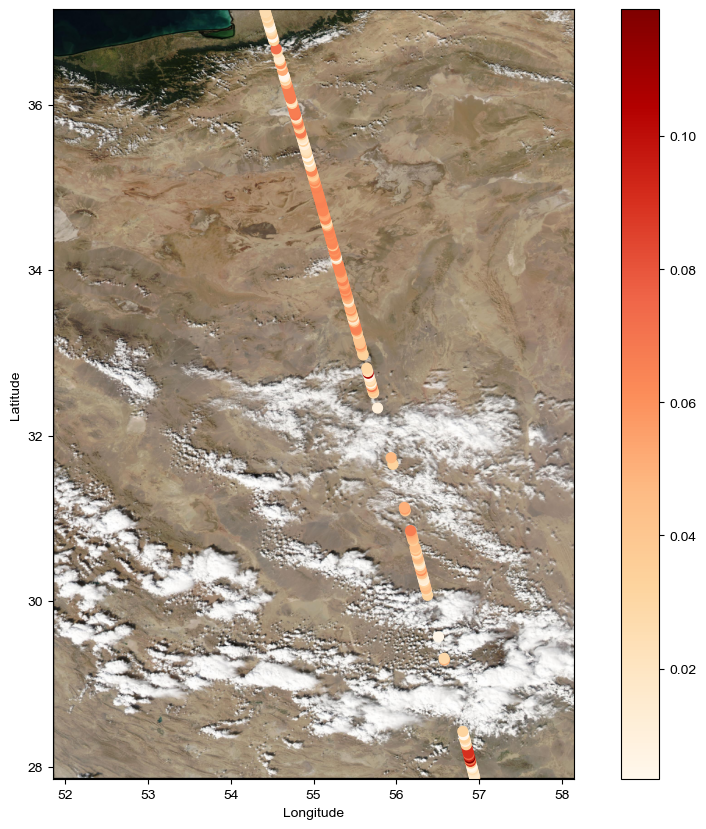

In [426]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
i = 0
c = frame.scatter(qf_lon[:, i], qf_lat[:, i], s=50, cmap='OrRd',
              marker='o', c=FWHM_array[:, i],)# vmin=0.041, vmax=0.044)


f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()


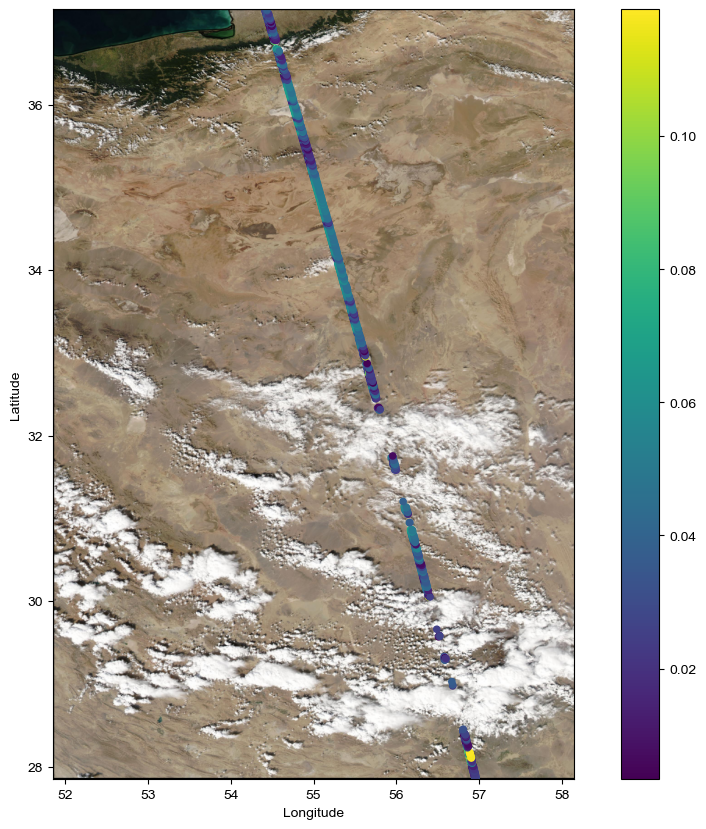

In [427]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=FWHM_array.flatten()[qf_01])

f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

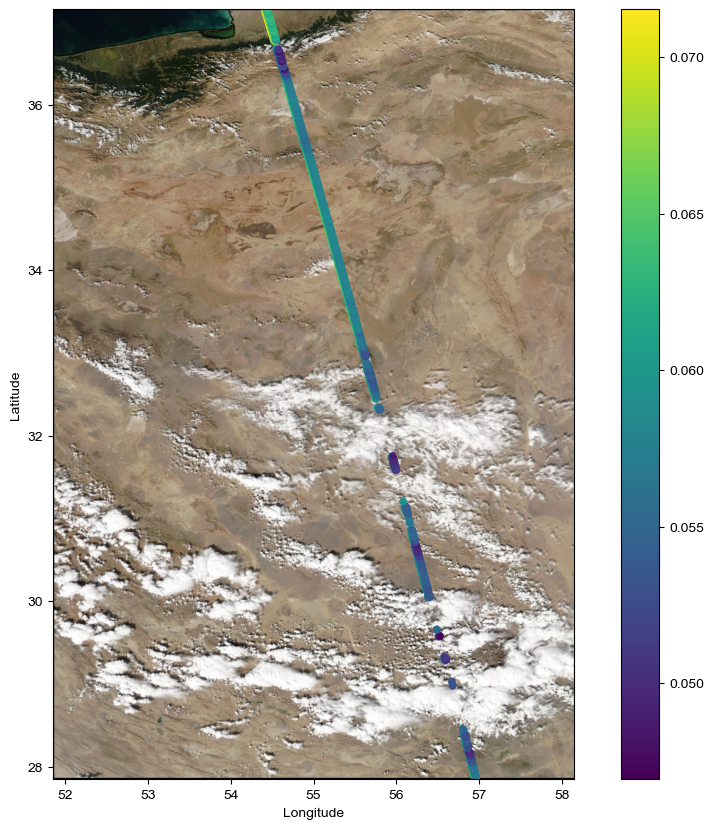

In [284]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=(FWHM_array*sfc_p/101325*(296/sfc_T)).flatten()[qf_01])

f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [289]:
np.isnan(qf_lon[:, fp]).sum()

8064

In [291]:
np.isnan(snd_lon[:, fp]).sum()

0

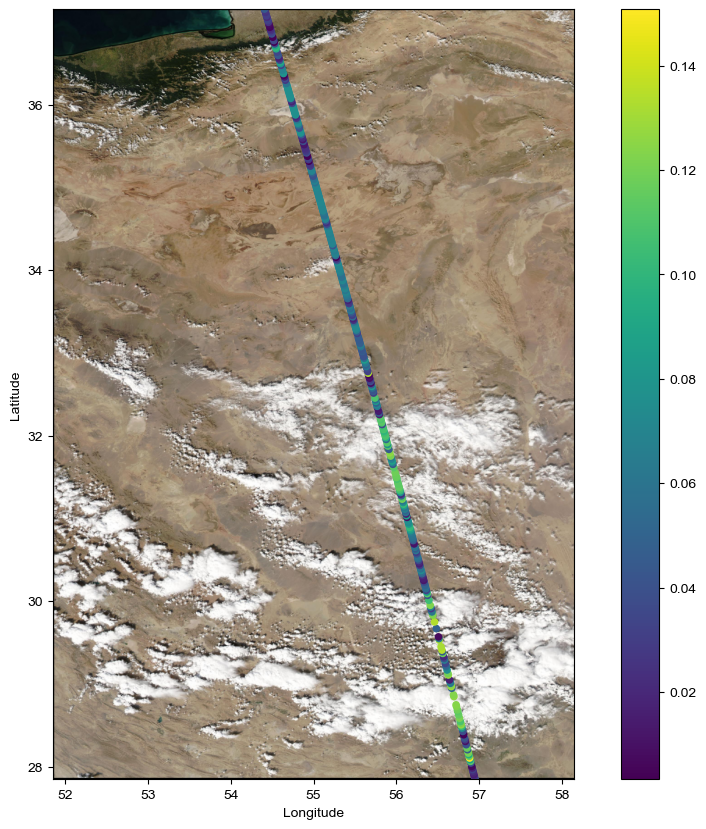

In [428]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
fp = 0
qf_01 = np.logical_or(qf_array[:, fp, 0].flatten()==0, qf_array[:, fp, 0].flatten()==1)
c = frame.scatter(snd_lon[:, fp].flatten(), snd_lat[:, fp].flatten(), s=20,
              marker='o', c=(FWHM_array/(sfc_p/101325*(296/sfc_T)**0.5))[:, fp].flatten(),
                 #vmin=0.0295, vmax=0.031
                 )

f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

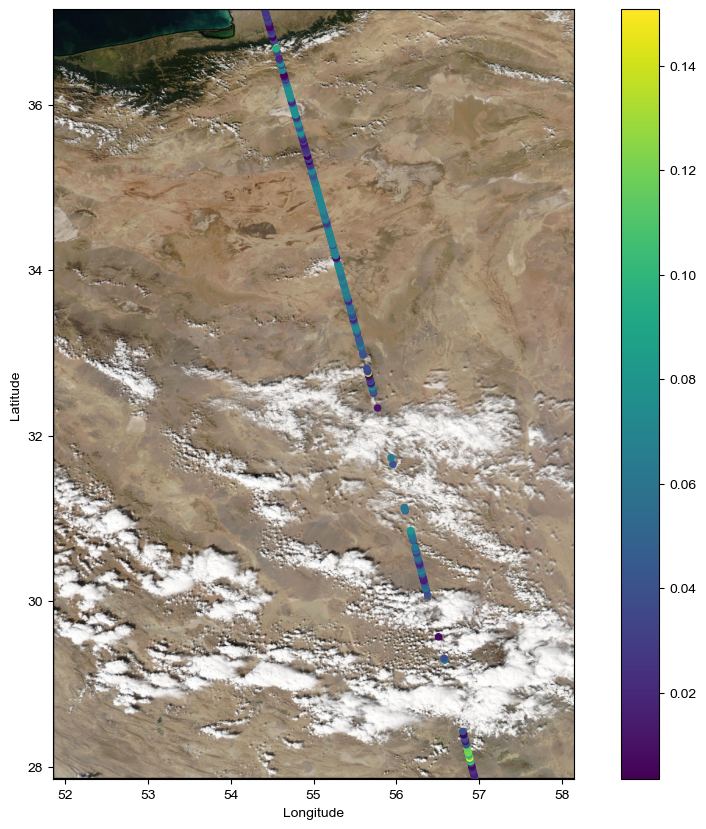

In [429]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
fp = 0
qf_01 = np.logical_or(qf_array[:, fp, 0].flatten()==0, qf_array[:, fp, 0].flatten()==1)
c = frame.scatter(qf_lon[:, fp].flatten()[qf_01], qf_lat[:, fp].flatten()[qf_01], s=20,
              marker='o', c=(FWHM_array/(sfc_p/101325*(296/sfc_T)**0.5))[:, fp].flatten()[qf_01],
                 #vmin=0.0295, vmax=0.031
                 )

f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

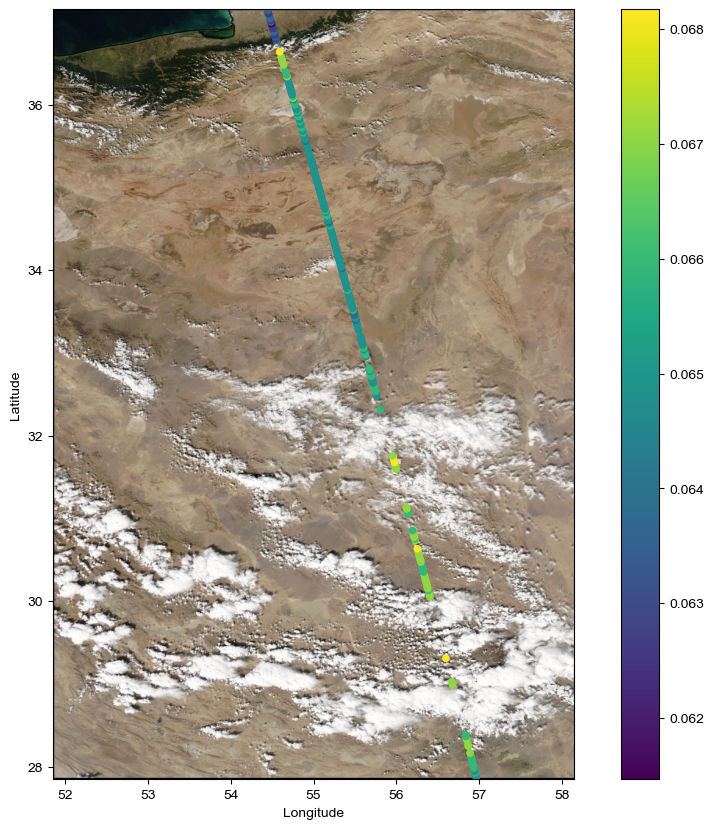

In [285]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
fp = 7
qf_01 = np.logical_or(qf_array[:, fp, 0].flatten()==0, qf_array[:, fp, 0].flatten()==1)
c = frame.scatter(qf_lon[:, fp].flatten()[qf_01], qf_lat[:, fp].flatten()[qf_01], s=20,
              marker='o', c=FWHM_array[:, fp].flatten()[qf_01])

f.colorbar(c)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

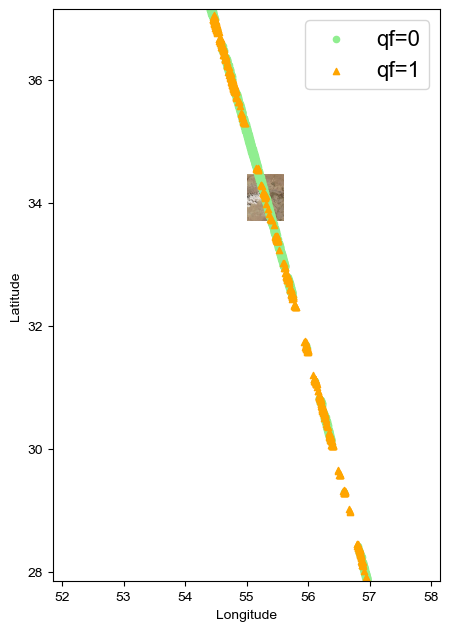

In [92]:
f,frame=plt.subplots(figsize=(5, 20))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==0], qf_lat.flatten()[qf_array[:, :, 0].flatten()==0], s=20,
              marker='o', color='lightgreen', label='qf=0')
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==1], qf_lat.flatten()[qf_array[:, :, 0].flatten()==1], s=20,
              marker='^', color='orange', label='qf=1')

#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

Text(0, 0.5, 'Transmittance')

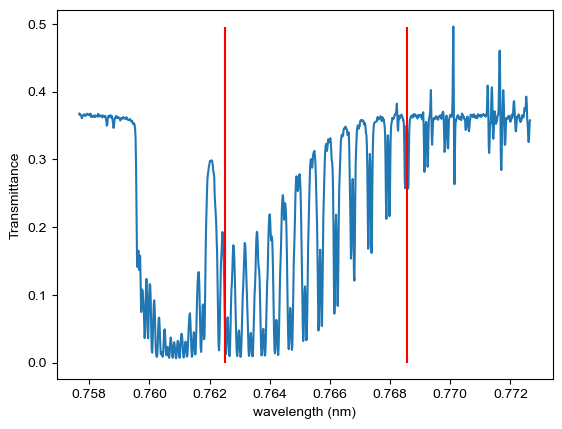

In [93]:
start, end = 290, 700
plt.plot(wl[0], T[0,0])
plt.vlines(wl[0, [start, end]], 0, np.max(T[0,0]), 'r')
plt.xlabel('wavelength (nm)')
plt.ylabel('Transmittance')
#plt.xlim(0.762, 0.765)

Text(0, 0.5, 'Absorbance')

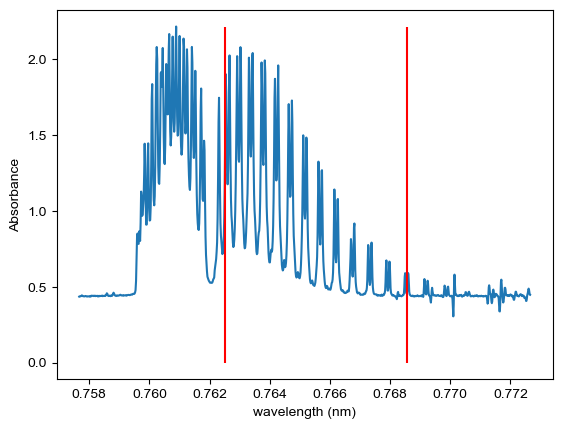

In [94]:
start, end = 290, 700
plt.plot(wl[0], A[0,0])
plt.vlines(wl[0, [start, end]], 0, np.max(A[0,0]), 'r')
plt.xlabel('wavelength (nm)')
plt.ylabel('Absorbance')
#plt.xlim(0.762, 0.765)

In [124]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
from scipy.special import wofz

def Voigt(x, x0, y0, a, sigma, gamma):
    #sigma = alpha / np.sqrt(2 * np.log(2))

    return y0 + a * np.real(wofz((x - x0 + 1j*gamma)/sigma/np.sqrt(2))) / sigma /np.sqrt(2*np.pi)




In [125]:
x = wl[0, start:end], 
y = tau[0,0,start:end]

sigma = 2.4
gamma = 2.4
popt, pcov = curve_fit(Voigt, x, y,)# p0=[8, np.max(y), -(np.max(y)-np.min(y)), sigma, gamma])

NameError: name 'tau' is not defined

In [256]:
start, end = 285, 700
local_min_bottom = []
local_min_up = []
local_min = []
local_max = []
search_interval = 5
for i in range(search_interval, len(A[0,0,start:end])-search_interval):
    if np.argmin(A[0,0,start+i-search_interval:start+i+search_interval+1]) == search_interval:
        local_min.append(start+i)
    if np.argmax(A[0,0,start+i-search_interval:start+i+search_interval+1]) == search_interval:
        local_max.append(start+i)


local_min_up = []
local_min_bottom = []
local_min_up.append(local_min[0])
for j in range(1, len(local_min)-1):
    if np.argmax(A[0,0,local_min[j-1:j+2]])==1:
        local_min_up.append(local_min[j])
    else:
        local_min_bottom.append(local_min[j])

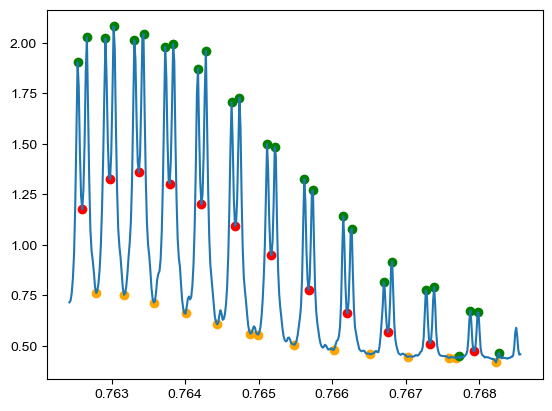

In [257]:

plt.plot(wl[0, start:end], A[0,0,start:end])
plt.scatter(wl[0, local_min_up], A[0,0,local_min_up], color='r')
plt.scatter(wl[0, local_min_bottom], A[0,0,local_min_bottom], color='orange')
plt.scatter(wl[0, local_max], A[0,0,local_max], color='g')
#plt.xlim(0.762, 0.765)

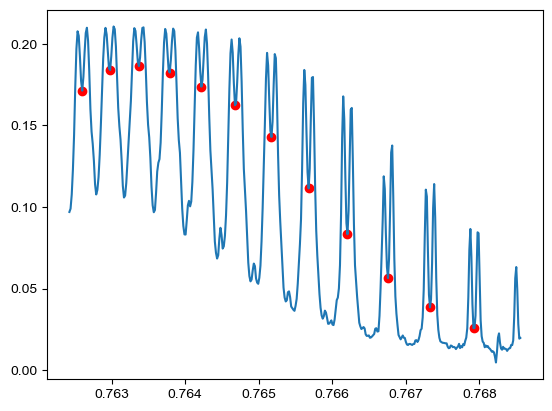

In [128]:

plt.plot(wl[0, start:end], A[0,0,start:end])
plt.scatter(wl[0, local_min_up], A[0,0,local_min_up], color='r')
#plt.scatter(wl[0, local_min_bottom], A[0,0,local_min_bottom], color='g')
#plt.xlim(0.762, 0.765)

In [129]:
def func2(x, a, b, c, d):
    return a * (np.exp(-(x-d)**2/(2*b**2))) +c

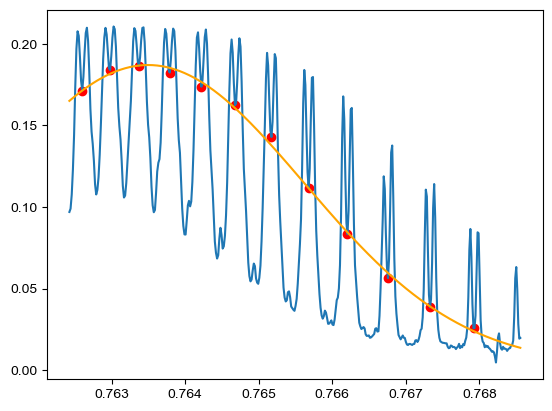

In [130]:
popt, pcov = curve_fit(func2, wl[0, local_min_up], A[0,0,local_min_up],
                      bounds=((1e-3, 1e-5, 0.0, 0.762), (2.0, 1, 2, 0.764)))
plt.plot(wl[0, start:end], A[0,0,start:end])
plt.scatter(wl[0, local_min_up], A[0,0,local_min_up], color='r')
plt.plot(wl[0, start:end], func2(wl[0, start:end], *popt), color='orange')
plt.show()

In [59]:
popt

array([0.85817757, 0.0015563 , 0.47231206, 0.7634467 ])

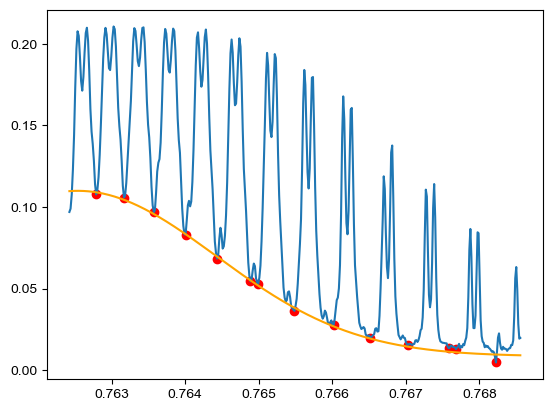

In [131]:

popt, pcov = curve_fit(func2, wl[0, local_min_bottom], A[0,0,local_min_bottom],
                      bounds=((1e-3, 1e-5, 0.0, 0.762), (2.0, 1, 2, 0.764)))
plt.plot(wl[0, start:end], A[0,0,start:end])
plt.scatter(wl[0, local_min_bottom], A[0,0,local_min_bottom], color='r')
plt.plot(wl[0, start:end], func2(wl[0, start:end], *popt), color='orange')
#plt.plot(wl[0, start:end], func2(wl[0, start:end], popt[0]+0.1, *popt[1:]), color='g')
plt.show()

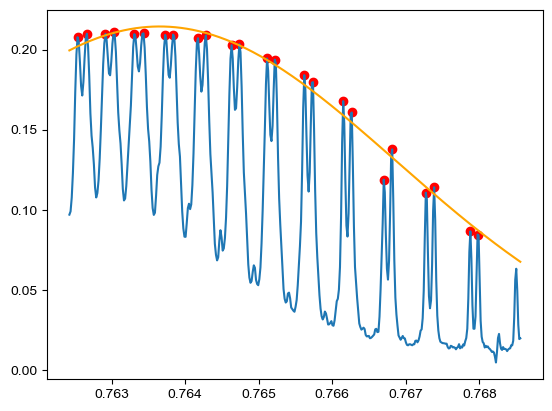

array([2.14418089e-01, 3.22709704e-03, 3.53903909e-18, 7.63651033e-01])

In [132]:
max_index = np.argsort(A[0,0,local_max])[2:]
popt, pcov = curve_fit(func2, wl[0, np.array(local_max)[max_index]], A[0,0,np.array(local_max)[max_index]],
                          p0=[0.6, 0.00366845,  0.61514387, 0.763],
                      bounds=((1e-3, 1e-5, 0.0, 0.762), (2.0, 1, 2, 0.764)))
plt.plot(wl[0, start:end], A[0,0,start:end])

plt.scatter(wl[0, np.array(local_max)[max_index]], A[0,0,np.array(local_max)[max_index]], color='r')
plt.plot(wl[0, start:end], func2(wl[0, start:end], *popt), color='orange')
plt.show()
popt

In [258]:
local_min_bottom_array = np.zeros((A.shape[0], A.shape[1], 4))
local_min_up_array = np.zeros((A.shape[0], A.shape[1], 4))
local_max_array = np.zeros((A.shape[0], A.shape[1], 4))
local_min_bottom_array[...] = np.nan
local_min_up_array[...] = np.nan
local_max_array[...] = np.nan

start, end = 285, 700+1
search_interval = 5

for i in range(A.shape[0]):
    for fp in range(8):
        if qf_array[i, fp, 0] >= 0:

            local_min = []
            local_max = []
            
            for ii in range(search_interval, len(A[i, fp,start:end])-search_interval):
                if np.argmin(A[i, fp,start+ii-search_interval:start+ii+search_interval+1]) == search_interval:
                    local_min.append(start+ii)
                if np.argmax(A[i, fp,start+ii-search_interval:start+ii+search_interval+1]) == search_interval:
                    local_max.append(start+ii)
            local_min_up = []
            local_min_bottom = []
            local_min_up.append(local_min[0])
            for j in range(1, len(local_min)-1):
                if np.argmax(A[i, fp,local_min[j-1:j+2]])==1:
                    local_min_up.append(local_min[j])
                else:
                    local_min_bottom.append(local_min[j])
            popt_up, pcov = curve_fit(func2, wl[fp, local_min_up], A[i, fp,local_min_up],
                                      bounds=((1e-3, 1e-5, 0.0, 0.762), (2.0, 1, 2, 0.764)))
            popt_bottom, pcov = curve_fit(func2, wl[fp, local_min_bottom], A[i, fp,local_min_bottom],
                                       bounds=((1e-3, 1e-5, 0.0, 0.762), (2.0, 1, 2, 0.764)))
            max_index = np.argsort(A[i, fp,local_max])[2:]

            popt_max, pcov = curve_fit(func2, wl[fp, np.array(local_max)[max_index]], A[i, fp,np.array(local_max)[max_index]],
                                       bounds=((1e-3, 1e-5, 0.0, 0.762), (3.0, 1, 2, 0.764)))

            local_min_up_array[i, fp, :] = popt_up[:]
            local_min_bottom_array[i, fp, :] = popt_bottom[:]
            local_max_array[i, fp, :] = popt_max[:]
            


In [134]:
(~np.isnan(local_min_up_array.flatten())).sum()

8944

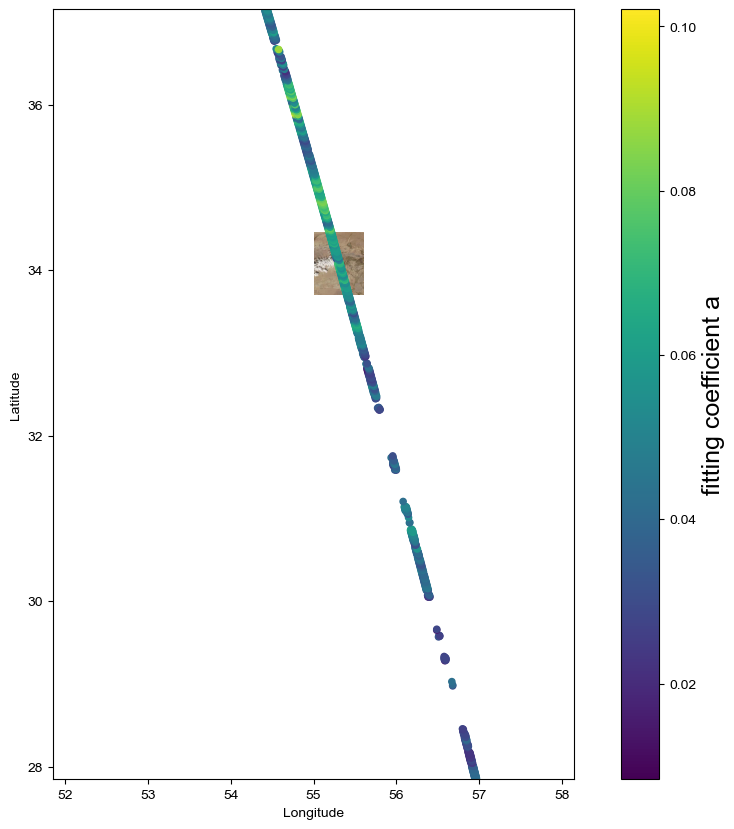

In [135]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=local_min_up_array[:,:,0].flatten()[qf_01])

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

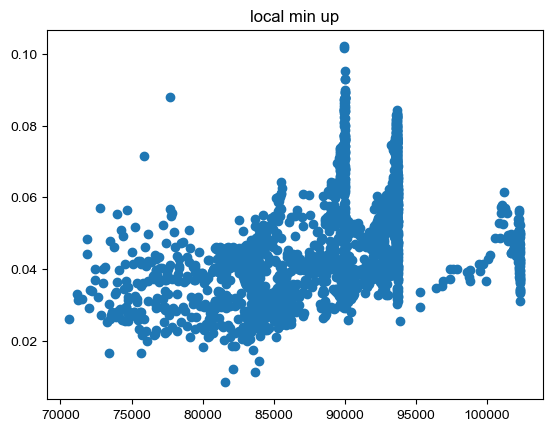

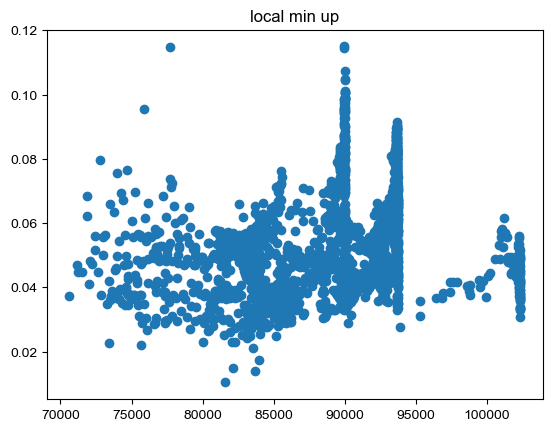

7.310421707092111e-07 -0.010239611468592869


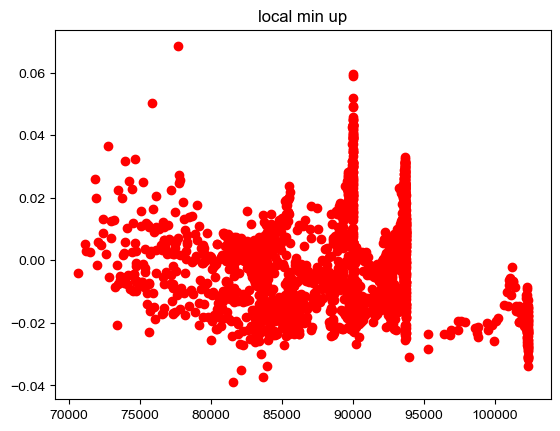

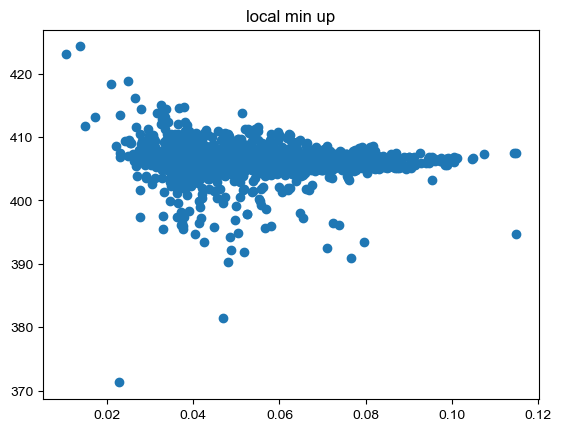

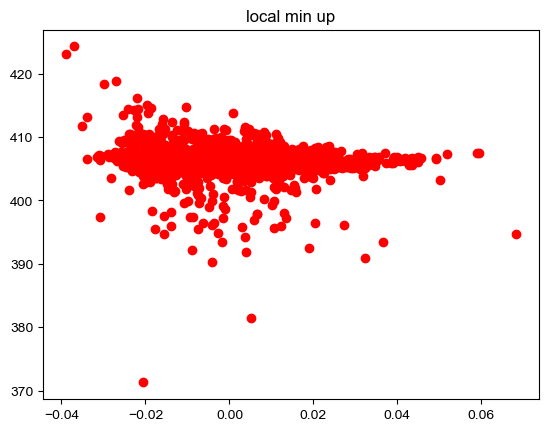

In [136]:
from scipy import stats
#*sfc_p/101325*(296/sfc_T)
para = 0

plt.scatter(sfc_p[:,:], local_min_up_array[:,:,para])
plt.title('local min up')
plt.show()
x = sfc_p[:,:].flatten()
y = (local_min_up_array[:,:,para]/(sfc_p/101325)).flatten()
mask = ~ np.logical_or(np.isnan(x), np.isnan(y))
slope, intercept, r, p, se = stats.linregress(x[mask], y[mask])
plt.scatter(sfc_p[:,:], local_min_up_array[:,:,para]/(sfc_p/101325), )
plt.title('local min up')
plt.show()

yy = sfc_p[:,:]*slope+intercept
print(slope, intercept)
#plt.scatter(sfc_p[:,:], yy, color='b')
plt.scatter(sfc_p[:,:], (local_min_up_array[:,:,para]/(sfc_p/101325)-yy), color='r')
plt.title('local min up')
plt.show()

plt.scatter(local_min_up_array[:,:,para]/(sfc_p/101325), xco2_array[:,:])
plt.title('local min up')
plt.show()

res = (local_min_up_array[:,:,para]/(sfc_p/101325)-yy)
plt.scatter(res, xco2_array[:,:], color='r')
plt.title('local min up')
plt.show()

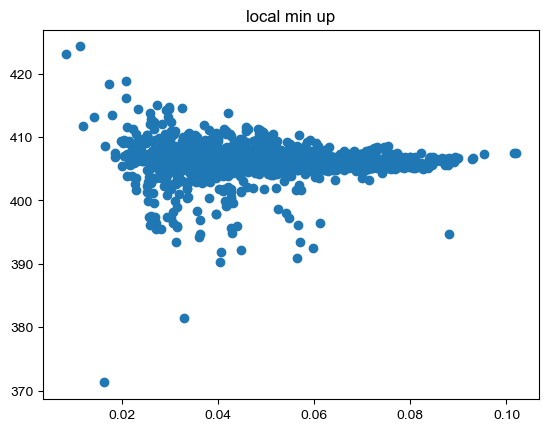

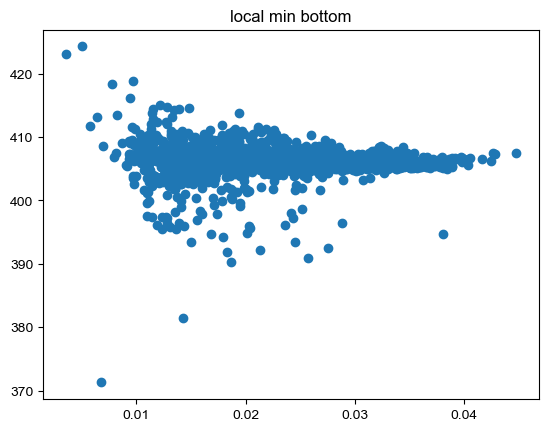

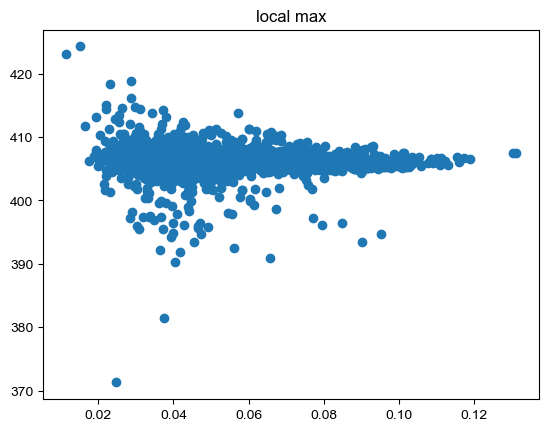

In [137]:
para = 0
plt.scatter(local_min_up_array[:,:,para], xco2_array[:,:])
plt.title('local min up')
plt.show()
plt.scatter(local_min_bottom_array[:,:,para], xco2_array[:,:])
plt.title('local min bottom')
plt.show()
plt.scatter(local_max_array[:,:,para], xco2_array[:,:])
plt.title('local max')
plt.show()

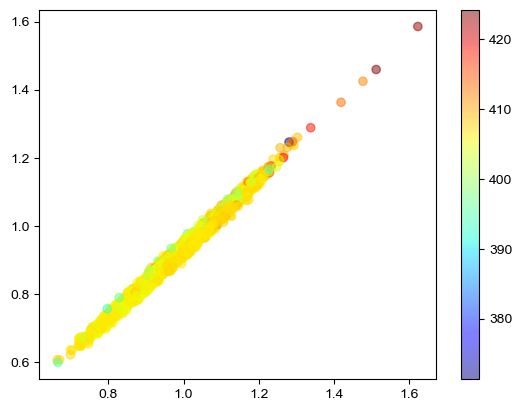

In [267]:
para = 2
plt.scatter(local_min_up_array[:,:,para], local_min_bottom_array[:,:,para], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

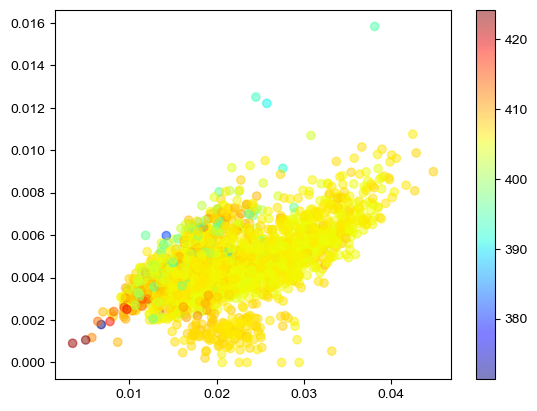

In [172]:
para = 0
plt.scatter(local_min_bottom_array[:,:,0], local_min_up_array[:,:,2], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

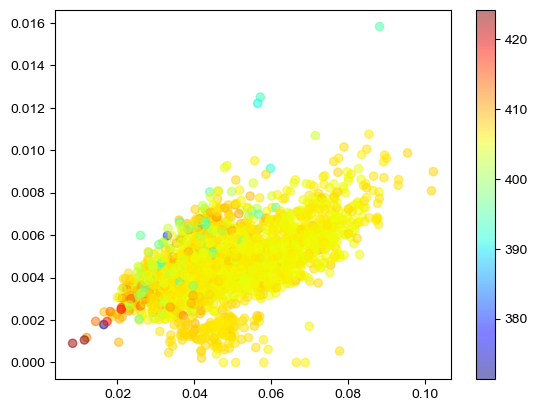

In [158]:
para = 0
plt.scatter(local_min_up_array[:,:,0], local_min_up_array[:,:,2], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

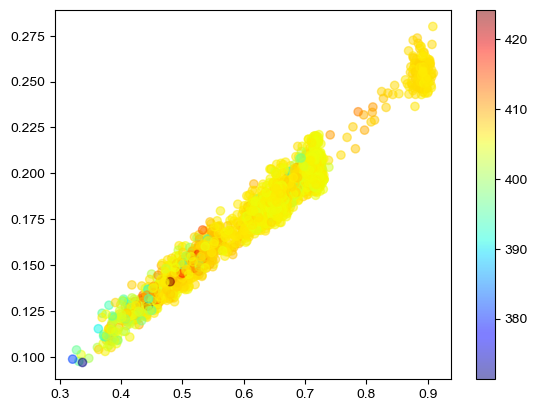

In [262]:
para = 0
plt.scatter(local_min_up_array[:,:,0]*(sfc_p/101325), local_min_bottom_array[:,:,0]*(sfc_p/101325), c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

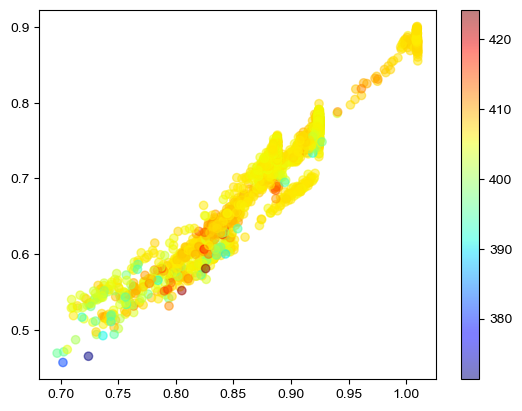

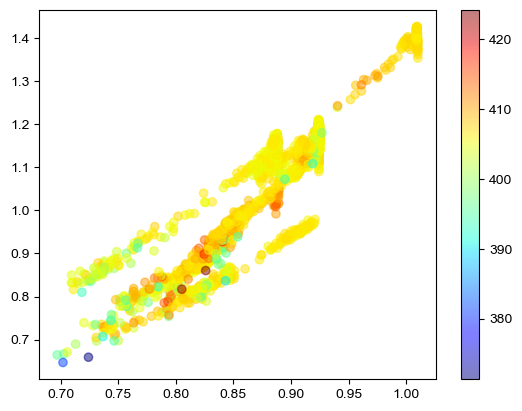

In [276]:
para = 0
plt.scatter((sfc_p/101325), local_min_up_array[:,:,0], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

plt.scatter((sfc_p/101325), (local_min_up_array[:,:,0]/o2a_mu), c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

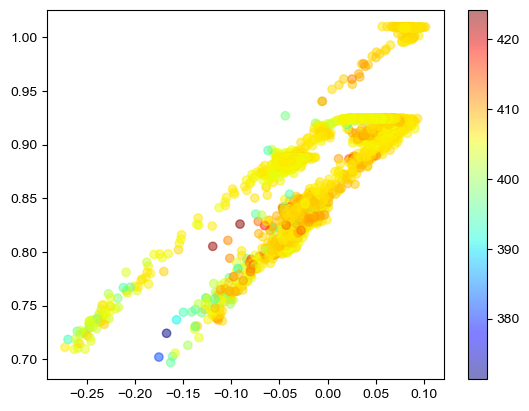

In [281]:
from scipy import signal
mask = ~np.isnan(local_min_up_array[:,:,0])
test = signal.detrend((local_min_up_array[:,:,0])[mask])
plt.scatter(test, (sfc_p/101325)[mask], c=xco2_array[:,:][mask], alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

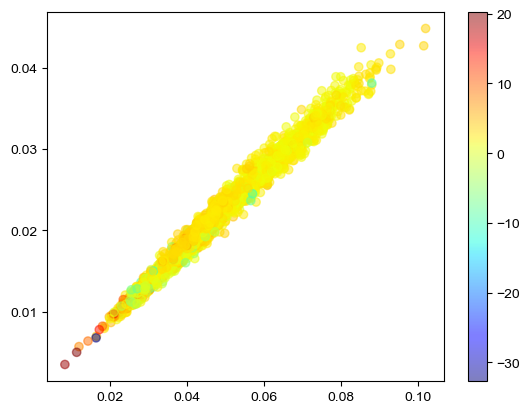

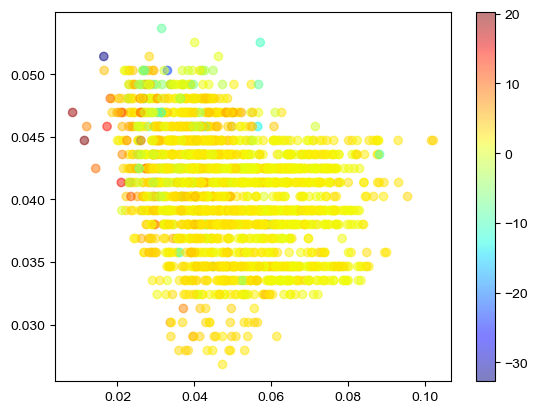

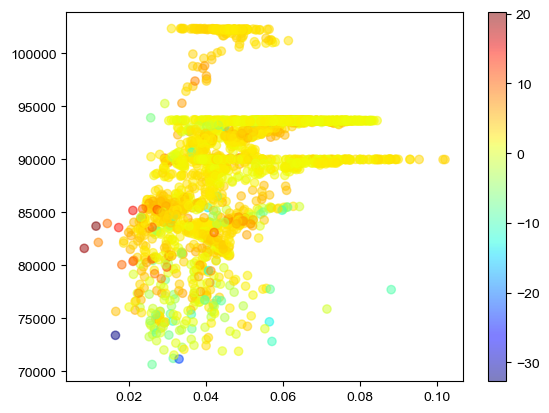

In [223]:
para = 0
select = np.logical_and(np.logical_and(snd_lon>=wesn[0], snd_lon<=wesn[1]),
                        np.logical_and(snd_lat>=wesn[2], snd_lat<=wesn[3]))
plt.scatter((local_min_up_array[:,:,0])[select], (local_min_bottom_array[:,:,0])[select], c=xco2_array[:,:][select]-404, alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

plt.scatter((local_min_up_array[:,:,0])[select], (FWHM_array[:,:])[select], c=xco2_array[:,:][select]-404, alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

plt.scatter((local_min_up_array[:,:,0])[select], sfc_p[select], c=xco2_array[:,:][select]-404, alpha=0.5,cmap='jet')
plt.colorbar()
plt.show()

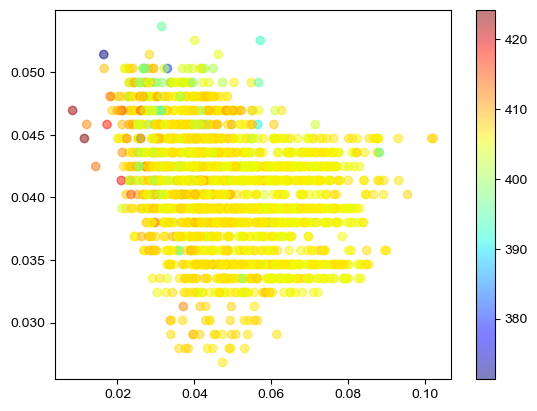

In [181]:
para = 0
plt.scatter(local_min_up_array[:,:,0], FWHM_array, c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

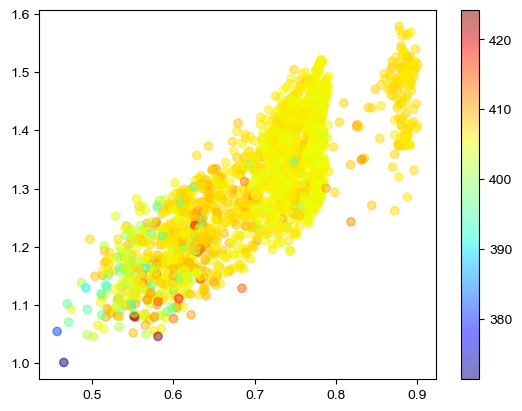

In [113]:
plt.scatter(local_min_up_array[:,:,para], local_max_array[:,:,para], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

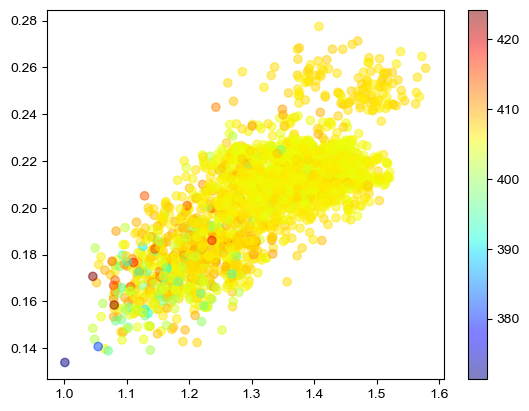

In [114]:
plt.scatter(local_max_array[:,:,para], local_min_bottom_array[:,:,para], c=xco2_array[:,:], alpha=0.5,cmap='jet')
plt.colorbar()

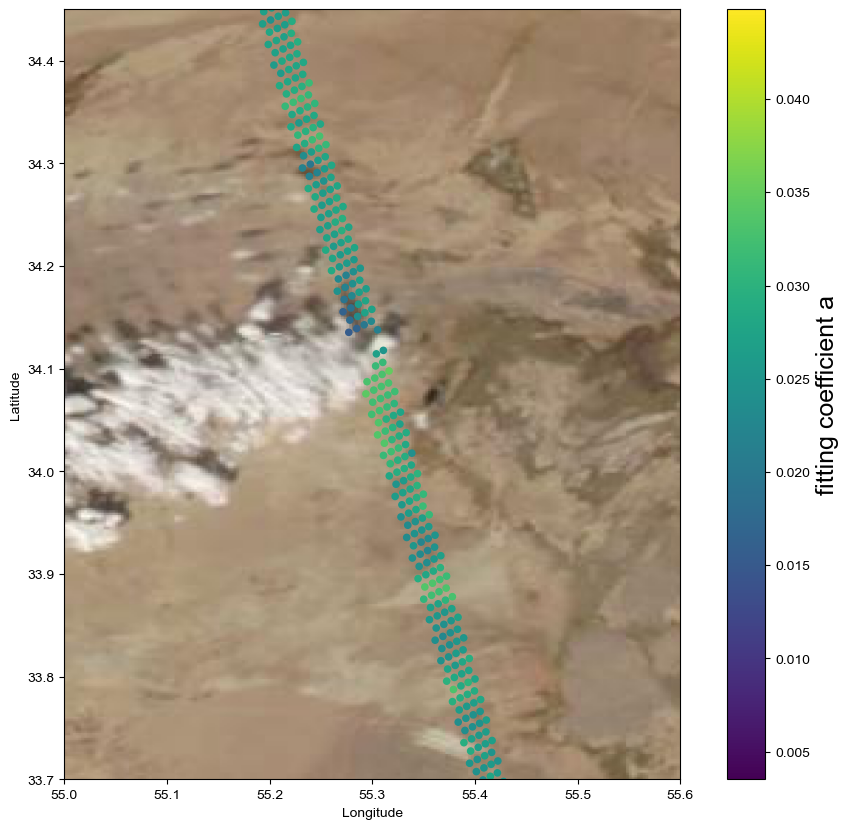

In [208]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=local_min_bottom_array[:,:,0].flatten()[qf_01])

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

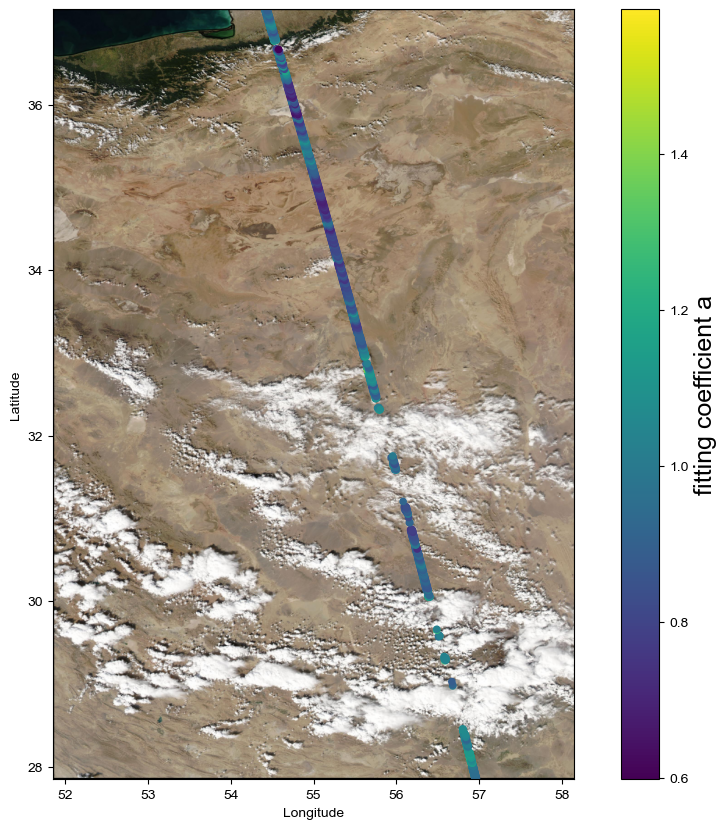

In [270]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=local_min_bottom_array[:,:,2].flatten()[qf_01])

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

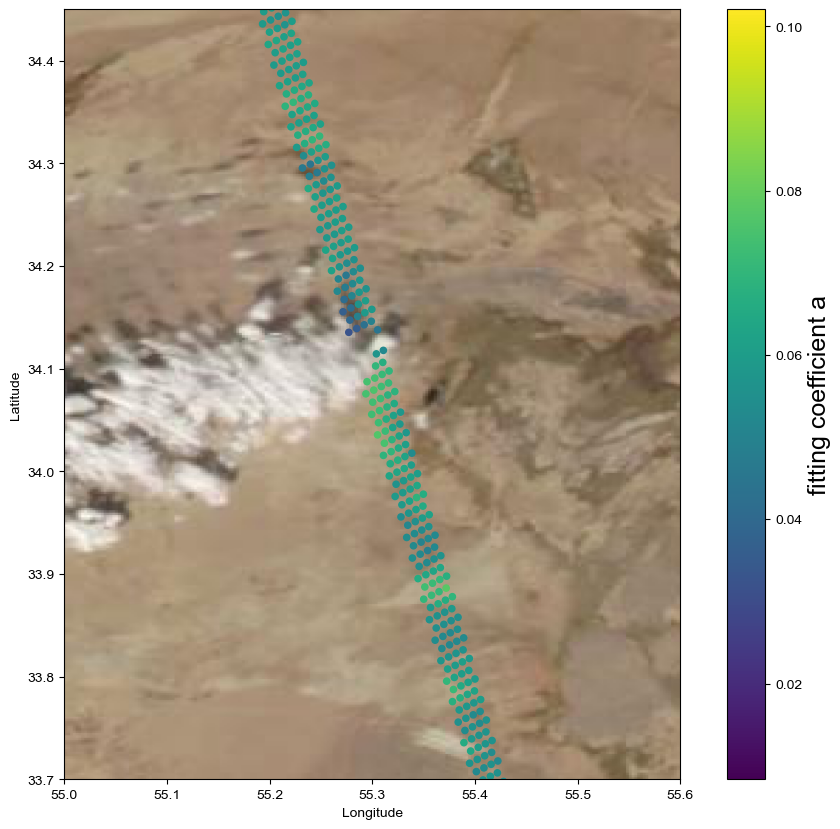

In [209]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
lon_dom = [wesn[0], wesn[1]]
lat_dom = [wesn[2], wesn[3]]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=local_min_up_array[:,:,0].flatten()[qf_01])

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [220]:
png       = ['../simulation/data/20181018_central_asia_2_470cloud_test0320_20181018/aqua_rgb_2018-10-18_51.85-58.15-27.85-37.15.png',
             [51.85,58.15,27.85,37.15]]
img = png[0]
wesn= png[1]

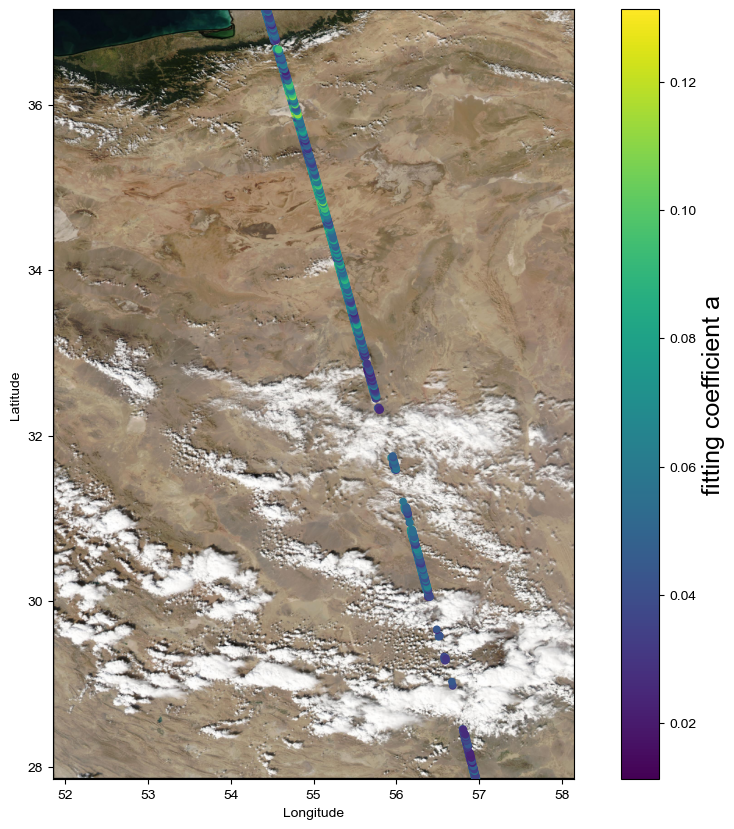

In [221]:
f,frame=plt.subplots(figsize=(12, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
qf_01 = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
c = frame.scatter(qf_lon.flatten()[qf_01], qf_lat.flatten()[qf_01], s=20,
              marker='o', c=local_max_array[:,:,0].flatten()[qf_01])

cbar = f.colorbar(c)
cbar.set_label('fitting coefficient a', fontsize=18)
#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()